# Model 3 aggregation feature importances using SHAP values

In [1]:
import numpy as np
import pandas as pd
import glob
from pathlib import Path

import matplotlib.pyplot as plt

%matplotlib inline
import seaborn as sns

import genetools

from malid.datamodels import GeneLocus, TargetObsColumnEnum
from malid import config, io
from malid.trained_model_wrappers import (
    VJGeneSpecificSequenceModelRollupClassifier,
    VGeneIsotypeSpecificSequenceClassifier,
    SequenceClassifier,
)
from malid.train.vj_gene_specific_sequence_model_rollup_classifier_as_binary_ovr import (
    BinaryOvRClassifierWithFeatureSubsettingByClass,
)
import crosseval, genetools.plots
from wrap_glmnet import GlmnetLogitNetWrapper
from sklearn.linear_model import LogisticRegression
from malid import helpers
import sklearn.utils.class_weight
from slugify import slugify
import shap
from IPython.display import display, Markdown
import joblib
from summarynb import show, chunks
import scanpy as sc
import anndata

In [2]:
# Rather than combining across folds (difficult), just use global fold model
fold_id = -1

In [3]:
target_obs_column = TargetObsColumnEnum.disease
sample_weight_strategy = config.sample_weight_strategy

In [4]:
def tree_shap_on_one_ovr_model(
    transformed_X_train,
    fd_train,
    positive_class,
    positive_class_clf,
):
    """
    Returns:
    - raw SHAP values matrix
    - two dataframes: rows are V genes, columns are isotypes, values are average SHAP values or average feature values

    This is done for one positive class only.
    """
    transformed_X_train_subset = transformed_X_train[
        positive_class_clf.feature_names_in_
    ]

    if isinstance(positive_class_clf, GlmnetLogitNetWrapper) or isinstance(
        positive_class_clf, LogisticRegression
    ):
        # Linear models
        is_linear_model = True
        explainer = shap.LinearExplainer(
            (positive_class_clf.coef_, positive_class_clf.intercept_),
            transformed_X_train_subset,
        )
    else:
        # Tree models
        is_linear_model = False
        explainer = shap.TreeExplainer(positive_class_clf)
    shap_values_train = explainer.shap_values(X=transformed_X_train_subset)

    # We are interested in the SHAP values for the positive class (class 1 for random forest, class 0 for linear model)
    # Note that we will not take the absolute value here, as we care about the direction.
    # (Random forest feature importances may be negatively associated, as would be absolute value of SHAP values)
    shap_values_train = shap_values_train[0 if is_linear_model else 1]

    # Take average over positive examples:
    # What features are positively associated with the positive class?
    # Look at SHAP values averaged over just positive class instances!
    average_feature_importances = shap_values_train[fd_train.y == positive_class].mean(
        axis=0
    )
    # Also record raw feature values
    average_feature_values = transformed_X_train_subset.loc[
        fd_train.y == positive_class
    ].mean(axis=0)

    average_feature_importances = pd.Series(
        average_feature_importances, index=transformed_X_train_subset.columns
    )
    average_feature_values = pd.Series(
        average_feature_values, index=transformed_X_train_subset.columns
    )

    # Extract V gene and isotype information
    # Resulting columns: shap, class_name, v_gene, isotype_supergroup
    concatenated_averages_df = pd.concat(
        [
            average_feature_importances.rename("shap"),
            average_feature_values.rename("average_feature_value"),
            average_feature_importances.index.to_series()
            .map(fd_train.extras["column_map"])
            .apply(pd.Series),
        ],
        axis=1,
    )

    # Rename v_gene
    concatenated_averages_df["v_gene"] = concatenated_averages_df["v_gene"].replace(
        helpers.v_gene_friendly_names
    )

    if (concatenated_averages_df["class_name"] != positive_class).any():
        raise ValueError("Wrong feature importances df")

    # Pivot so rows are V genes, columns are isotypes.
    shap_average_feature_importances_df = concatenated_averages_df.pivot(
        index="v_gene", columns="isotype_supergroup", values="shap"
    )
    average_feature_values_df = concatenated_averages_df.pivot(
        index="v_gene", columns="isotype_supergroup", values="average_feature_value"
    )
    return (
        # Raw SHAP values, an examples x features matrix:
        pd.DataFrame(
            shap_values_train,
            index=fd_train.sample_names,
            columns=transformed_X_train_subset.columns,
        ),
        # Average SHAP value per feature, pivoted to V gene by isotype matrix:
        shap_average_feature_importances_df,
        # Average raw feature value (having undergone any standardization inside the classifier pipeline), pivoted to V gene by isotype matrix:
        average_feature_values_df,
    )

In [5]:
def process(
    gene_locus: GeneLocus,
):
    adata_train = io.load_fold_embeddings(
        fold_id=fold_id,
        fold_label="train_smaller2",
        gene_locus=gene_locus,
        target_obs_column=target_obs_column,
    )
    clf_seq = config.metamodel_base_model_names.base_sequence_model_subset_strategy.base_model(
        fold_id=fold_id,
        model_name_sequence_disease=config.metamodel_base_model_names.base_sequence_model_name[
            gene_locus
        ],
        fold_label_train="train_smaller1",
        gene_locus=gene_locus,
        target_obs_column=target_obs_column,
        sample_weight_strategy=sample_weight_strategy,
    )
    clf_pipeline = VJGeneSpecificSequenceModelRollupClassifier(
        fold_id=fold_id,
        base_sequence_model_name=clf_seq.model_name_sequence_disease,
        rollup_model_name=config.metamodel_base_model_names.aggregation_sequence_model_name[
            gene_locus
        ],
        base_model_train_fold_label=clf_seq.fold_label_train,
        fold_label_train="train_smaller2",
        gene_locus=gene_locus,
        target_obs_column=target_obs_column,
        sample_weight_strategy=sample_weight_strategy,
        sequence_classifier=clf_seq,
    )

    # Construct a highres output directory specific to this model
    highres_output_base_dir = (
        config.paths.high_res_outputs_dir
        / "sequence_models"
        / SequenceClassifier._get_directory_suffix(
            gene_locus=gene_locus,
            target_obs_column=target_obs_column,
            sample_weight_strategy=sample_weight_strategy,
        )
        / clf_seq._get_directory_suffix()
        / VJGeneSpecificSequenceModelRollupClassifier._get_directory_suffix(
            base_sequence_model_name=clf_seq.model_name_sequence_disease,
            base_model_train_fold_label=clf_seq.fold_label_train,
            split_short_name=clf_seq.split_short_name,
        )
    )
    highres_output_base_dir.mkdir(parents=True, exist_ok=True)  # might not yet exist
    output_filename_prefix = f"{clf_pipeline.fold_label_train}_model"

    # SHAP is run for each X, so we need to:
    # - load and refeaturize data with the model
    # - run scaler etc. in the pipeline before final classifier.
    # - handle the splitting in the final OvR.

    fd_train = clf_pipeline.featurize(adata_train)
    transformed_X_train = clf_pipeline._inner[:-1].transform(fd_train.X)

    # it's probably a Pipeline - unwrap it
    clf = crosseval._get_final_estimator_if_pipeline(clf_pipeline._inner)

    # we only support BinaryOvRClassifierWithFeatureSubsettingByClass or OneVsNegativeClassifierWithFeatureSubsettingByClass
    if not isinstance(clf, BinaryOvRClassifierWithFeatureSubsettingByClass):
        raise ValueError(f"clf has unsupported type {type(clf)}")

    # Compute SHAP values for each positive class.
    # Note: no normalization of these values; they are not comparable across classes.
    raw_feature_importances_per_example_by_class = {}
    average_feature_importances_by_class = {}
    average_feature_values_by_class = {}
    for est in clf.estimators_:
        positive_class = est.positive_class
        (
            raw_shap_df,
            average_shap_df,
            average_feature_values_df,
        ) = tree_shap_on_one_ovr_model(
            transformed_X_train=transformed_X_train,
            fd_train=fd_train,
            positive_class=positive_class,
            positive_class_clf=est.clf,
        )

        # Store raw SHAP values (examples x features matrix) along with ground truth label and metadata for each example
        raw_feature_importances_per_example_by_class[est.positive_class] = (
            raw_shap_df,
            fd_train.y,
            fd_train.metadata,
            # Also include feature name map
            raw_shap_df.columns.to_series()
            .map(fd_train.extras["column_map"])
            .apply(pd.Series),
        )

        # Store averaged values
        average_feature_importances_by_class[est.positive_class] = average_shap_df
        average_feature_values_by_class[est.positive_class] = average_feature_values_df

    return (
        raw_feature_importances_per_example_by_class,
        average_feature_importances_by_class,
        average_feature_values_by_class,
        (clf_pipeline.output_base_dir, highres_output_base_dir, output_filename_prefix),
    )

In [6]:
raw_feature_importances_per_example_by_class_per_locus = {}
average_feature_importances_by_class_per_locus = {}
average_feature_values_by_class_per_locus = {}
fname_parts_per_locus = {}
for gene_locus in config.gene_loci_used:
    print(gene_locus)
    # Run, with averaging over positive examples only
    (
        raw_feature_importances_per_example_by_class,
        average_feature_importances_by_class,
        average_feature_values_by_class,
        fname_parts,
    ) = process(
        gene_locus,
    )
    raw_feature_importances_per_example_by_class_per_locus[
        gene_locus
    ] = raw_feature_importances_per_example_by_class
    average_feature_importances_by_class_per_locus[
        gene_locus
    ] = average_feature_importances_by_class
    average_feature_values_by_class_per_locus[
        gene_locus
    ] = average_feature_values_by_class
    fname_parts_per_locus[gene_locus] = fname_parts

{"message": "Caching network file to local machine cache: /users/maximz/code/boyd-immune-repertoire-classification/data/data_v_20231027/in_house_peak_disease_timepoints/embedded/esm2_cdr3/anndatas_scaled/BCR/fold.-1.train_smaller.h5ad -> /srv/scratch/maximz/cache/04aa8fc3c352ddda5b3718f9de47d9d1f0d166f6acf7fb06e8b98a7d.-1.train_smaller.h5ad", "time": "2024-08-10T02:39:30.348351"}


GeneLocus.BCR


Only considering the two last: ['.train_smaller', '.h5ad'].


Only considering the two last: ['.train_smaller', '.h5ad'].


{"message": "Number of VJGeneSpecificSequenceModelRollupClassifier featurization matrix N/As due to specimens not having any sequences with particular V/J gene pairs: 5880 / 98640 = 5.96%", "time": "2024-08-10T02:55:48.835451"}


{"message": "Caching network file to local machine cache: /users/maximz/code/boyd-immune-repertoire-classification/data/data_v_20231027/in_house_peak_disease_timepoints/embedded/esm2_cdr3/anndatas_scaled/TCR/fold.-1.train_smaller.h5ad -> /srv/scratch/maximz/cache/ea98c016296cd99aa544448c574efb2ed527d1ffb3c14b9e4841b14a.-1.train_smaller.h5ad", "time": "2024-08-10T02:56:05.417481"}


GeneLocus.TCR


Only considering the two last: ['.train_smaller', '.h5ad'].


Only considering the two last: ['.train_smaller', '.h5ad'].


{"message": "Number of VJGeneSpecificSequenceModelRollupClassifier featurization matrix N/As due to specimens not having any sequences with particular V/J gene pairs: 0 / 20496 = 0.00%", "time": "2024-08-10T03:11:43.957383"}


# GeneLocus.BCR

{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:11:51.009593"}


{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:11:52.108943"}


{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:11:52.992824"}


{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:11:53.875649"}


{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:11:54.908311"}


{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:11:55.787303"}


,,
,,
,,
,,


,,
,,


---

# GeneLocus.TCR

{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:11:57.325050"}


{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:11:58.230205"}


{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:11:58.927875"}


{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:11:59.632594"}


{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:12:00.339414"}


{"message": "'created' timestamp seems very low; regarding as unix timestamp", "time": "2024-08-10T03:12:01.064246"}


,,
,,
,,
,,


,,
,,


---

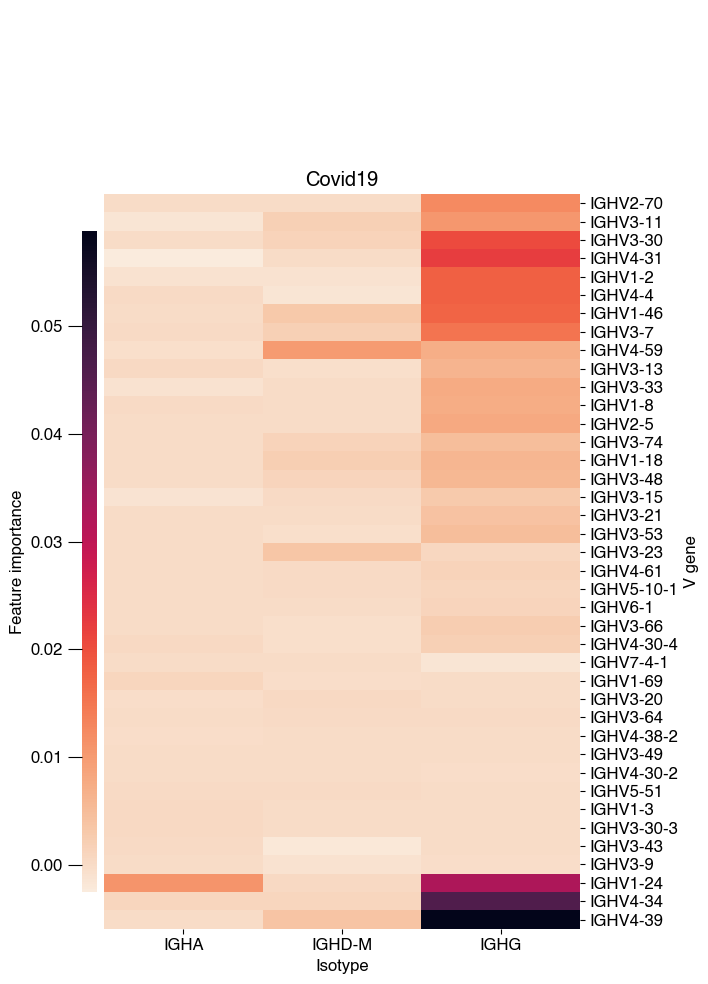

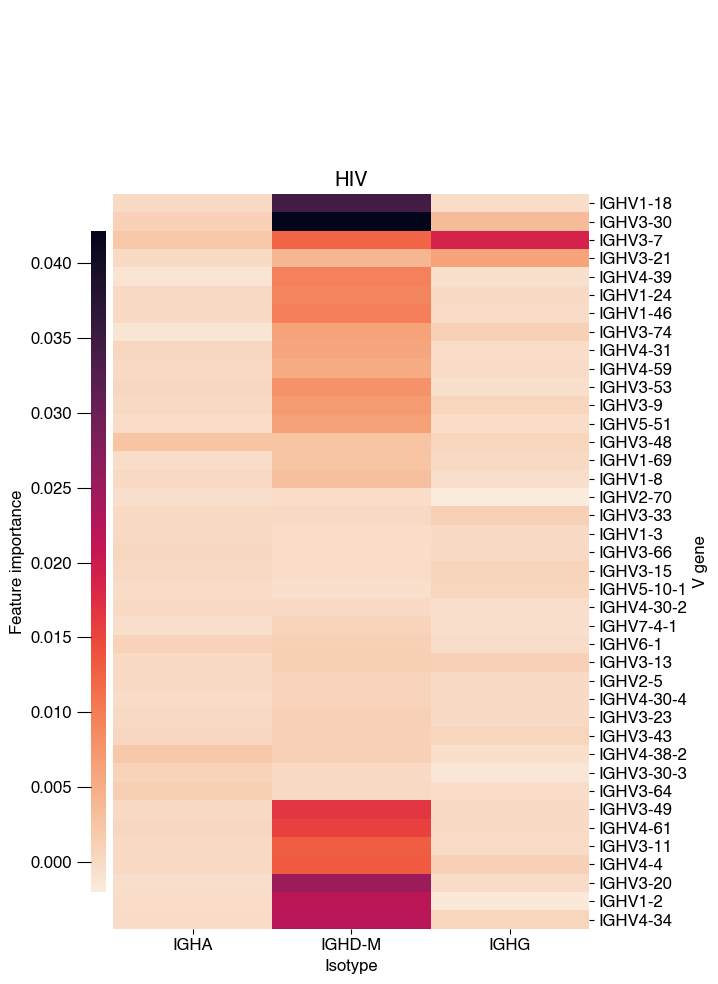

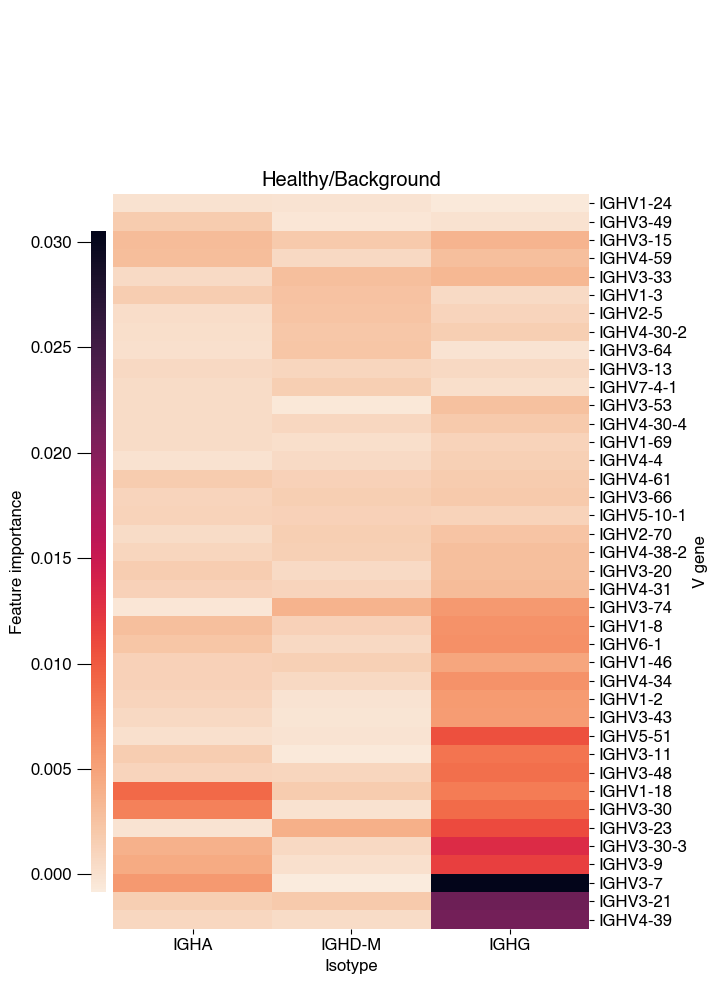

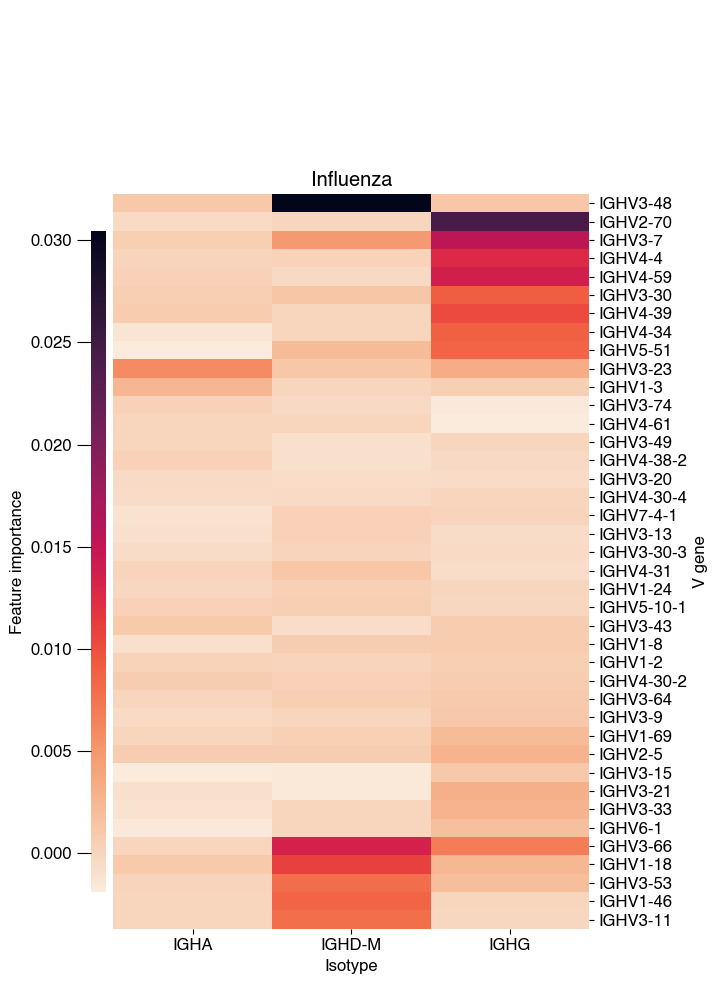

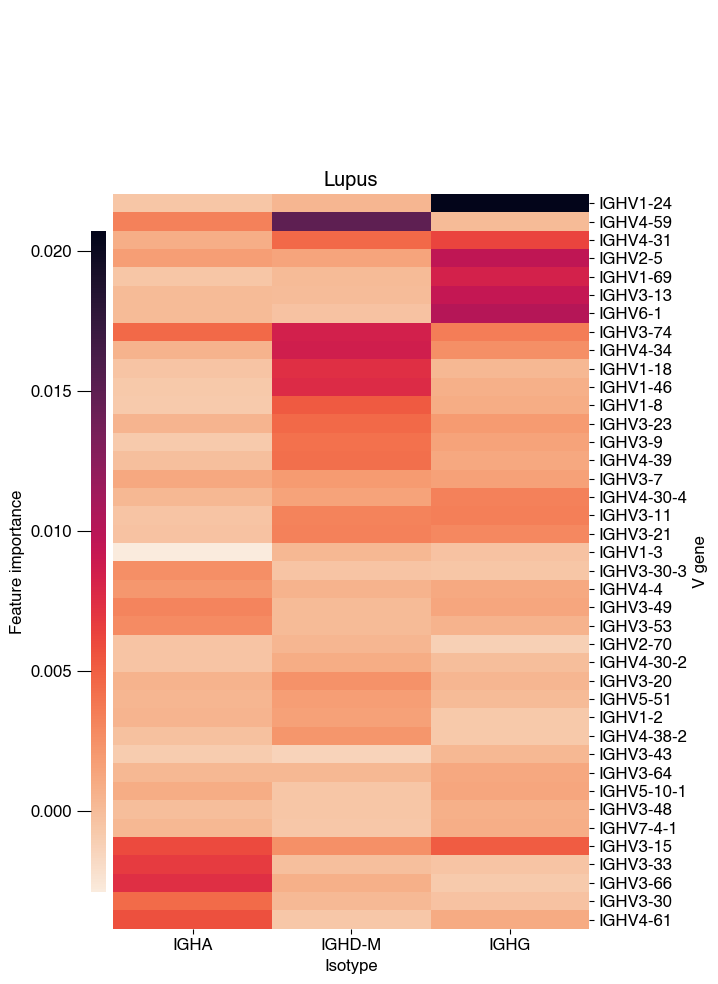

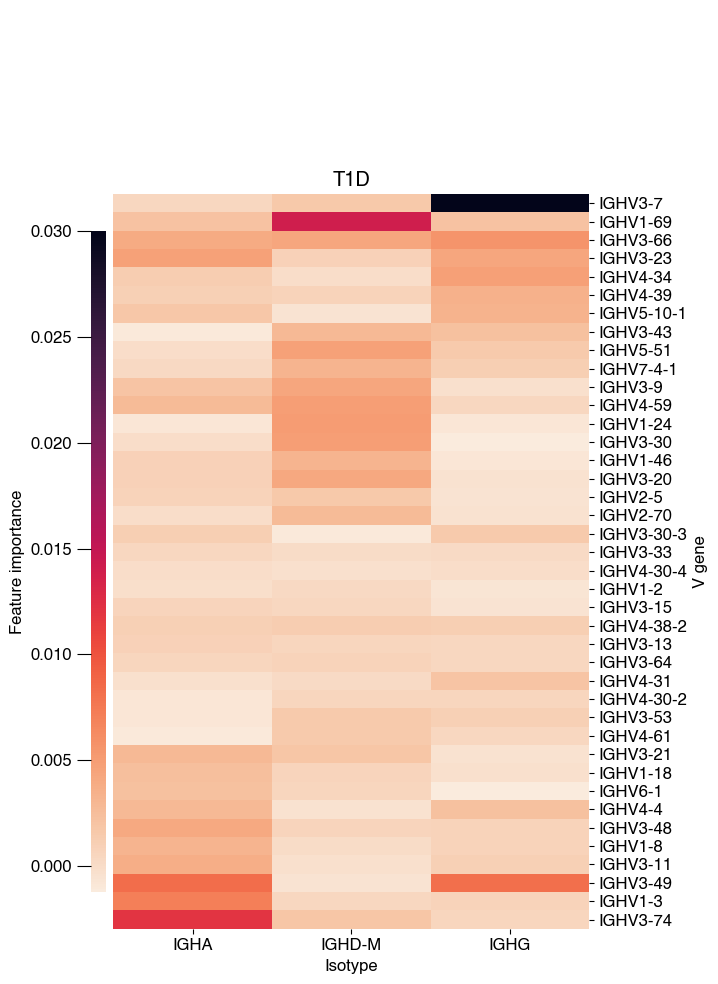

In [7]:
for gene_locus in config.gene_loci_used:
    display(Markdown(f"# {gene_locus}"))
    average_feature_importances_by_class = (
        average_feature_importances_by_class_per_locus[gene_locus]
    )
    average_feature_values_by_class = average_feature_values_by_class_per_locus[
        gene_locus
    ]
    (
        clf_pipeline_output_base_dir,
        highres_output_base_dir,
        output_filename_prefix,
    ) = fname_parts_per_locus[gene_locus]

    ### Main heatmap plot

    def _mkfname(positive_class: str, suffix: str) -> Path:
        return Path(
            f"{output_filename_prefix}.average_over_positives.{slugify(positive_class)}{suffix}"
        )

    fig_fnames = []

    def make_clustermap(data):
        g = sns.clustermap(
            data=data.rename_axis(
                index={"v_gene": "V gene"}, columns={"isotype_supergroup": "Isotype"}
            ),
            yticklabels=True,  # Make all V gene labels visible
            col_cluster=False,  # Reorder rows only
            figsize=(2.5 * data.shape[1], 10),
            cbar_kws={"label": "Feature importance"},
            cmap=sns.cm.rocket_r,  # A bit clearer than the default one
            center=None,  # Not a divergent color map
        )
        # TODO(later): edit the clustering object to put the all-black rows on top?

        g.ax_heatmap.set_title(positive_class)

        # Hide dendrogram
        g.ax_row_dendrogram.set_visible(False)

        # Use the (now hidden) dendrogram box to reposition the colorbar

        # https://stackoverflow.com/a/47352457/130164
        # https://stackoverflow.com/a/67911794/130164
        dendro_box = g.ax_row_dendrogram.get_position()

        # dendro_box.x0 = (dendro_box.x0 + 2 * dendro_box.x1) / 3
        # original_width = dendro_box.x1 - dendro_box.x0
        # dendro_box.x0 += original_width / 2
        # dendro_box.x1 -= original_width / 10
        fixed_colorbar_width = 0.02  # Set a fixed width for the colorbar
        # Set the new position for the colorbar to the left of the heatmap
        heatmap_position = g.ax_heatmap.get_position()
        dendro_box.x1 = heatmap_position.x0 - 0.01  # 0.01 is a buffer space
        dendro_box.x0 = dendro_box.x1 - fixed_colorbar_width

        original_height = dendro_box.y1 - dendro_box.y0
        dendro_box.y0 += original_height / 20
        dendro_box.y1 -= original_height / 20

        g.cax.set_position(dendro_box)

        # Colorbar: Move the ticks and labels to the left (https://stackoverflow.com/a/36939552/1878788)
        g.cax.yaxis.set_ticks_position("left")
        g.cax.yaxis.set_label_position("left")
        # Thick ticks on colorbar
        g.ax_cbar.tick_params(axis="y", length=10)

        return g

    for positive_class, data in average_feature_importances_by_class.items():
        if data.shape[1] > 1:
            g = make_clustermap(data)
            # But actually don't show the clustermap. We will make a dotplot instead.
            # fig = g.fig
            # Keep the clustermap only for the sake of setting row order.
            # Extract order:
            row_order = g.dendrogram_row.data.index[g.dendrogram_row.reordered_ind]
        else:
            # For TCR data, don’t use hierarchical clustering to order the SHAP values, since there’s only one column.
            # Just order the rows from least to greatest value.
            row_order = data.sort_values(by=data.columns[0]).index

        # Apply row order
        data_ordered = data.loc[row_order]

        # Melt. Goes from V genes x Isotypes matrix, to one row for each (V gene, Isotype, SHAP) entry
        data_melt = (
            data_ordered.rename_axis(
                index={"v_gene": "V gene"}, columns={"isotype_supergroup": "Isotype"}
            )
            .melt(
                ignore_index=False,
                var_name="Isotype",
                value_name="Feature Impact (SHAP)",
            )
            .reset_index()
        )

        # Rescale the SHAP values to max out at 1
        # (This will still keep negatives)
        data_melt["SHAP rescaled"] = (
            data_melt["Feature Impact (SHAP)"]
            / data_melt["Feature Impact (SHAP)"].max()
        )

        # Make dotplot with SHAP value encoded as both color and size
        # Two variants:
        # 1) Raw SHAP value
        fig, ax = genetools.plots.plot_color_and_size_dotplot(
            data=data_melt,
            x_axis_key="Isotype",
            y_axis_key="V gene",
            value_key="Feature Impact (SHAP)",
            color_cmap=sns.color_palette("magma_r", as_cmap=True),  # sns.cm.rocket_r
            figsize=(5 * data.shape[1], 10),
            legend_text="SHAP",
            grid=False,
        )
        sns.despine(ax=ax)
        ax.set_title(positive_class)
        fig_fname = _mkfname(positive_class, ".heatmap.png")
        fig_fnames.append(fig_fname)
        genetools.plots.savefig(fig, highres_output_base_dir / fig_fname, dpi=300)
        plt.close(fig)

        # 2) Scaled SHAP value, with consistent color map across all the plots
        fig, ax = genetools.plots.plot_color_and_size_dotplot(
            data=data_melt,
            x_axis_key="Isotype",
            y_axis_key="V gene",
            value_key="SHAP rescaled",
            color_cmap=sns.color_palette("magma_r", as_cmap=True),  # sns.cm.rocket_r
            figsize=(5 * data.shape[1], 10),
            legend_text="Rescaled\nSHAP",
            # Make color schemes consistent across plots:
            color_and_size_vmin=0,  # Anything below 0 (any negatives) get same color as 0. Fine for this plot because very few negatives
            color_and_size_vmax=1,  # This is already forced because max value changed to 1
            representative_values_for_legend=[0, 0.25, 0.5, 0.75, 1.0],
            grid=False,
            min_marker_size=5,
        )
        sns.despine(ax=ax)
        ax.set_title(positive_class)
        fig_fname = _mkfname(positive_class, ".heatmap_scaled.png")
        fig_fnames.append(fig_fname)
        genetools.plots.savefig(fig, highres_output_base_dir / fig_fname, dpi=300)
        genetools.plots.savefig(
            fig, highres_output_base_dir / fig_fname.with_suffix(".pdf"), dpi=600
        )
        plt.close(fig)

        # Also save the raw figure data
        clf_pipeline_output_base_dir.mkdir(parents=True, exist_ok=True)  # Just in case
        data.to_csv(
            clf_pipeline_output_base_dir / _mkfname(positive_class, ".shap_values.tsv"),
            sep="\t",
            float_format="%g",
        )

    ###

    ## Extra plot to investigate SHAP value vs (normalized) feature value
    # This is meant as a sanity check.
    # The features into the aggregation model are "Average P(Covid19 | a particular V gene, isotype combination)", built from the sequence model.
    # It would be odd to see a high SHAP value but a low feature value. This would suggest the sequence model found a low probability of disease, and this low score had a high contribution to pushing the aggregation model to deciding it was that disease after all.
    # To look for high SHAP values but low feature values, we will make a scatterplot of SHAP value vs feature value and check if the relationship is monotonic.
    # Average feature value is normalized by the classifier pipeline, then further crudely normalized to 0 to 1 range. Averaging done by same rules as chosen above

    fig_fnames_2 = []
    for positive_class, shap_values in average_feature_importances_by_class.items():
        average_feature_values = average_feature_values_by_class[positive_class]
        # Create a dataframe for the heatmap
        df_heatmap = pd.merge(
            shap_values.melt(
                ignore_index=False, value_name="Feature Impact (SHAP)"
            ).reset_index(),
            average_feature_values.melt(
                ignore_index=False, value_name="Average Feature Value"
            ).reset_index(),
            on=["v_gene", "isotype_supergroup"],
            how="inner",
        )
        # Normalize the Average Feature Value to be between 0 and 1 for color mapping
        df_heatmap["Normalized Avg Feature Value"] = (
            df_heatmap["Average Feature Value"]
            - df_heatmap["Average Feature Value"].min()
        ) / (
            df_heatmap["Average Feature Value"].max()
            - df_heatmap["Average Feature Value"].min()
        )

        fig, ax = plt.subplots()
        sns.scatterplot(
            data=df_heatmap,
            x="Normalized Avg Feature Value",
            y="Feature Impact (SHAP)",
            ax=ax,
        )

        # # Alternative approach (discarded):
        # # Color = average SHAP value
        # # Size = average feature value (normalized for the classifier, then further crudely normalized to 0 to 1 range)
        # fig, ax = genetools.plots.plot_two_key_color_and_size_dotplot(
        #     # TODO: Specify V gene row order based on clustermap order
        #     data=df_heatmap,
        #     x_axis_key="isotype_supergroup",
        #     y_axis_key="v_gene",
        #     color_key="Feature Impact (SHAP)",
        #     size_key="Normalized Avg Feature Value",
        #     color_legend_text="SHAP value",
        #     size_legend_text="Normalized\nfeature value",
        #     color_cmap="Blues", # no color_vcenter pre-specified
        # )

        plt.title(positive_class)

        fig_fname = _mkfname(positive_class, ".feature_value_comparison.png")
        fig_fnames_2.append(fig_fname)
        genetools.plots.savefig(fig, highres_output_base_dir / fig_fname, dpi=300)
        plt.close(fig)

    # Save fig_fnames, fig_fnames_2 to disk as well
    figures_generated = {"heatmap": fig_fnames, "raw_values": fig_fnames_2}
    fig_names_fname = highres_output_base_dir / _mkfname("fignames", ".joblib")
    joblib.dump(figures_generated, fig_names_fname)

    # Display figures
    for fnames_arr in [fig_fnames, fig_fnames_2]:
        show(
            chunks(
                (highres_output_base_dir / f for f in fnames_arr),
                3,
            )
        )

    display(Markdown("---"))

In [8]:
# TODO: Measure how many times each V gene appears in the top 10 (any isotype)

# Instead of averaging over all positive examples, try finding groups of positive examples that have different behaviors

Analyze the raw SHAP examples-x-features matrix (`raw_feature_importances_per_example_by_class`).

Don't average over examples; go back to the raw SHAP matrix (i.e. keep the features axis as a single axis, not pivoted to V gene axis vs isotype axis). Cluster that matrix and look for modules. If they exist, we could collapse/average within each module to find cluster signatures. We can also PCA/UMAP each example (each specimen)'s SHAP values vector.

The intuition is that different specimens (different examples) may be positive for different reasons, so it may not be ideal to average over all the positive examples. Different specimens may make different preferential use of V genes/isotypes.

# GeneLocus.BCR

Healthy/Background    50
Lupus                 22
T1D                   22
HIV                   21
Covid19               14
Influenza              8
Name: disease, dtype: int64


---

## HIV, GeneLocus.BCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:12:03.794366"}


{"message": "\u001bThe 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.\u001b\n", "time": "2024-08-10T03:12:04.350850"}


{"message": "\u001bThe 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.\u001b\n", "time": "2024-08-10T03:12:04.352749"}


{"message": "\u001bThe 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.\u001b\n", "time": "2024-08-10T03:12:04.354344"}


{"message": "\u001bThe 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.\u001b\n", "time": "2024-08-10T03:12:15.832708"}


2024-08-10 03:12:18.258450: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-08-10 03:12:20.268189: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI AVX512_BF16 AVX_VNNI AMX_TILE AMX_INT8 AMX_BF16 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


2024-08-10 03:12:28.267316: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:12:53.476339"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:12:53.481538"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:12:53.485309"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:12:53.489552"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:12:53.494081"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:12:53.499323"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:12:53.502446"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:12:53.506265"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:12:53.511457"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:12:53.514962"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:12:53.562250"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:12:53.612958"}


4


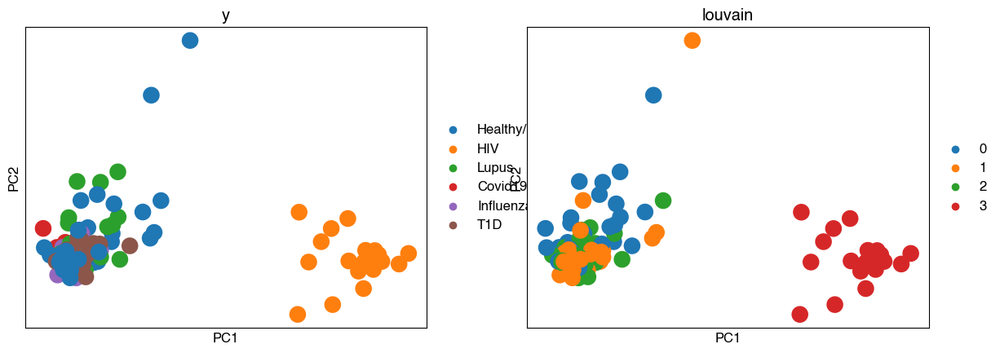

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:12:53.838029"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:12:53.862203"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:12:53.882155"}


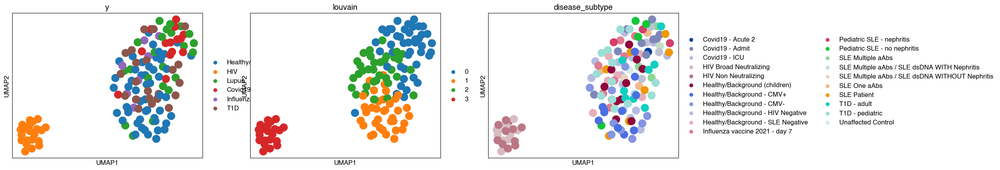

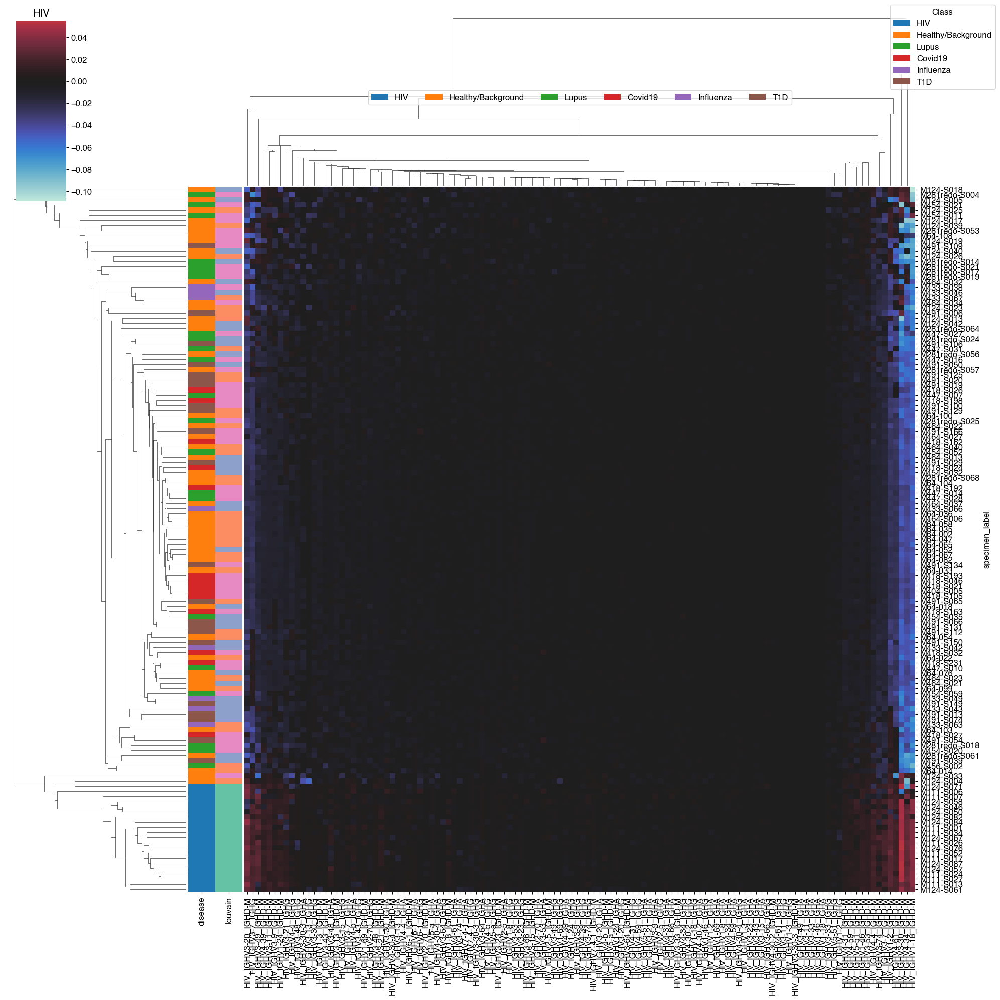

{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:12:58.417833"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:12:58.422851"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:12:58.424800"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:12:58.442204"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:12:58.460112"}


21 1
0    21
Name: louvain, dtype: int64


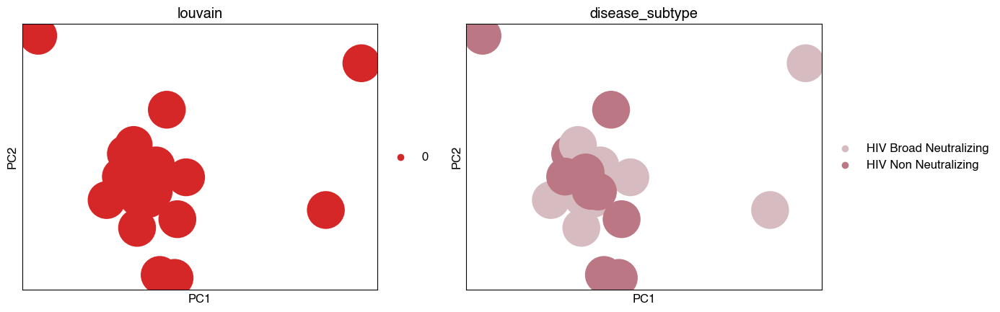

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:12:58.573623"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:12:58.590513"}


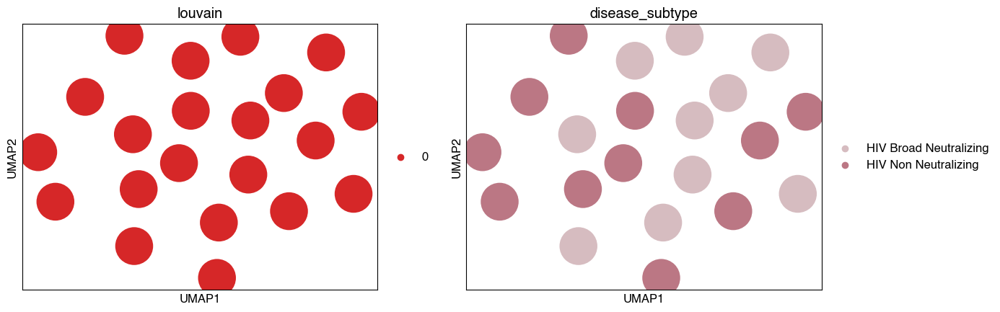

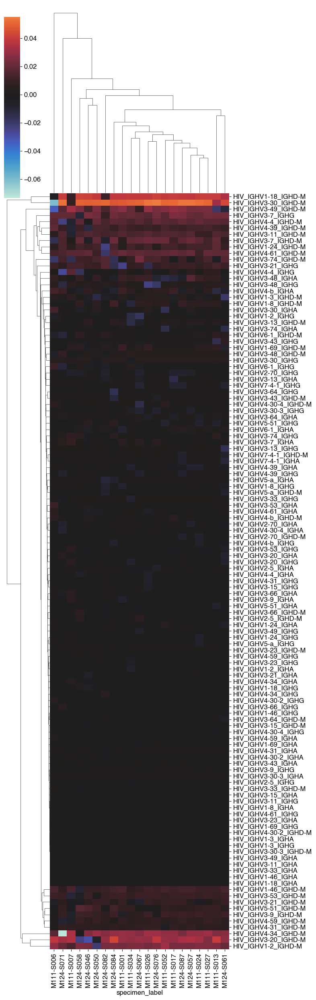

disease_subtype         louvain
HIV Broad Neutralizing  0          1.0
HIV Non Neutralizing    0          1.0
Name: louvain, dtype: float64

louvain  disease_subtype       
0        HIV Non Neutralizing      0.52381
         HIV Broad Neutralizing    0.47619
Name: disease_subtype, dtype: float64

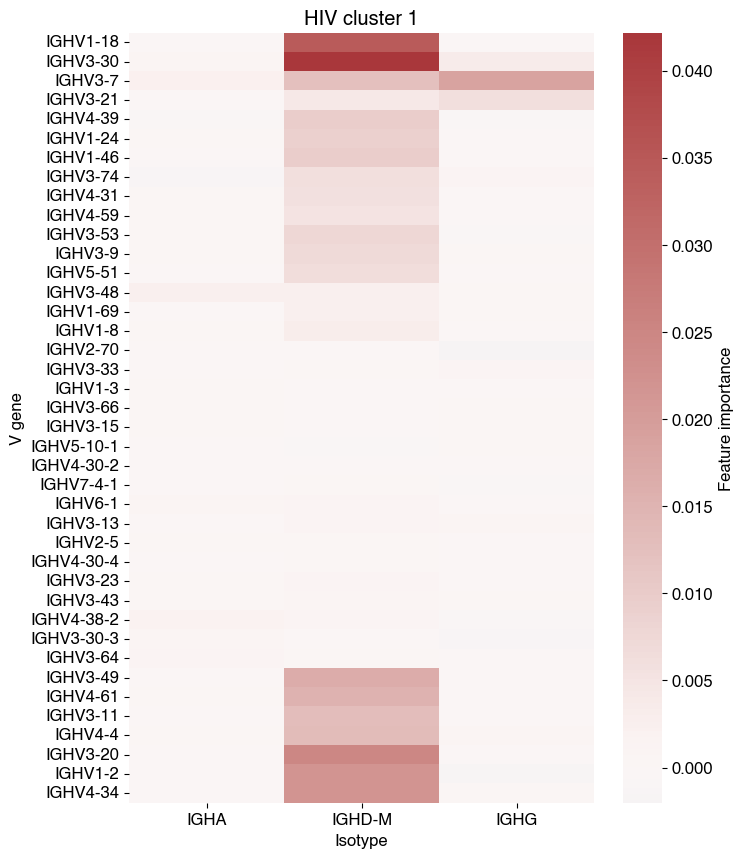

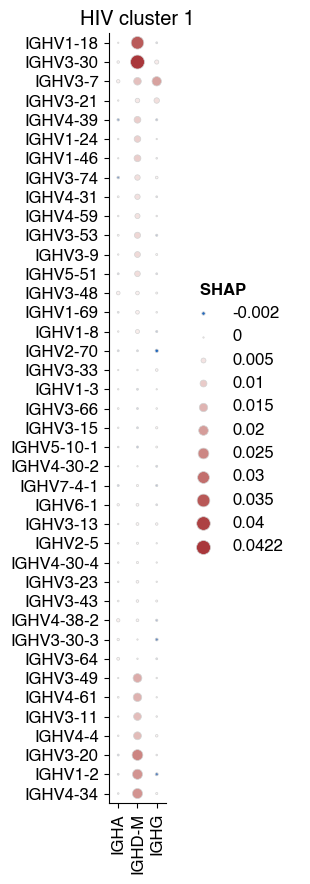

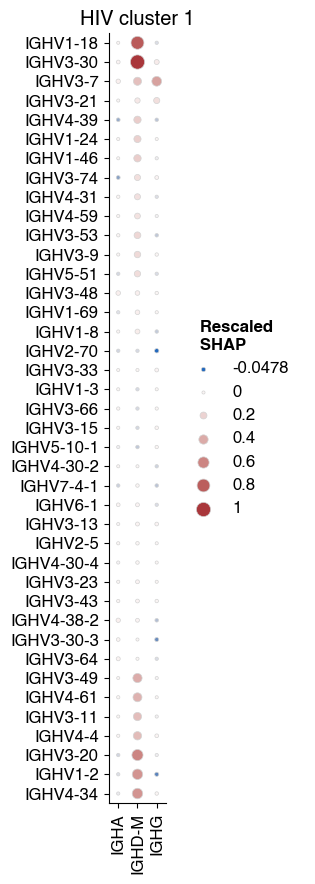

---

## Healthy/Background, GeneLocus.BCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:13:02.924276"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:13:03.681826"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:13:03.684769"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:13:03.686970"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:13:03.689236"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:13:03.691481"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:13:03.694389"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:13:03.696327"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:13:03.698157"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:13:03.700989"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:13:03.702915"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:03.725509"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:03.760253"}


3


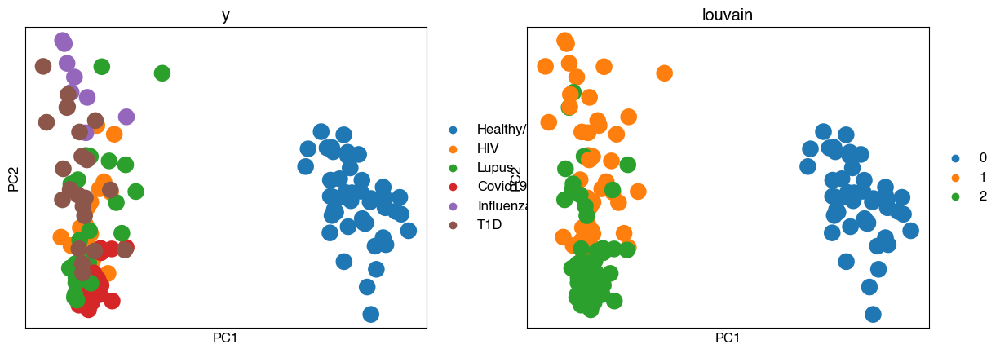

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:03.952651"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:03.974246"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:03.993895"}


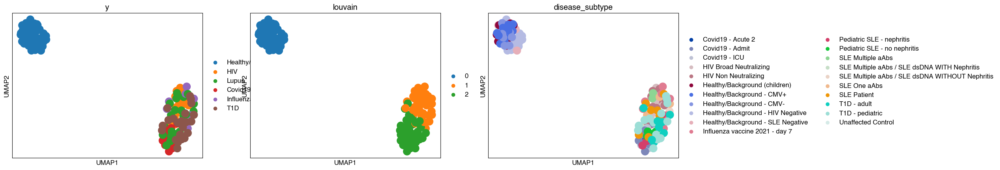

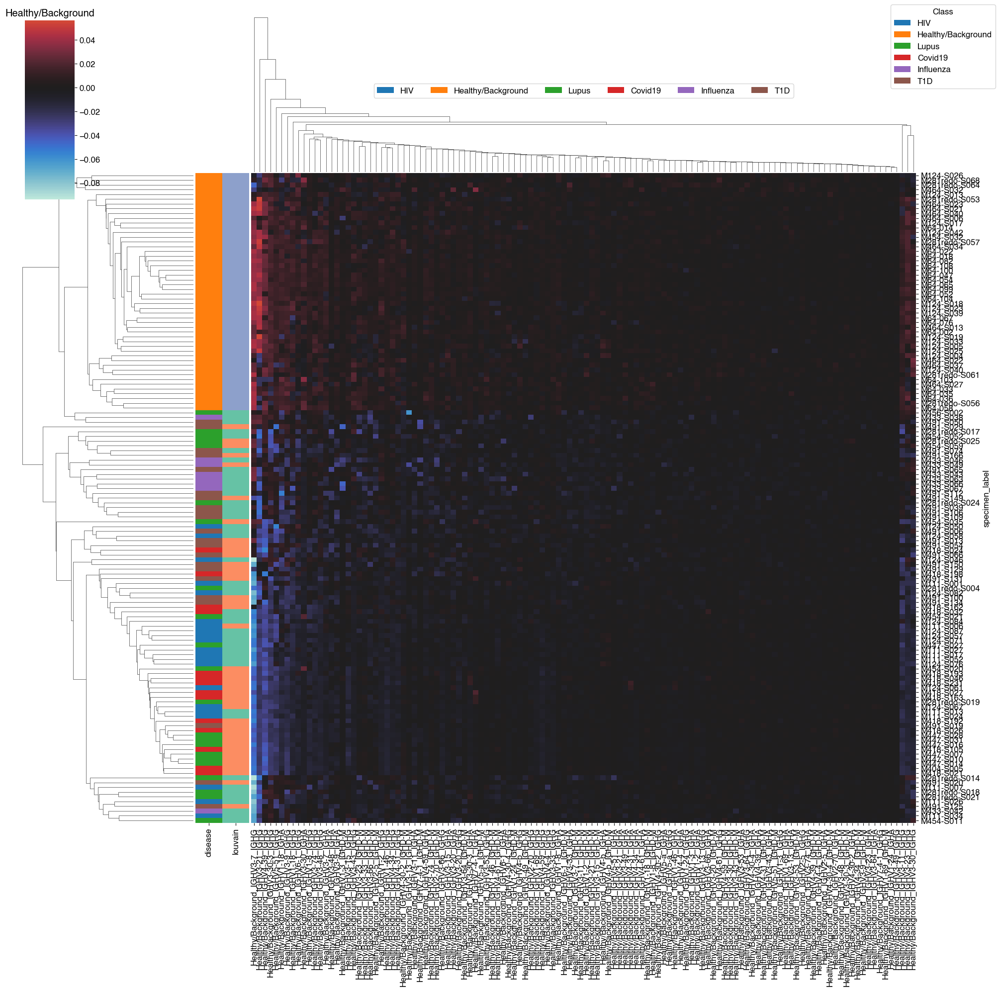

{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:13:08.551026"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:13:08.555251"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:13:08.557295"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:08.575655"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:08.598770"}


50 3
0    26
1    19
2     5
Name: louvain, dtype: int64


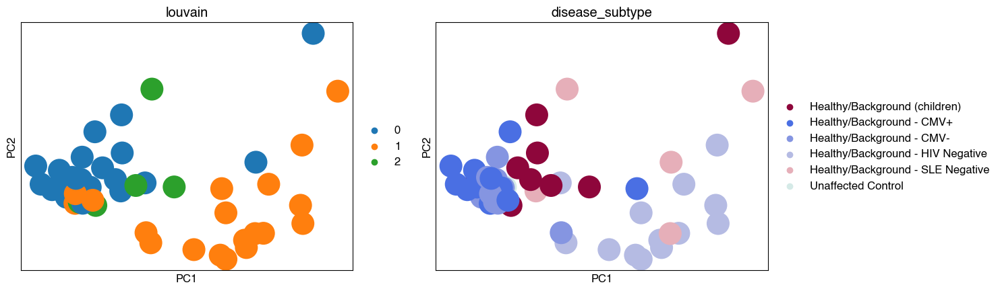

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:08.770767"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:08.791700"}


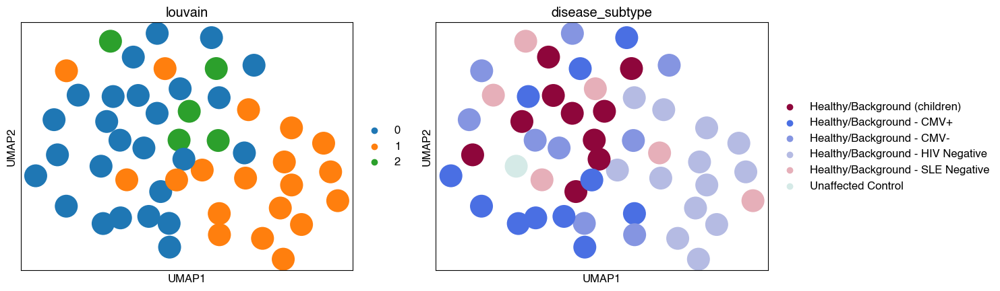

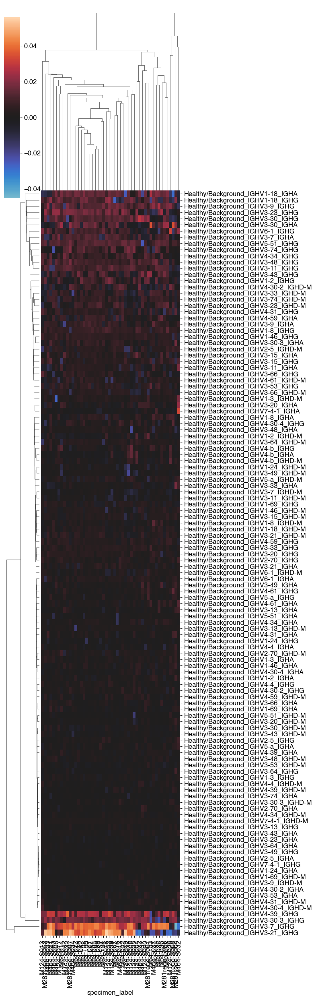

disease_subtype                    louvain
Healthy/Background (children)      0          0.700000
                                   2          0.300000
                                   1          0.000000
Healthy/Background - CMV+          0          0.727273
                                   1          0.272727
                                   2          0.000000
Healthy/Background - CMV-          0          0.666667
                                   1          0.222222
                                   2          0.111111
Healthy/Background - HIV Negative  1          0.923077
                                   0          0.076923
                                   2          0.000000
Healthy/Background - SLE Negative  0          0.500000
                                   1          0.333333
                                   2          0.166667
Unaffected Control                 0          1.000000
                                   1          0.000000
                      

louvain  disease_subtype                  
0        Healthy/Background - CMV+            0.307692
         Healthy/Background (children)        0.269231
         Healthy/Background - CMV-            0.230769
         Healthy/Background - SLE Negative    0.115385
         Healthy/Background - HIV Negative    0.038462
         Unaffected Control                   0.038462
1        Healthy/Background - HIV Negative    0.631579
         Healthy/Background - CMV+            0.157895
         Healthy/Background - CMV-            0.105263
         Healthy/Background - SLE Negative    0.105263
         Healthy/Background (children)        0.000000
         Unaffected Control                   0.000000
2        Healthy/Background (children)        0.600000
         Healthy/Background - CMV-            0.200000
         Healthy/Background - SLE Negative    0.200000
         Healthy/Background - CMV+            0.000000
         Healthy/Background - HIV Negative    0.000000
         Unaffected Co

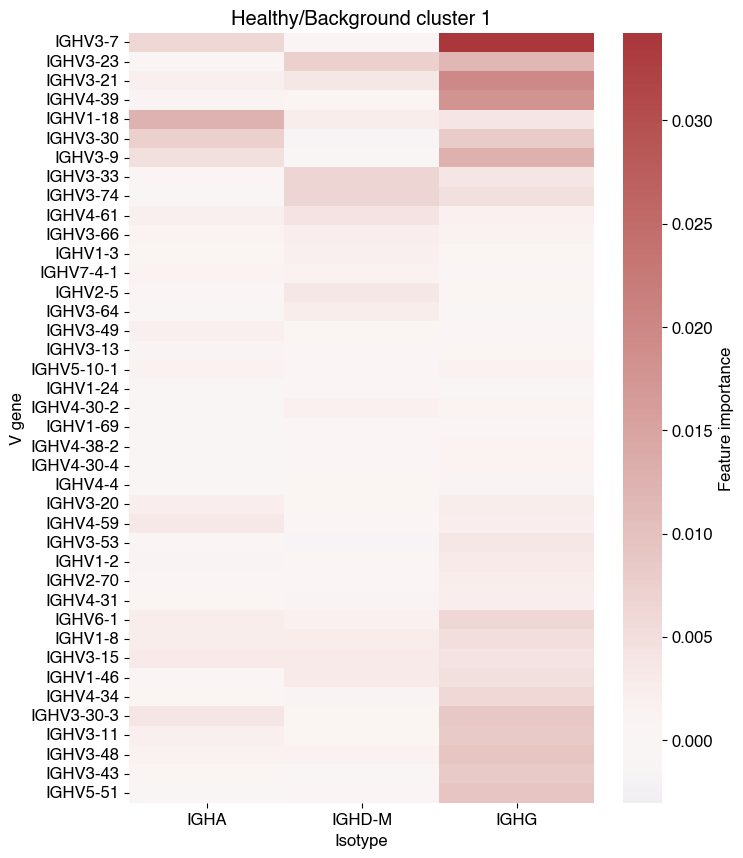

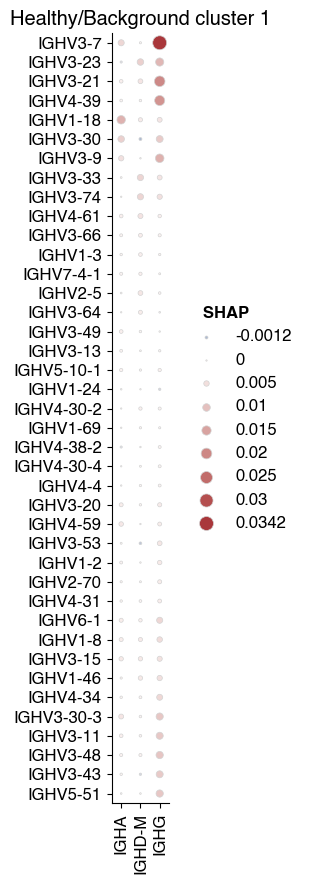

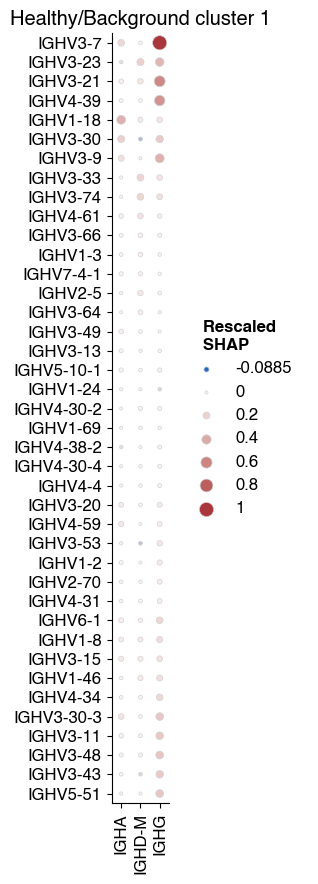

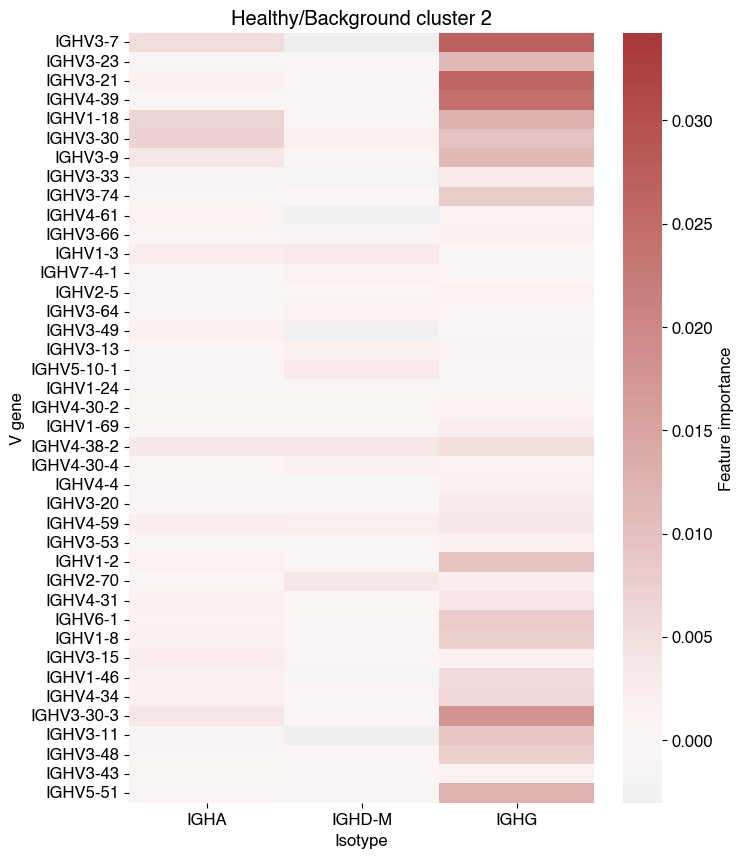

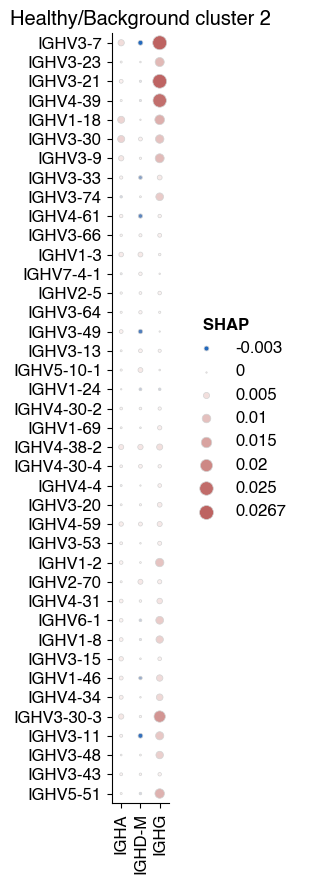

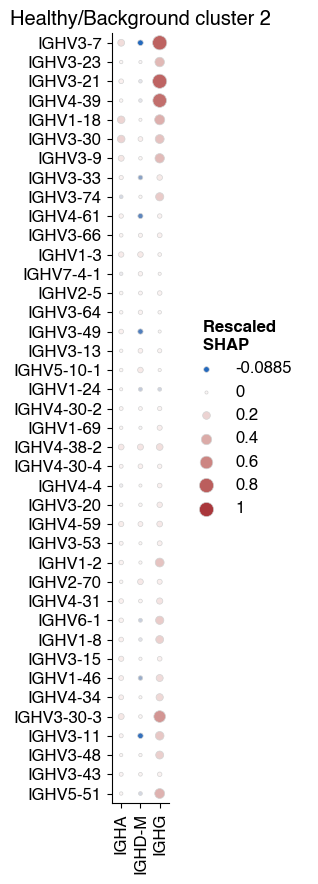

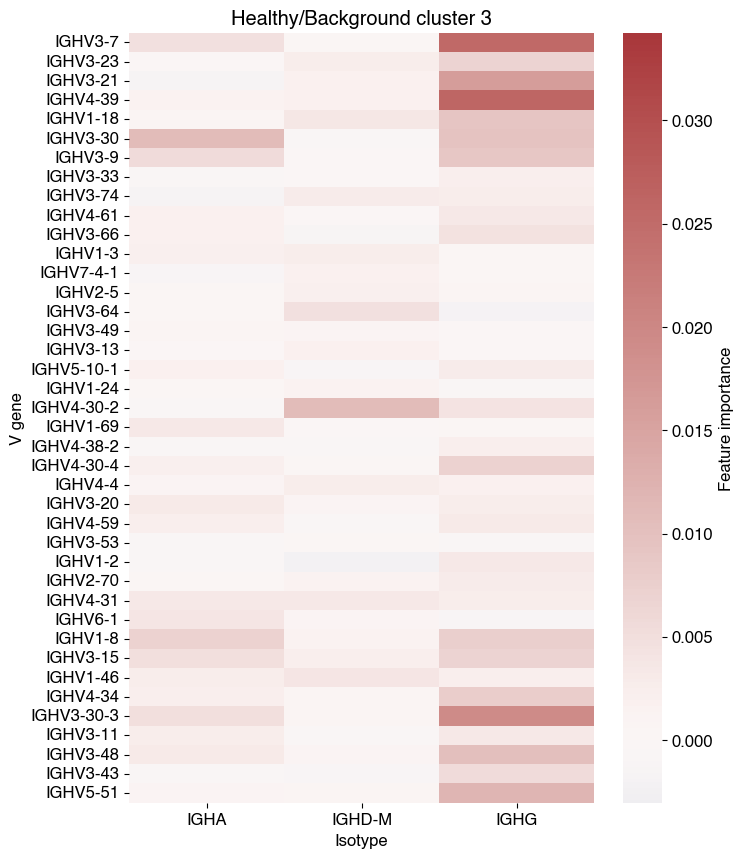

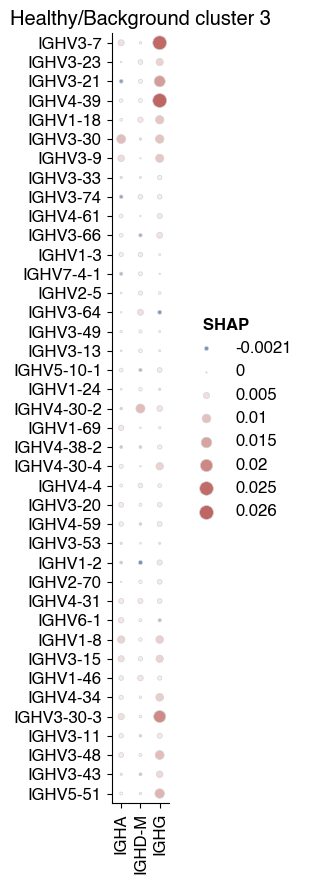

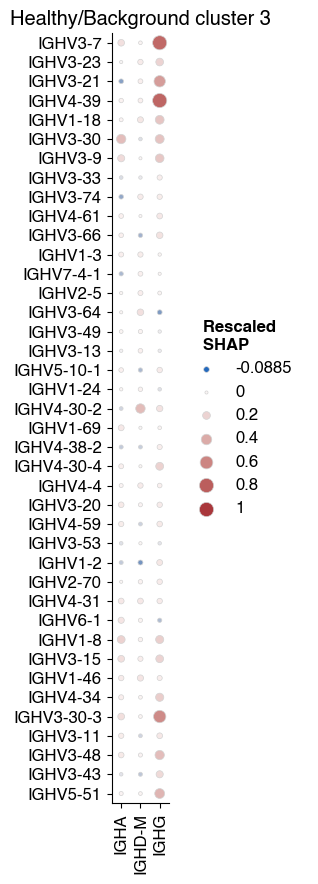

---

## Lupus, GeneLocus.BCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:13:17.054542"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:13:18.183955"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:13:18.186995"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:13:18.189387"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:13:18.191603"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:13:18.193984"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:13:18.197051"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:13:18.199238"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:13:18.201627"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:13:18.204666"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:13:18.206292"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:18.232879"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:18.279393"}


4


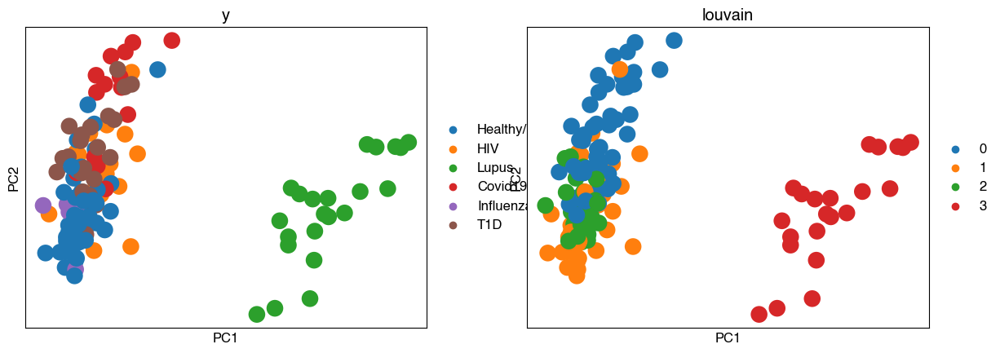

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:18.503117"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:18.528362"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:18.548880"}


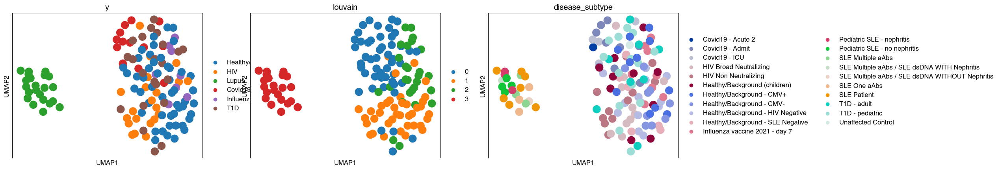

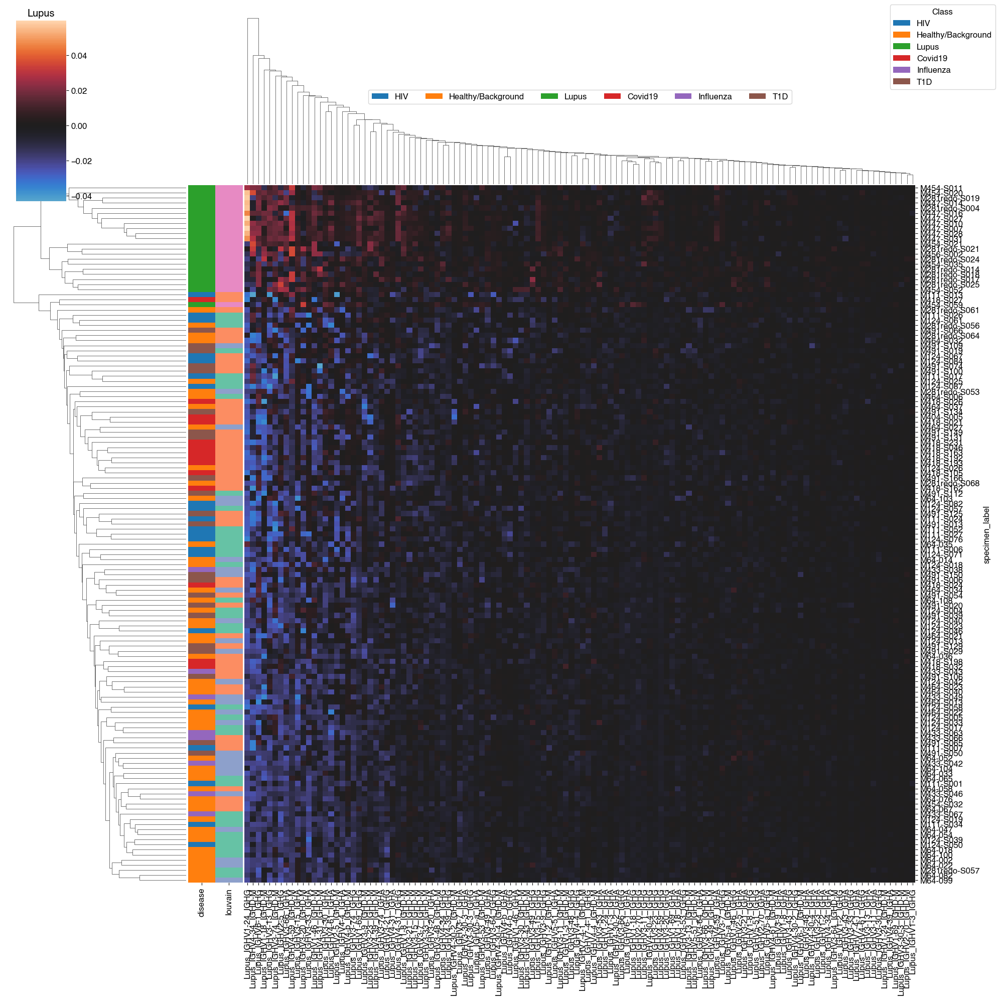

{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:13:23.395024"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:13:23.397179"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:13:23.398239"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:23.411664"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:23.425594"}


22 2
0    11
1    11
Name: louvain, dtype: int64


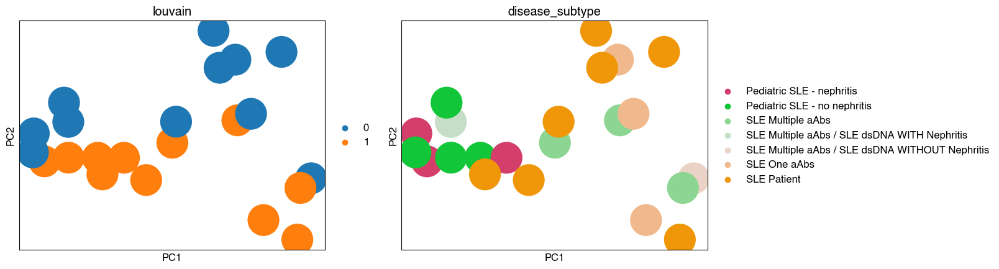

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:23.577476"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:23.592618"}


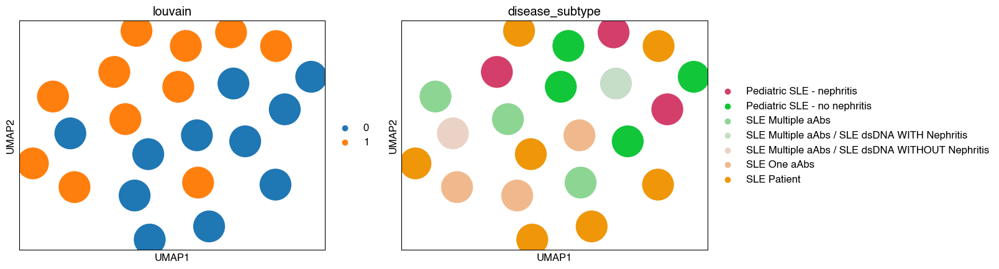

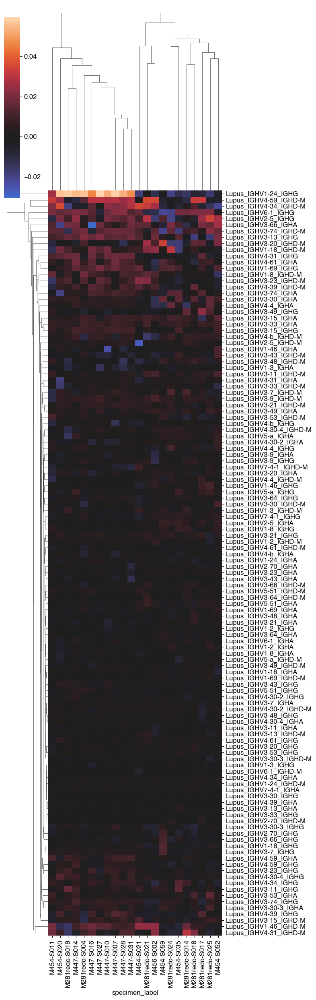

disease_subtype                                  louvain
Pediatric SLE - nephritis                        1          0.666667
                                                 0          0.333333
Pediatric SLE - no nephritis                     0          0.500000
                                                 1          0.500000
SLE Multiple aAbs                                1          1.000000
                                                 0          0.000000
SLE Multiple aAbs / SLE dsDNA WITH Nephritis     0          1.000000
                                                 1          0.000000
SLE Multiple aAbs / SLE dsDNA WITHOUT Nephritis  0          1.000000
                                                 1          0.000000
SLE One aAbs                                     0          0.666667
                                                 1          0.333333
SLE Patient                                      0          0.571429
                                              

louvain  disease_subtype                                
0        SLE Patient                                        0.363636
         Pediatric SLE - no nephritis                       0.181818
         SLE One aAbs                                       0.181818
         Pediatric SLE - nephritis                          0.090909
         SLE Multiple aAbs / SLE dsDNA WITH Nephritis       0.090909
         SLE Multiple aAbs / SLE dsDNA WITHOUT Nephritis    0.090909
         SLE Multiple aAbs                                  0.000000
1        SLE Multiple aAbs                                  0.272727
         SLE Patient                                        0.272727
         Pediatric SLE - nephritis                          0.181818
         Pediatric SLE - no nephritis                       0.181818
         SLE One aAbs                                       0.090909
         SLE Multiple aAbs / SLE dsDNA WITH Nephritis       0.000000
         SLE Multiple aAbs / SLE dsDNA WITHOUT

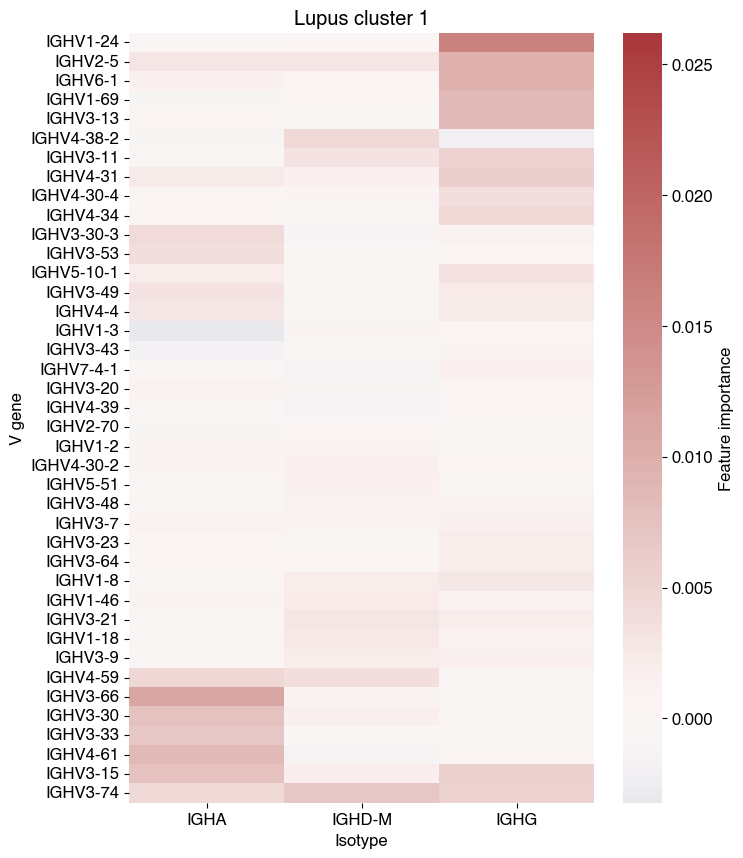

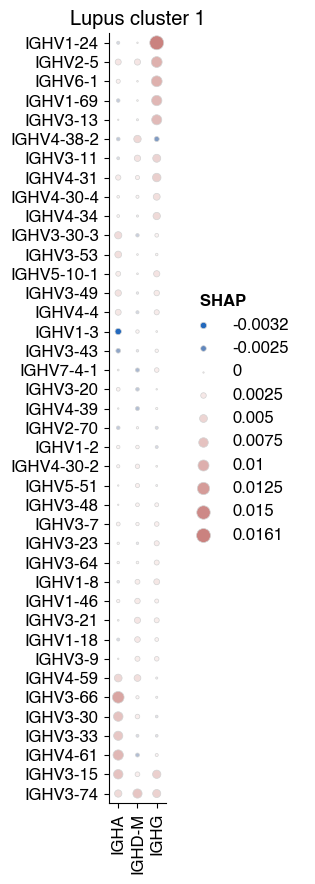

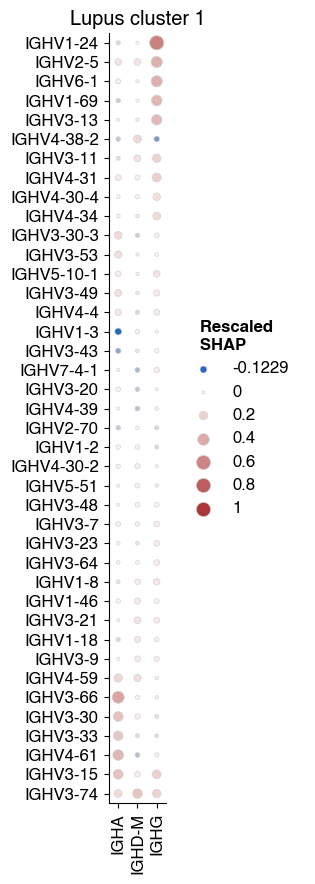

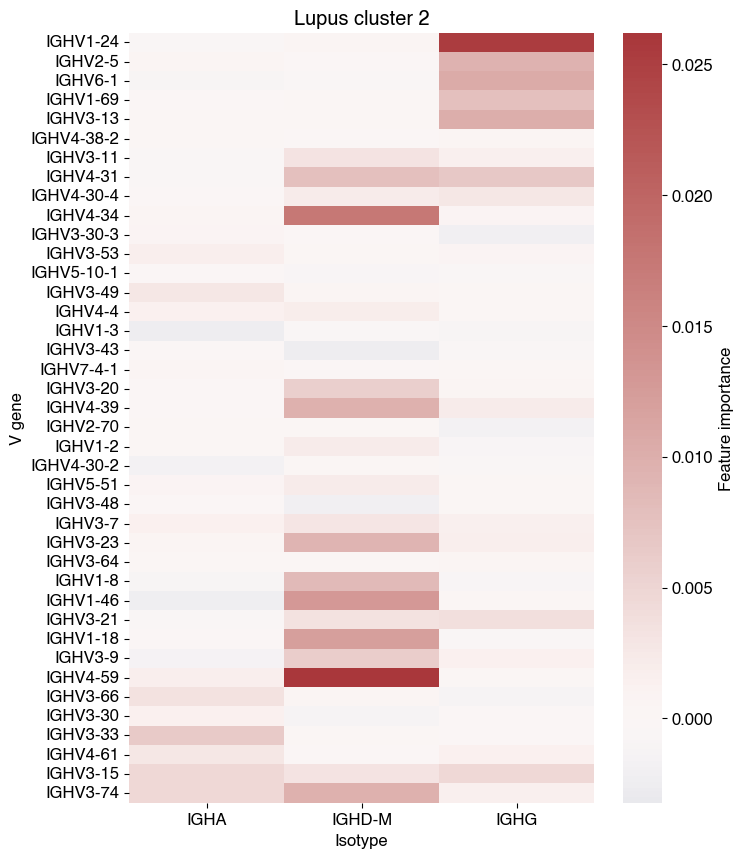

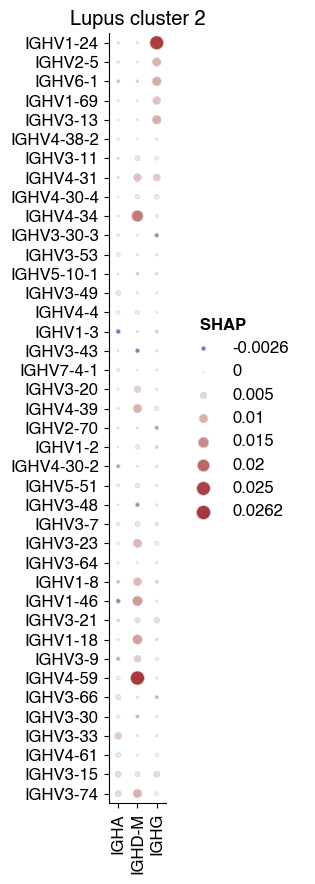

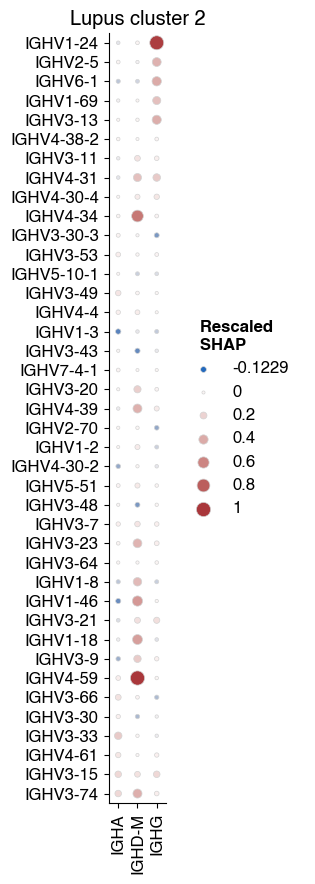

---

## Covid19, GeneLocus.BCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:13:29.019110"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:13:29.822323"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:13:29.824801"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:13:29.826203"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:13:29.827927"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:13:29.829155"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:13:29.830904"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:13:29.832061"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:13:29.833256"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:13:29.834772"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:13:29.835957"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:29.849904"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:29.872024"}


4


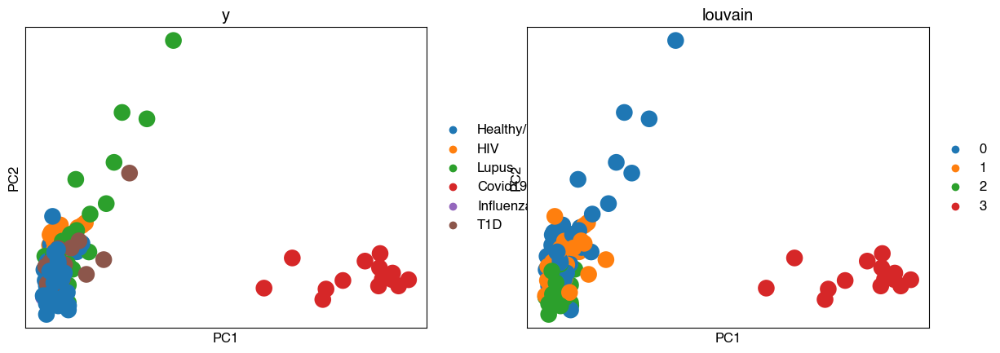

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:30.020351"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:30.041516"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:30.062194"}


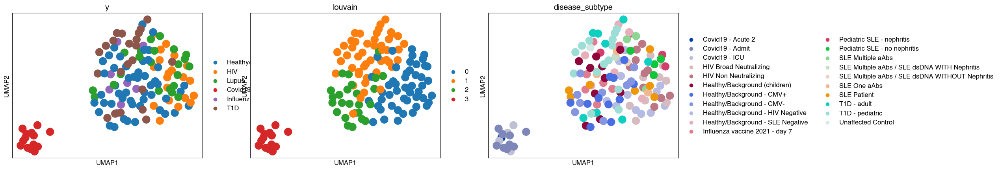

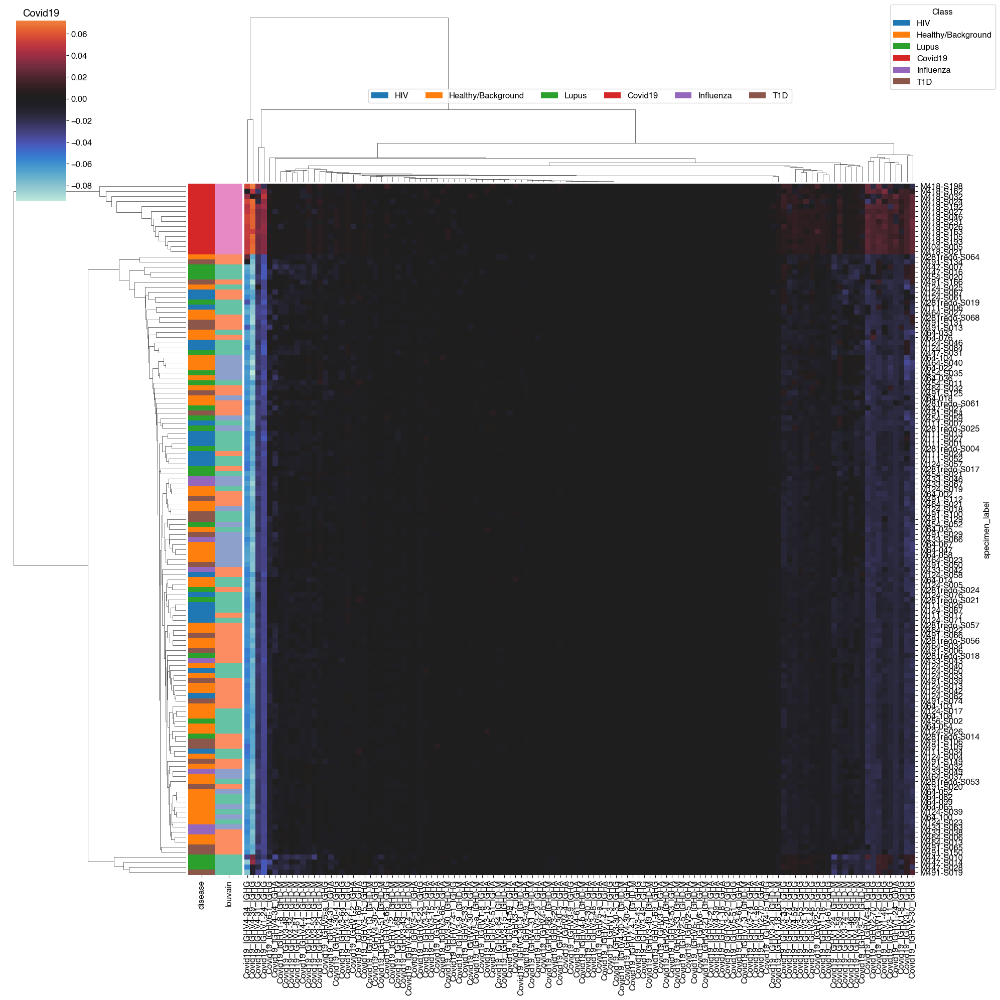

{"message": "invalid value encountered in sqrt\n", "time": "2024-08-10T03:13:33.754504"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:13:34.939247"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:13:34.942828"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:13:34.944808"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:34.964026"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:34.984761"}


14 2
0    9
1    5
Name: louvain, dtype: int64


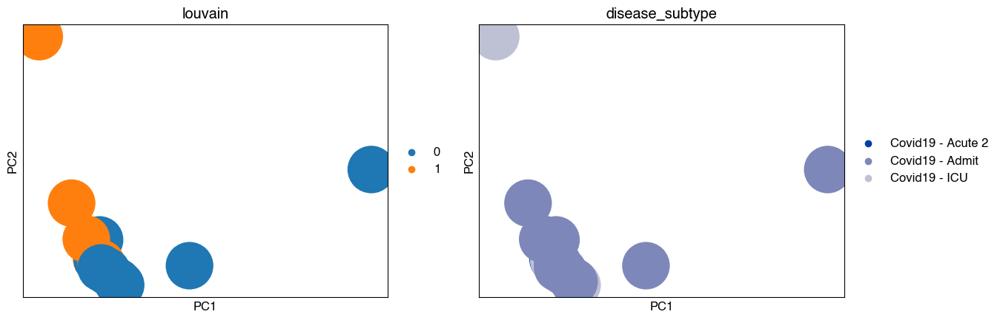

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:35.109997"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:35.127179"}


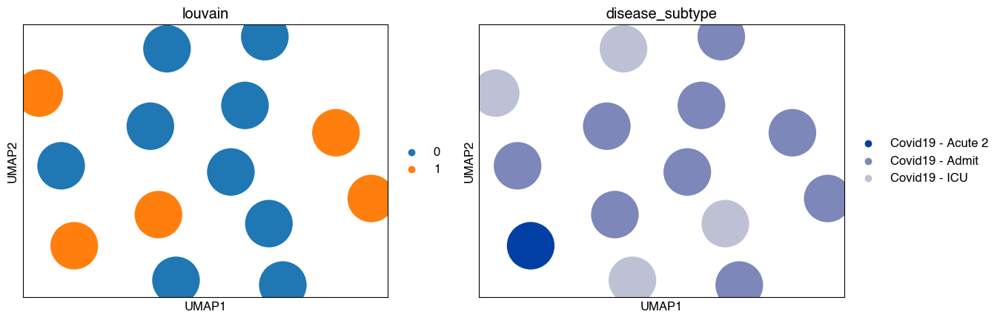

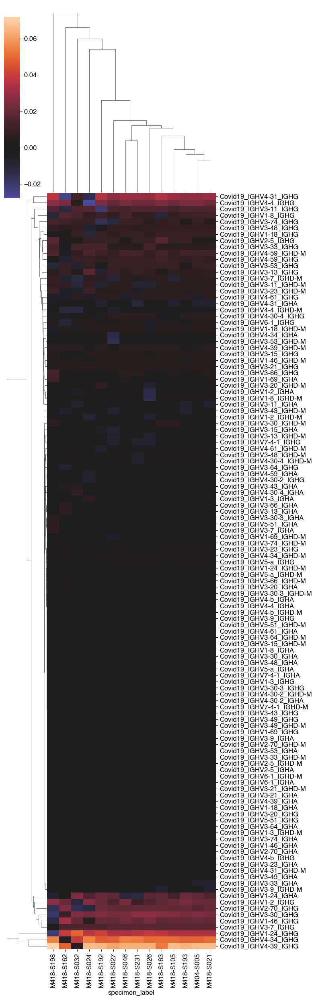

disease_subtype    louvain
Covid19 - Acute 2  1          1.000000
                   0          0.000000
Covid19 - Admit    0          0.666667
                   1          0.333333
Covid19 - ICU      0          0.750000
                   1          0.250000
Name: louvain, dtype: float64

louvain  disease_subtype  
0        Covid19 - Admit      0.666667
         Covid19 - ICU        0.333333
         Covid19 - Acute 2    0.000000
1        Covid19 - Admit      0.600000
         Covid19 - Acute 2    0.200000
         Covid19 - ICU        0.200000
Name: disease_subtype, dtype: float64

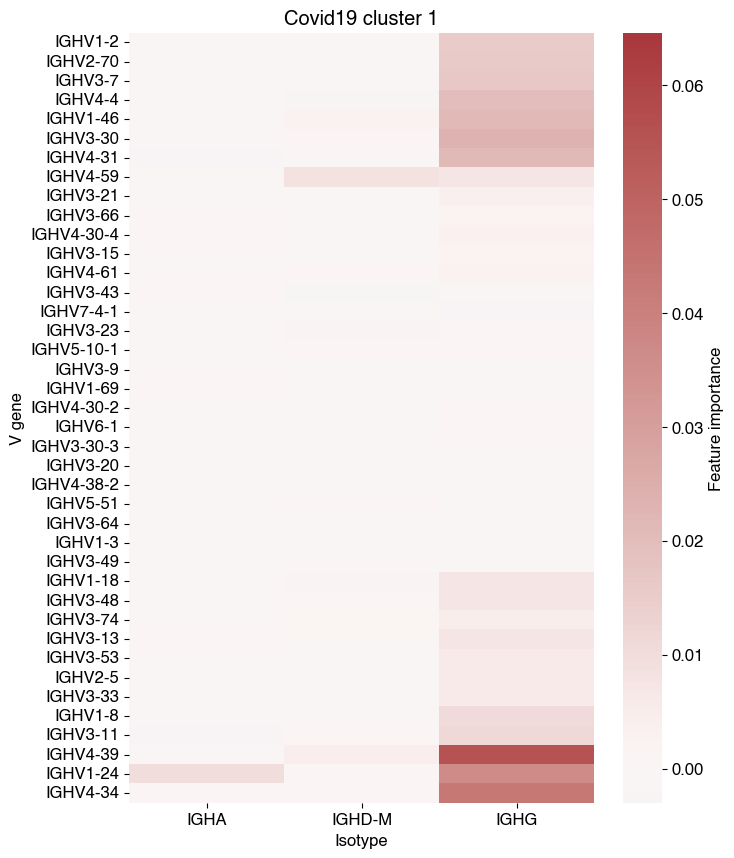

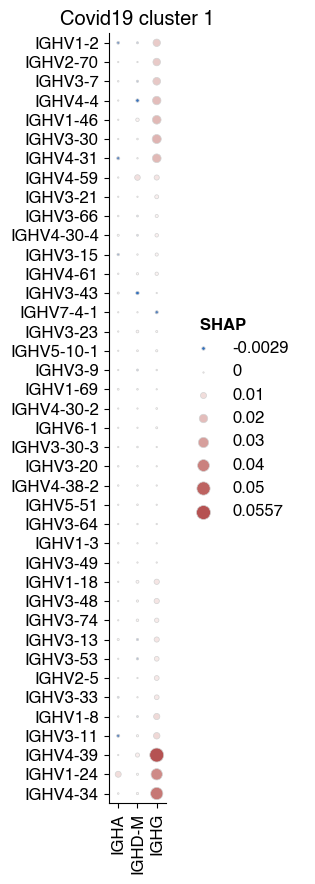

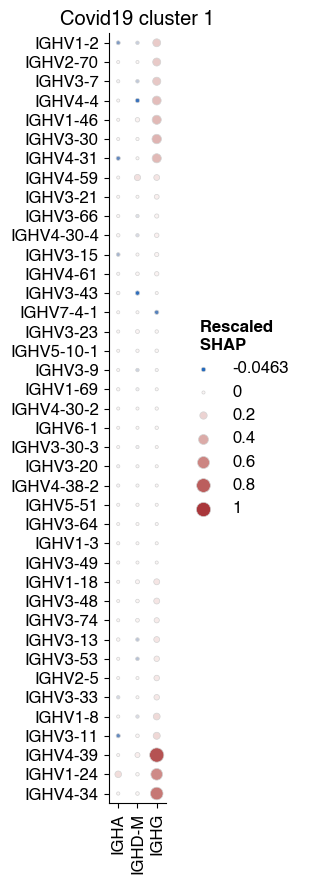

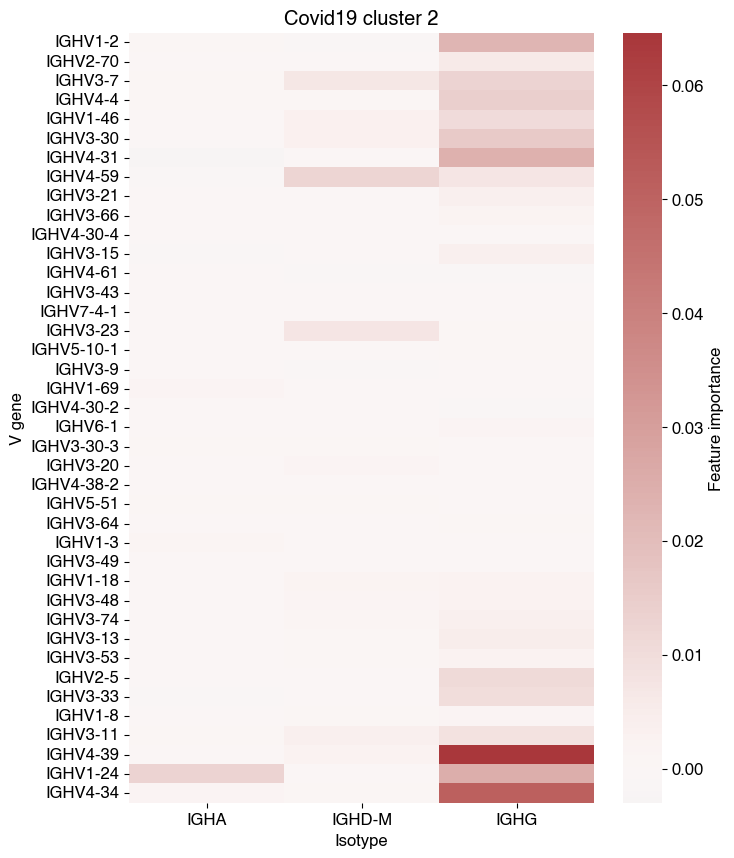

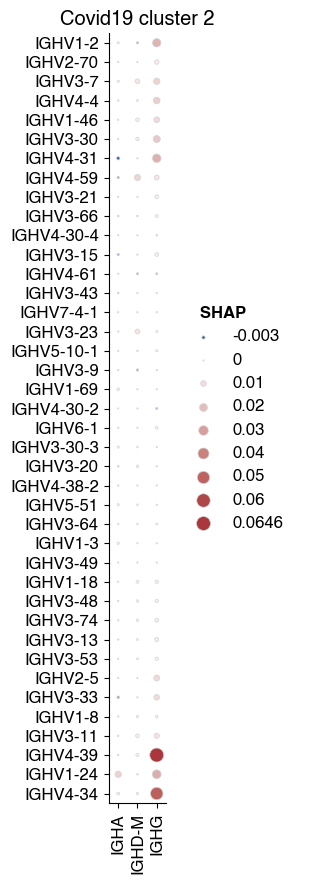

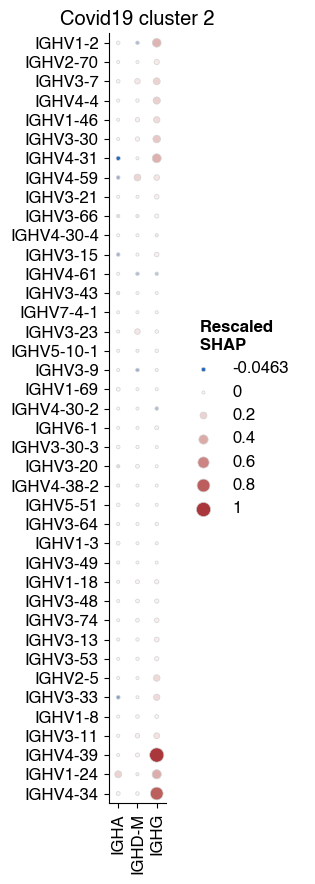

---

## Influenza, GeneLocus.BCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:13:40.521114"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:13:41.489343"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:13:41.492287"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:13:41.494766"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:13:41.496911"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:13:41.498875"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:13:41.501896"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:13:41.503377"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:13:41.504972"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:13:41.506932"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:13:41.508239"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:41.528151"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:41.561596"}


5


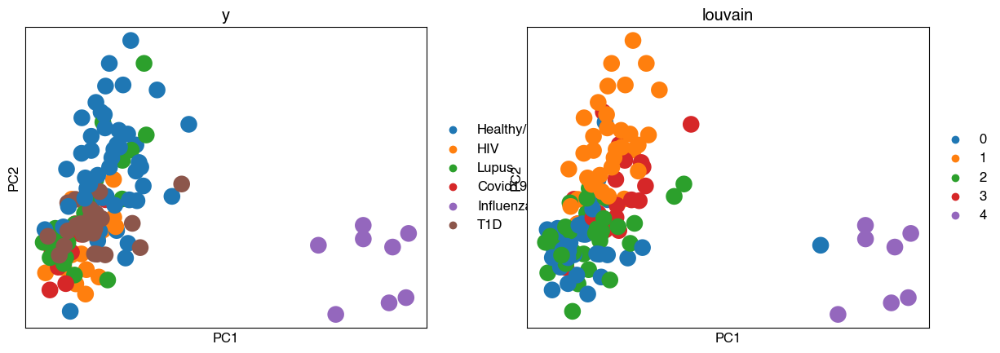

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:41.767826"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:41.790287"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:41.850430"}


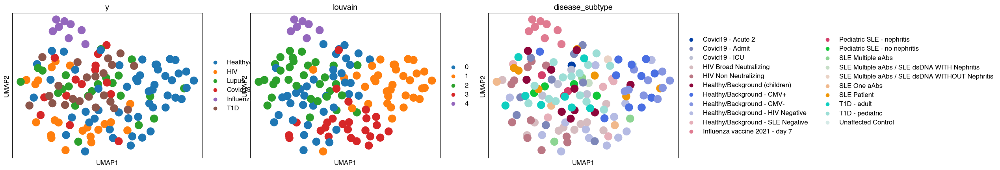

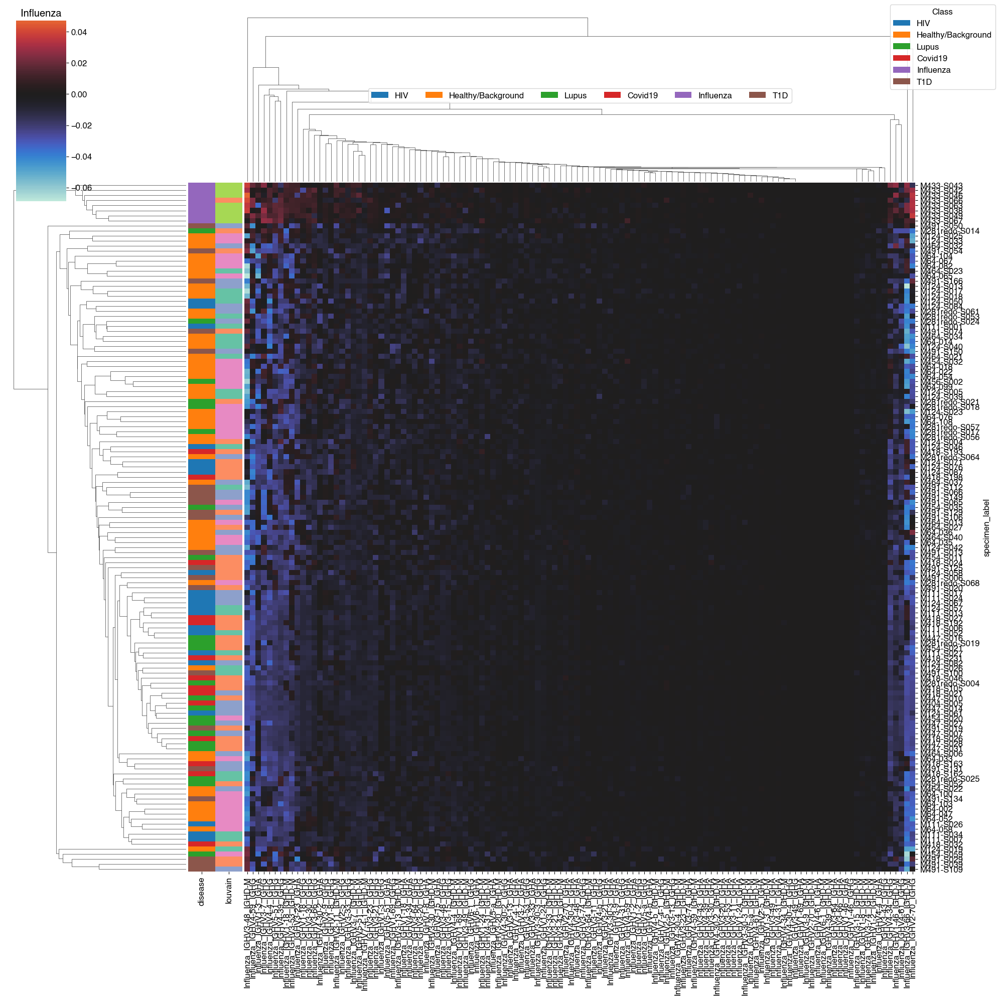

{"message": "invalid value encountered in sqrt\n", "time": "2024-08-10T03:13:45.871002"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:13:47.003547"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:13:47.006515"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:13:47.009374"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:47.026100"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:47.047699"}


8 2
0    5
1    3
Name: louvain, dtype: int64


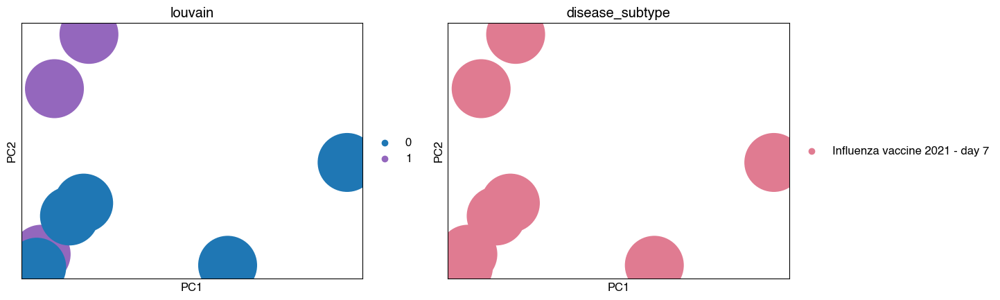

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:47.181633"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:47.225590"}


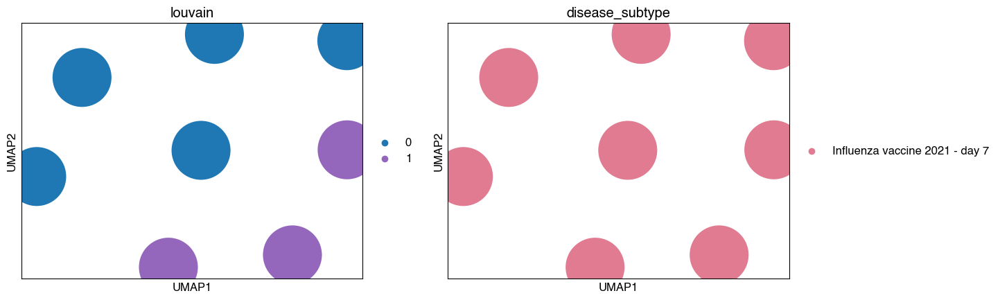

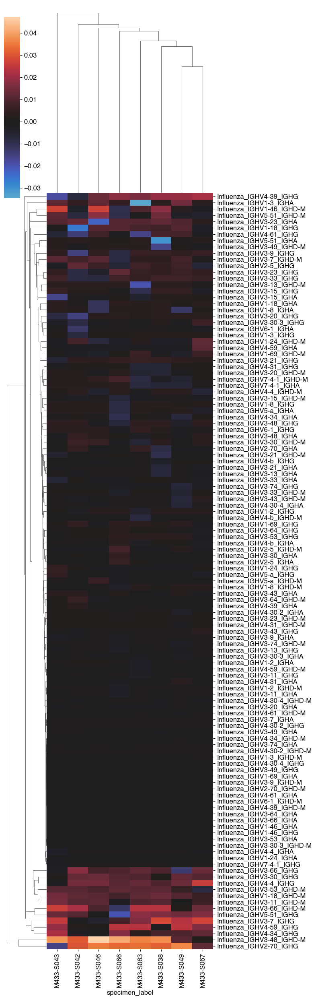

disease_subtype                 louvain
Influenza vaccine 2021 - day 7  0          0.625
                                1          0.375
Name: louvain, dtype: float64

louvain  disease_subtype               
0        Influenza vaccine 2021 - day 7    1.0
1        Influenza vaccine 2021 - day 7    1.0
Name: disease_subtype, dtype: float64

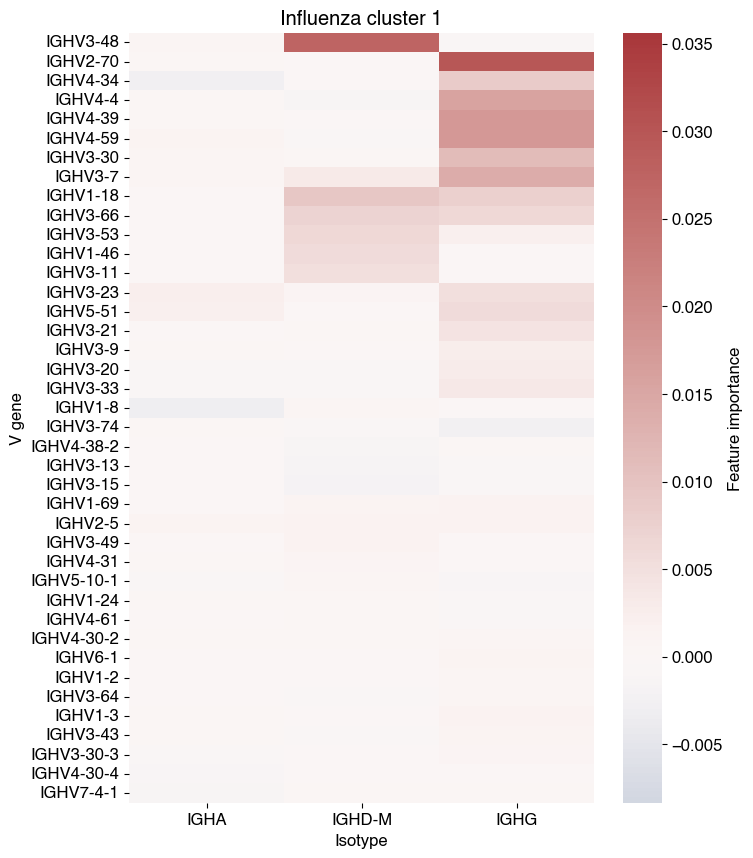

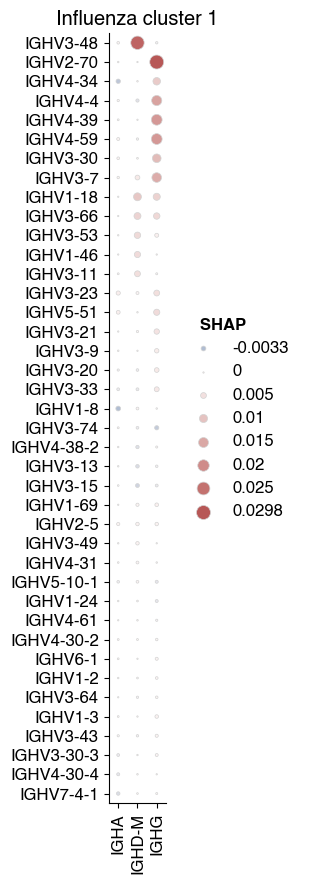

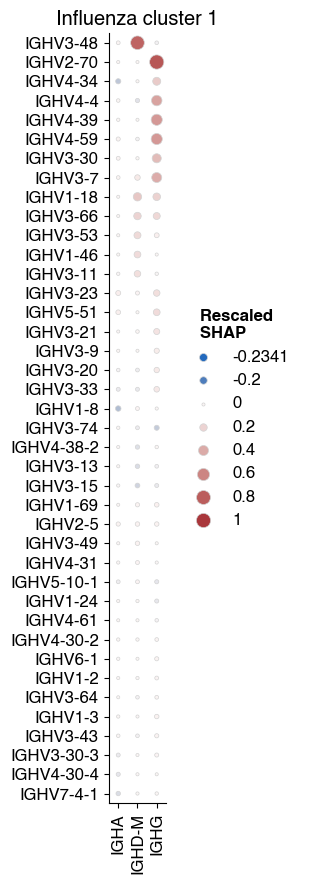

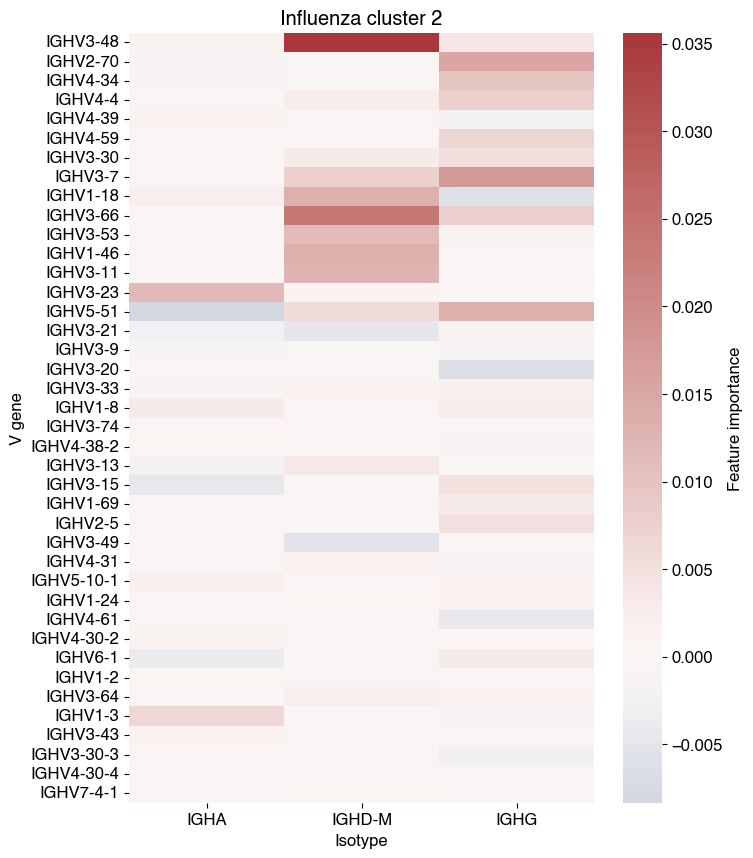

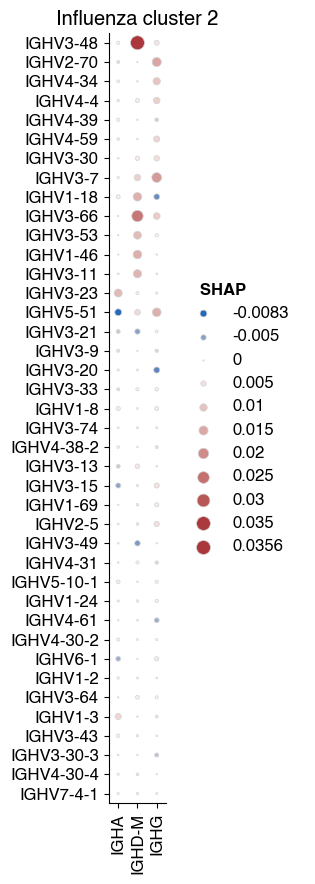

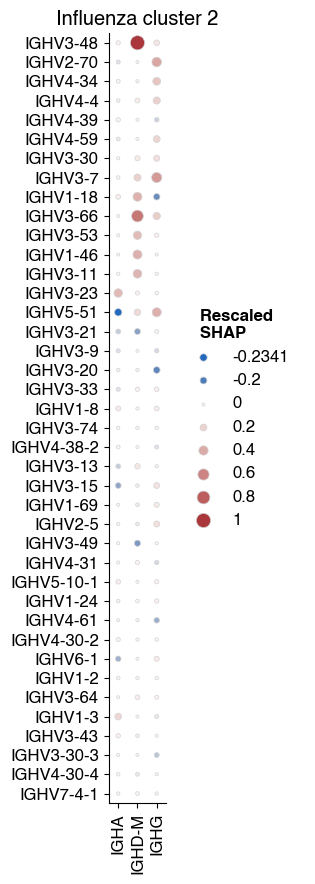

---

## T1D, GeneLocus.BCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:13:52.894724"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:13:53.729208"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:13:53.730851"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:13:53.732029"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:13:53.733214"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:13:53.734598"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:13:53.736359"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:13:53.737448"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:13:53.738630"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:13:53.741945"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:13:53.743231"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:53.770430"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:53.827458"}


4


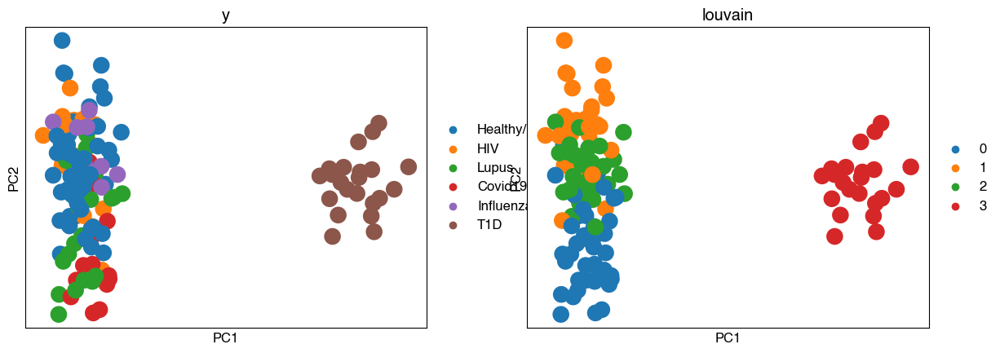

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:54.064319"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:54.089852"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:54.109973"}


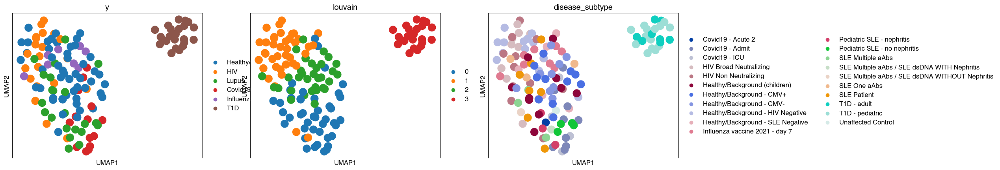

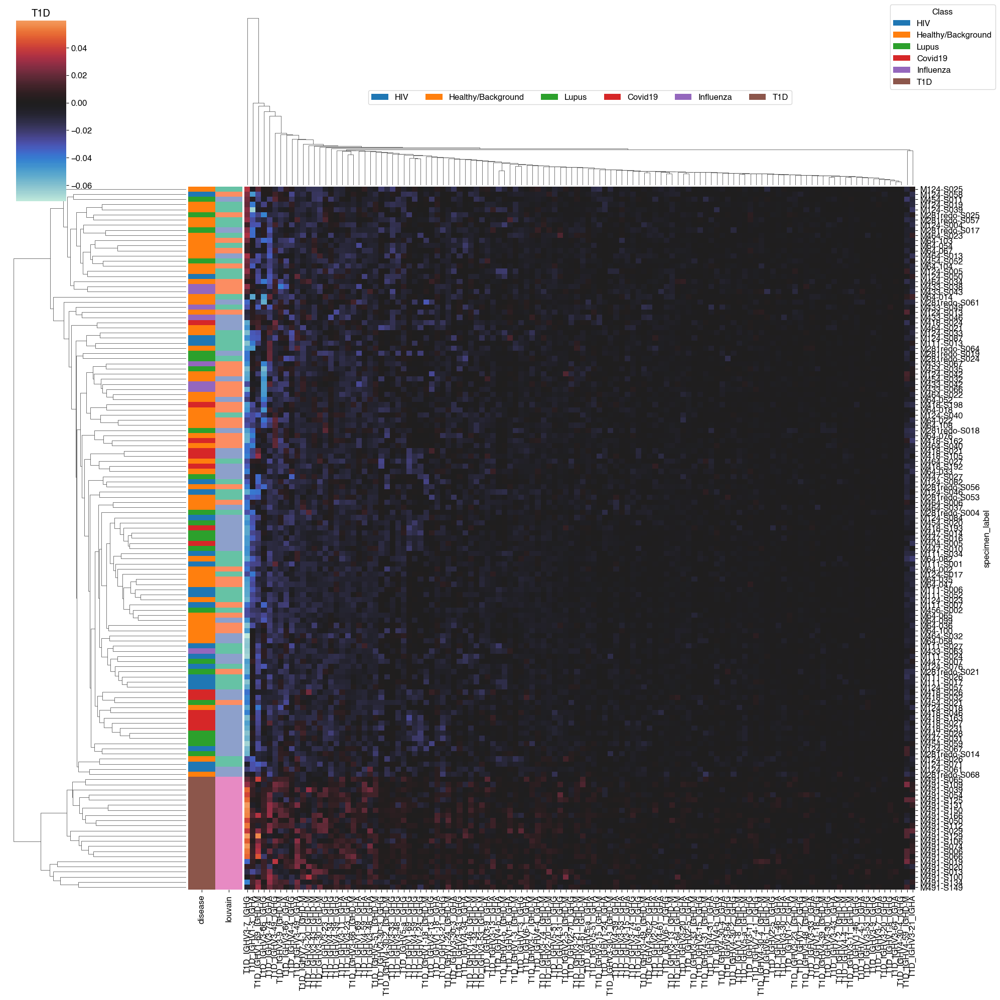

{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:13:59.503681"}


{"message": "... storing 'v_gene' as categorical", "time": "2024-08-10T03:13:59.507230"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:13:59.509452"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:59.529584"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:59.556775"}


22 2
0    14
1     8
Name: louvain, dtype: int64


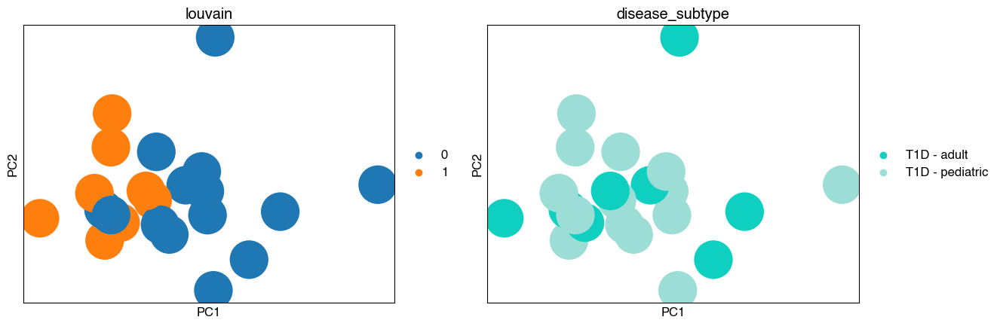

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:59.707824"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:13:59.727511"}


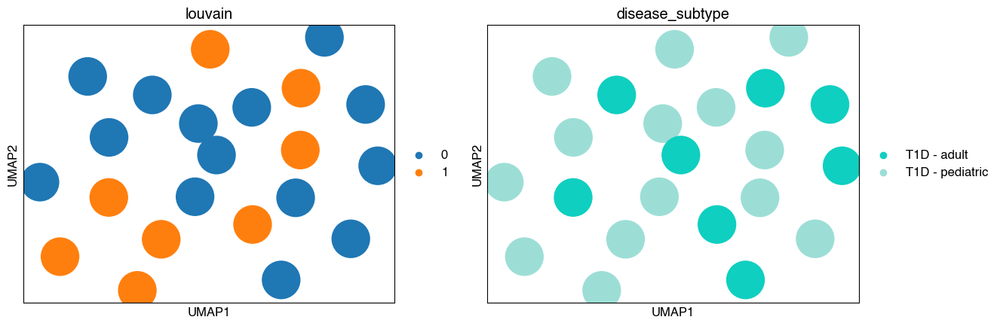

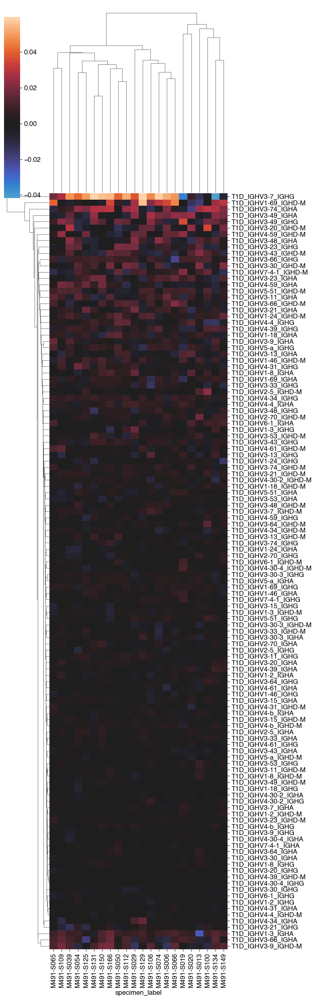

disease_subtype  louvain
T1D - adult      0          0.625000
                 1          0.375000
T1D - pediatric  0          0.642857
                 1          0.357143
Name: louvain, dtype: float64

louvain  disease_subtype
0        T1D - pediatric    0.642857
         T1D - adult        0.357143
1        T1D - pediatric    0.625000
         T1D - adult        0.375000
Name: disease_subtype, dtype: float64

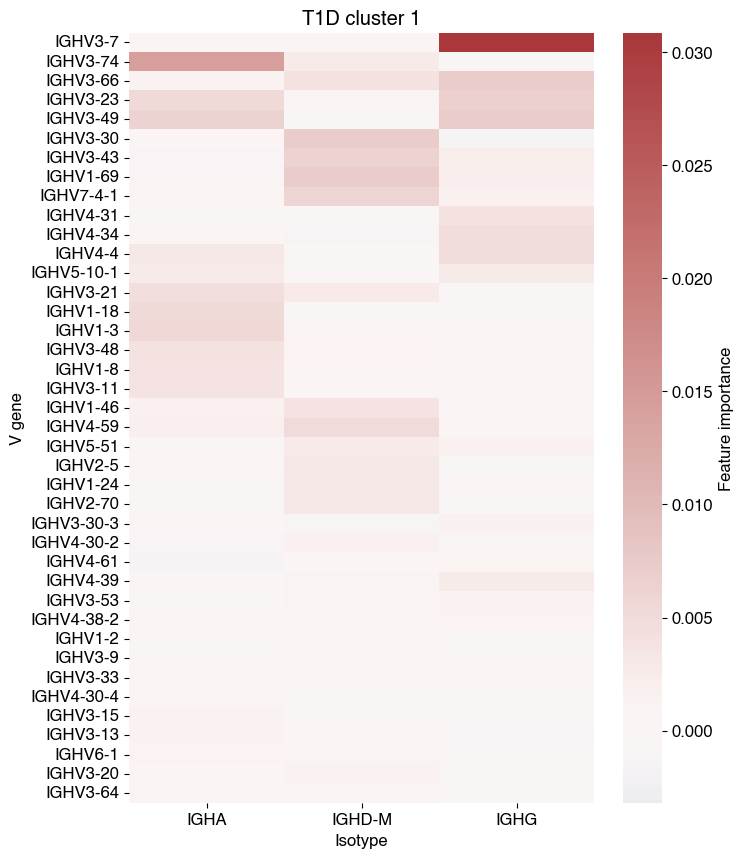

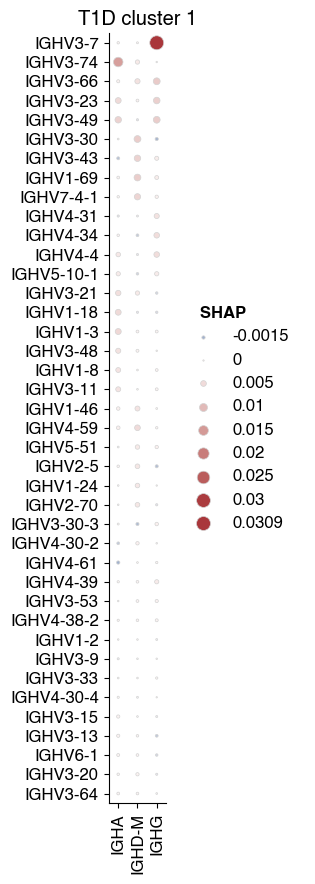

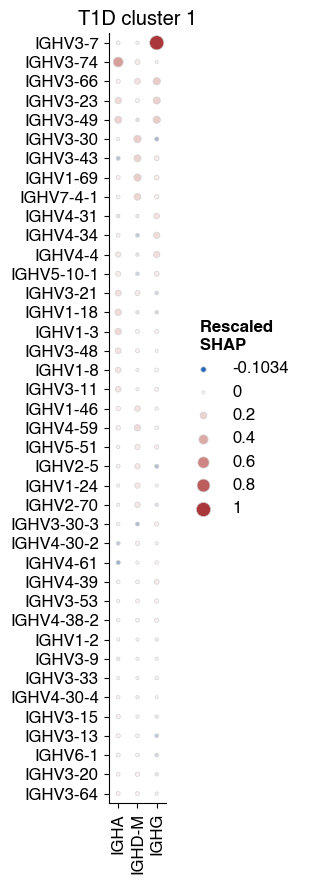

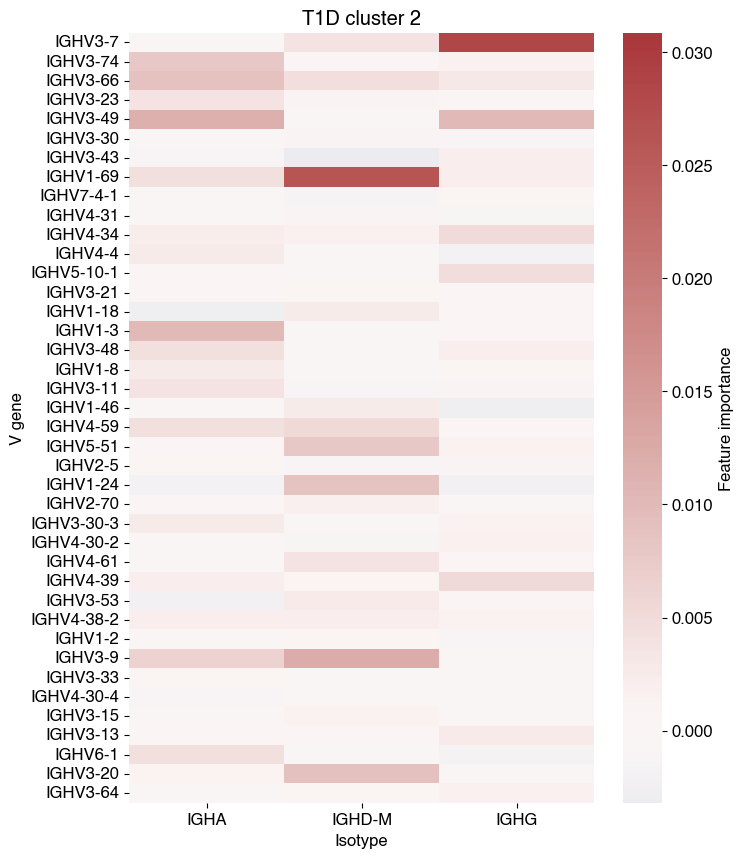

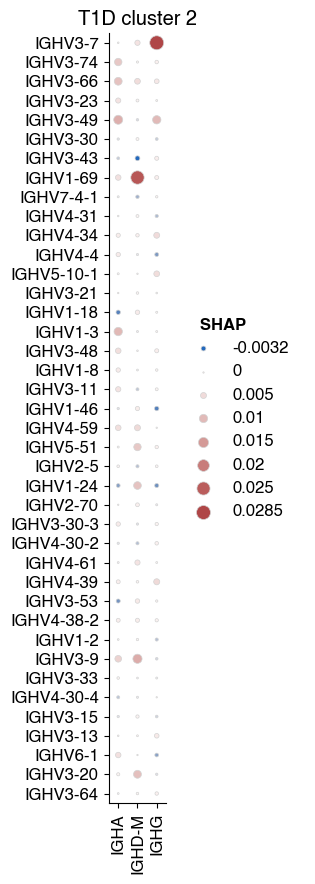

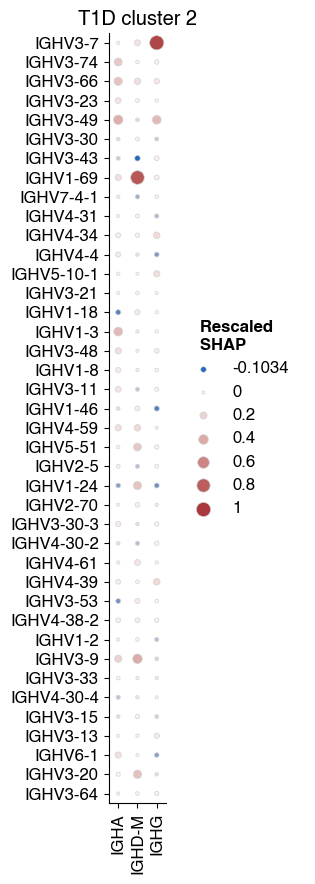

# GeneLocus.TCR

Healthy/Background    44
T1D                   22
HIV                   21
Lupus                 14
Covid19               13
Influenza              8
Name: disease, dtype: int64


---

## HIV, GeneLocus.TCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:14:05.222692"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:14:05.869815"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:14:05.872627"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:14:05.874786"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:14:05.876954"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:14:05.878816"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:14:05.881134"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:14:05.883818"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:05.885423"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:05.887514"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:05.905987"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:05.936697"}


4


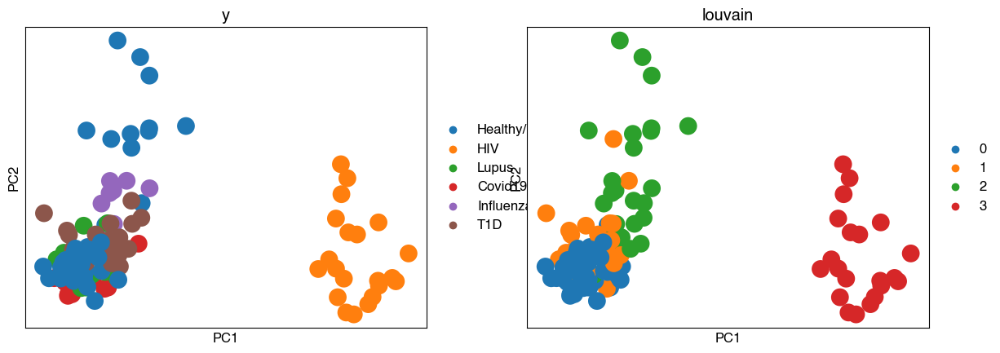

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:06.118551"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:06.138610"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:06.156776"}


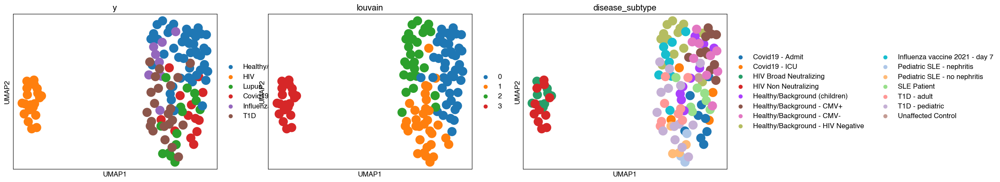

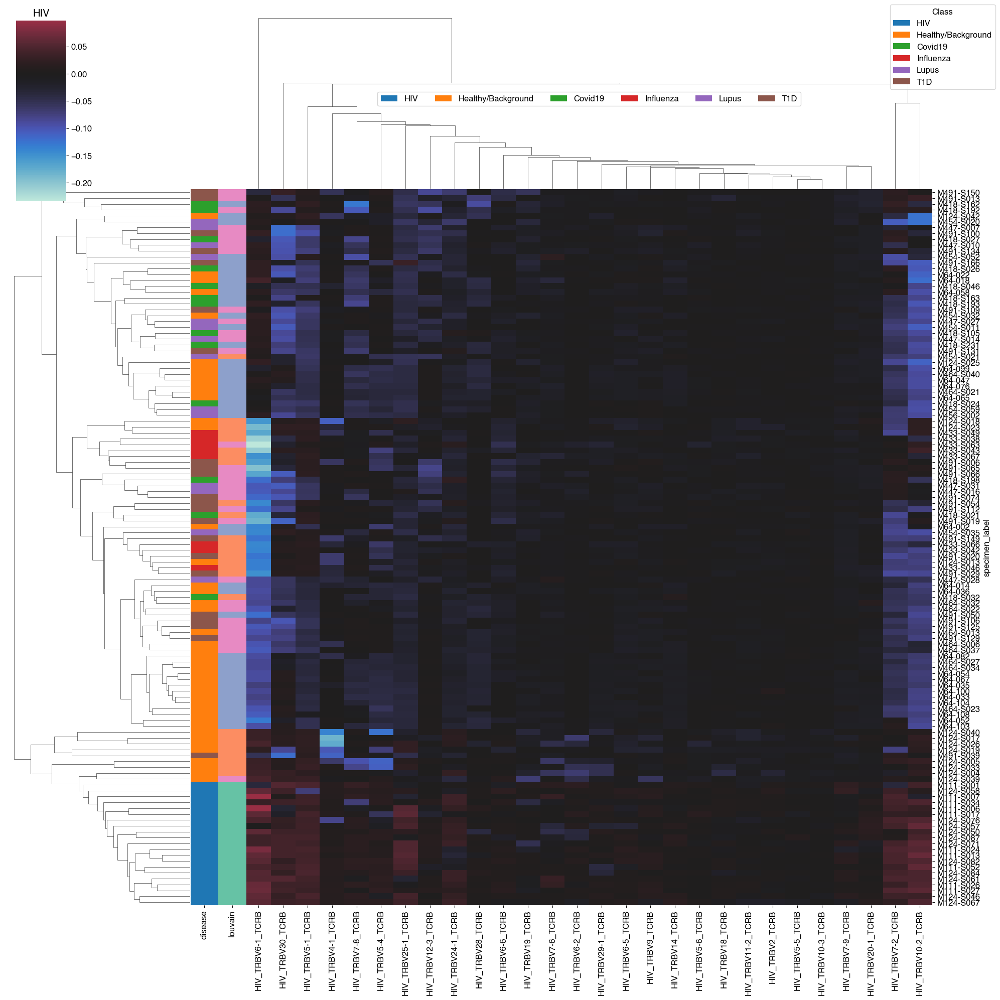

{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:10.260151"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:10.263532"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:10.278448"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:10.296287"}


21 2
0    11
1    10
Name: louvain, dtype: int64


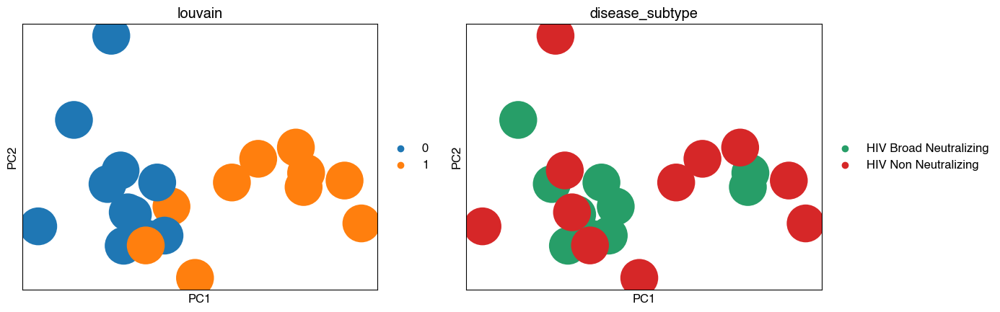

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:10.429338"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:10.446210"}


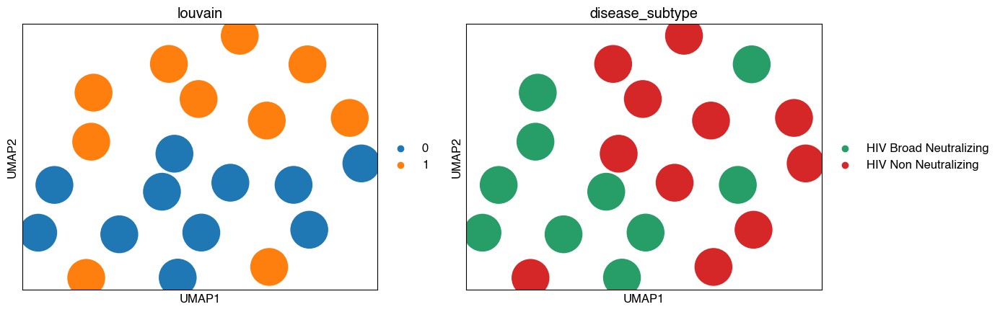

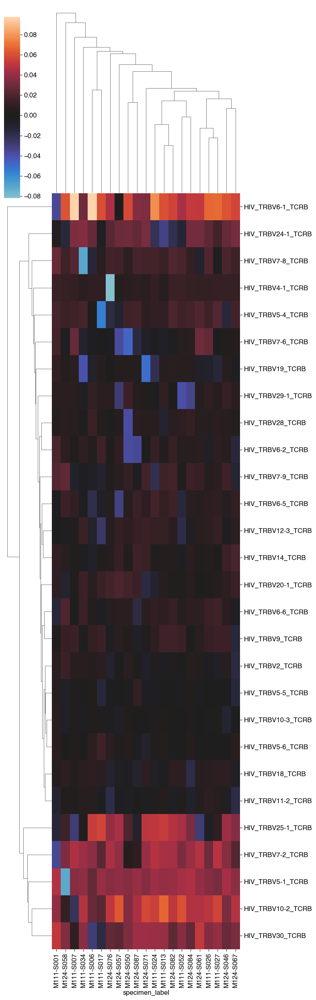

disease_subtype         louvain
HIV Broad Neutralizing  0          0.700000
                        1          0.300000
HIV Non Neutralizing    1          0.636364
                        0          0.363636
Name: louvain, dtype: float64

louvain  disease_subtype       
0        HIV Broad Neutralizing    0.636364
         HIV Non Neutralizing      0.363636
1        HIV Non Neutralizing      0.700000
         HIV Broad Neutralizing    0.300000
Name: disease_subtype, dtype: float64

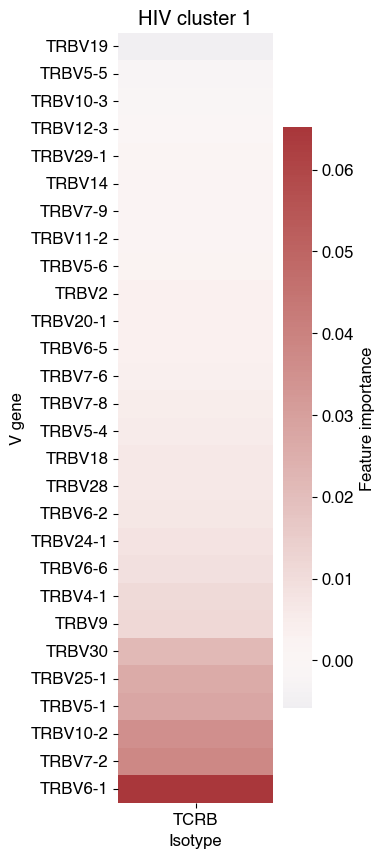

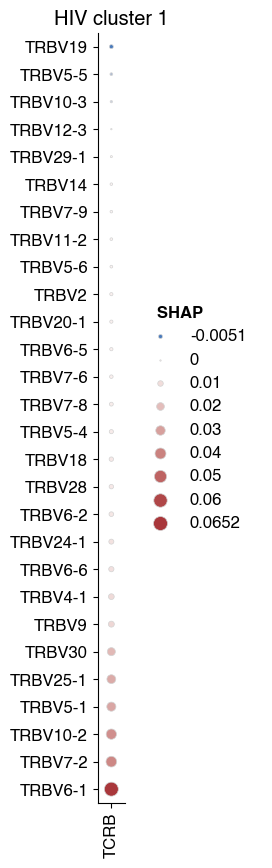

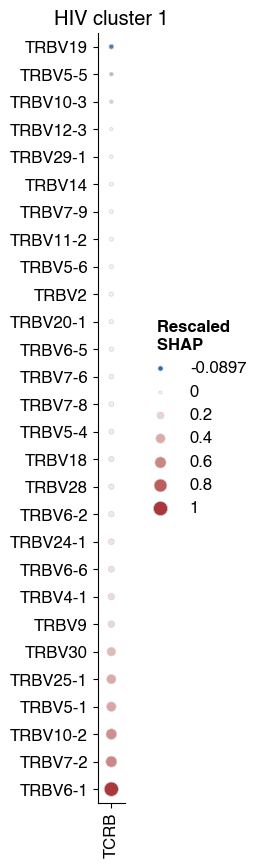

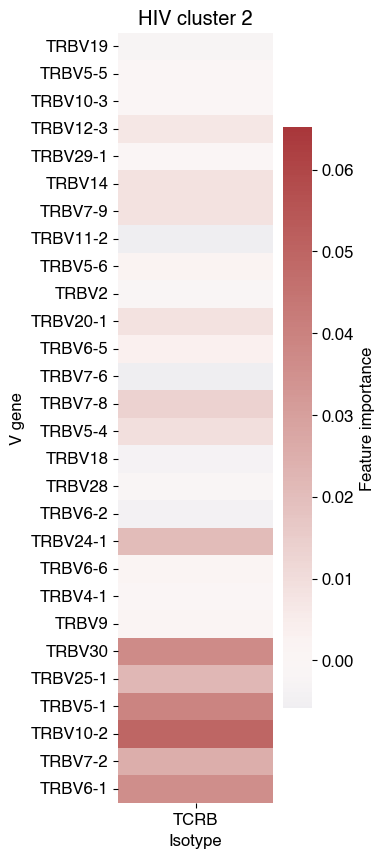

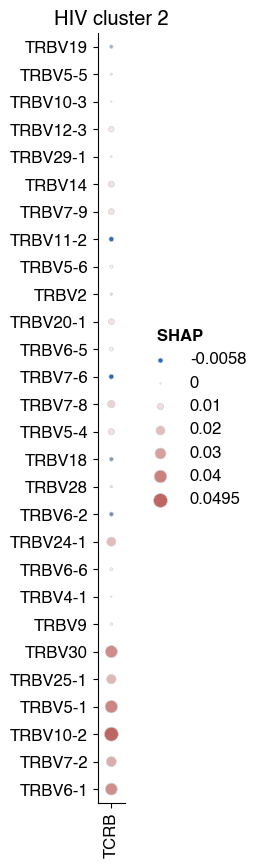

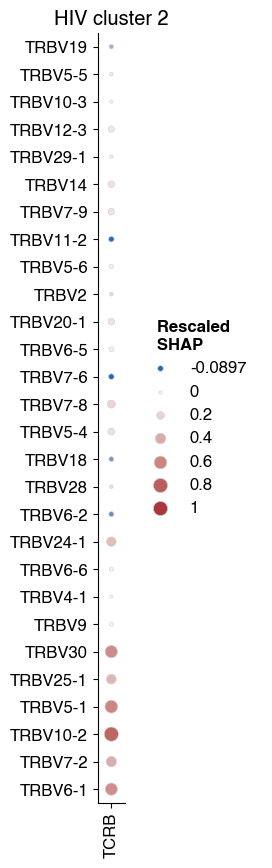

---

## Healthy/Background, GeneLocus.TCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:14:15.082642"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:14:15.738539"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:14:15.740995"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:14:15.743318"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:14:15.745375"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:14:15.747360"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:14:15.749848"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:14:15.751267"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:15.754221"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:15.756162"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:15.777693"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:15.808972"}


3


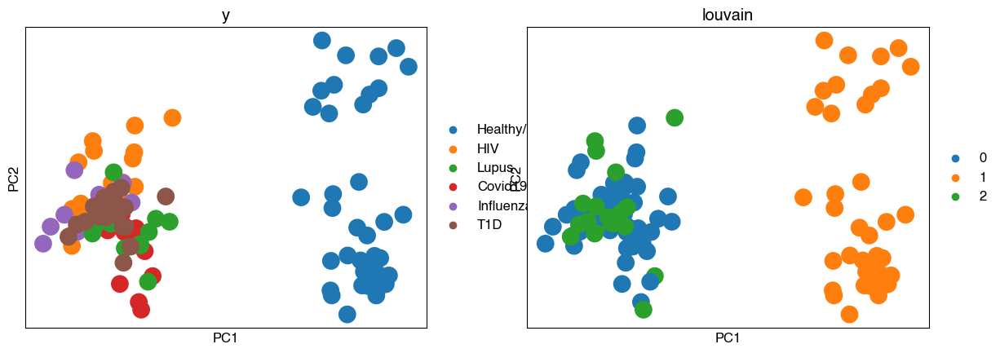

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:15.989681"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:16.010507"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:16.025673"}


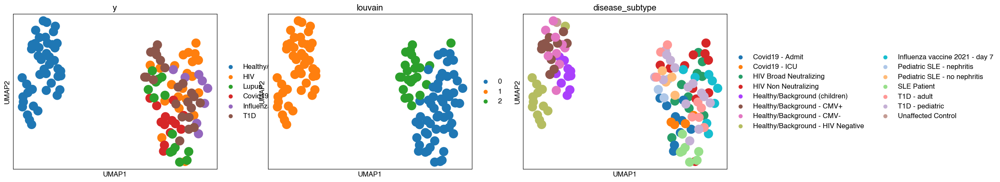

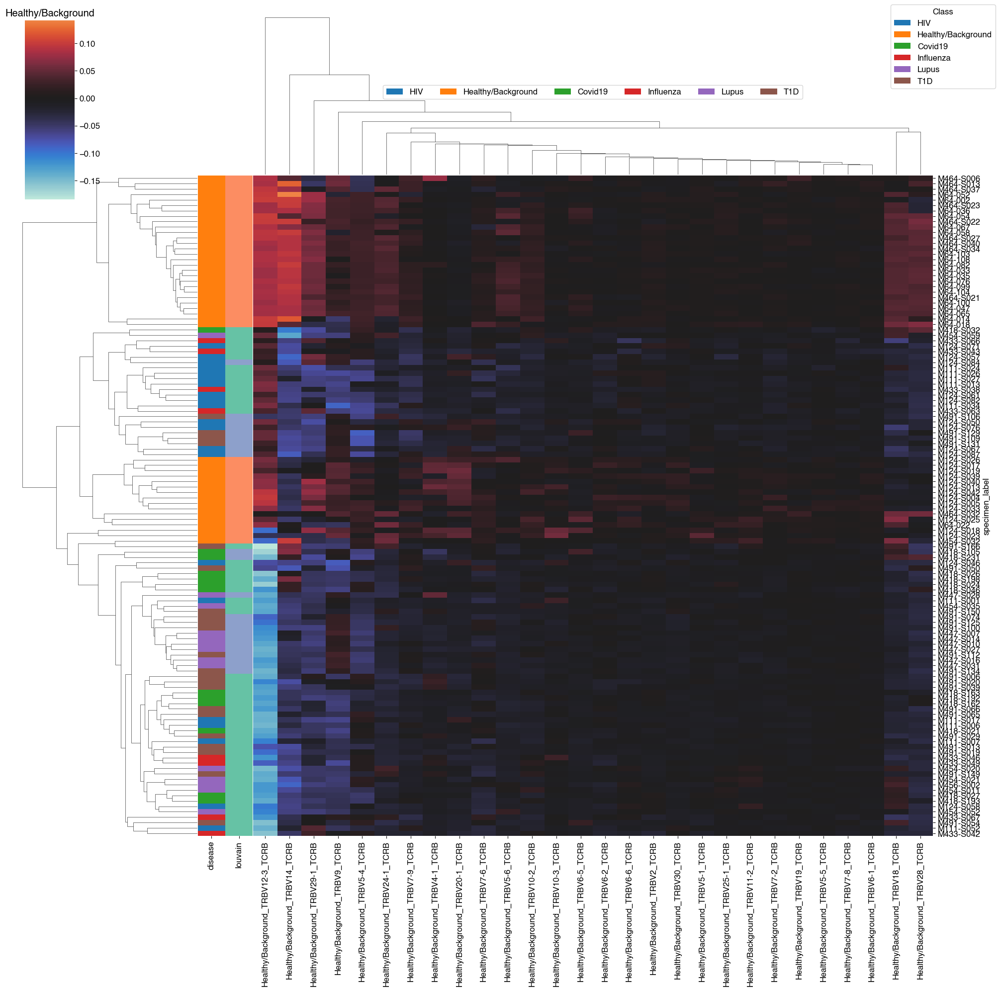

{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:19.516920"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:19.519624"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:19.537512"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:19.563150"}


44 3
0    22
1    14
2     8
Name: louvain, dtype: int64


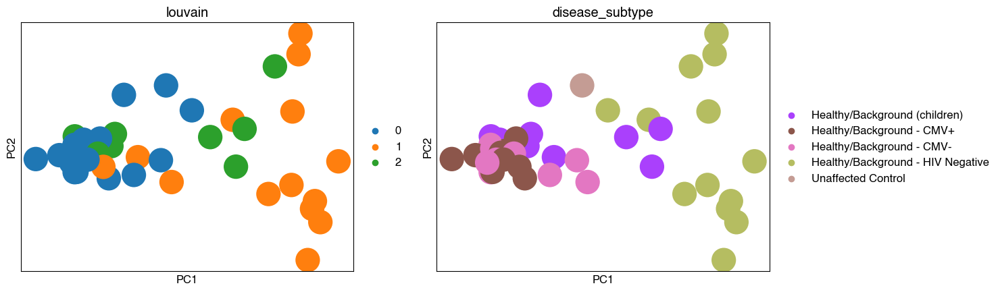

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:19.733171"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:19.752030"}


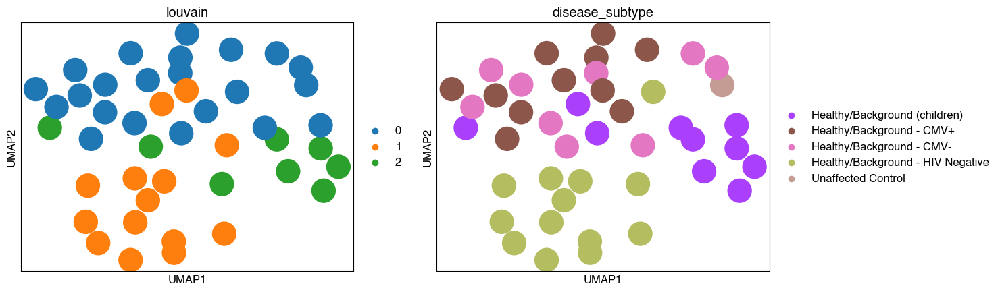

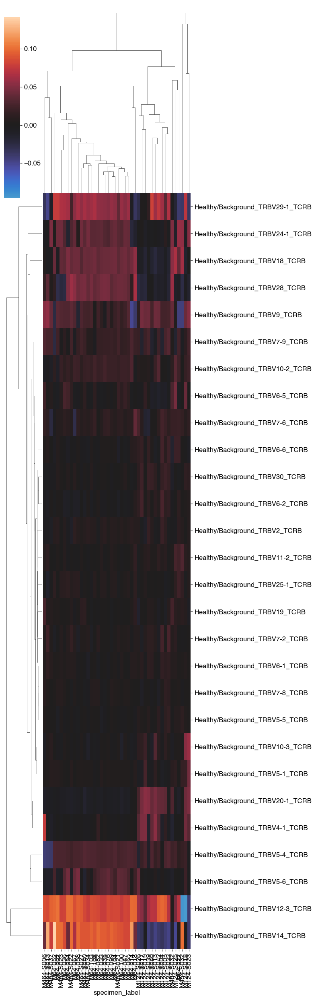

disease_subtype                    louvain
Healthy/Background (children)      2          0.600000
                                   0          0.300000
                                   1          0.100000
Healthy/Background - CMV+          0          0.909091
                                   1          0.090909
                                   2          0.000000
Healthy/Background - CMV-          0          0.777778
                                   1          0.111111
                                   2          0.111111
Healthy/Background - HIV Negative  1          0.846154
                                   0          0.076923
                                   2          0.076923
Unaffected Control                 0          1.000000
                                   1          0.000000
                                   2          0.000000
Name: louvain, dtype: float64

louvain  disease_subtype                  
0        Healthy/Background - CMV+            0.454545
         Healthy/Background - CMV-            0.318182
         Healthy/Background (children)        0.136364
         Healthy/Background - HIV Negative    0.045455
         Unaffected Control                   0.045455
1        Healthy/Background - HIV Negative    0.785714
         Healthy/Background (children)        0.071429
         Healthy/Background - CMV+            0.071429
         Healthy/Background - CMV-            0.071429
         Unaffected Control                   0.000000
2        Healthy/Background (children)        0.750000
         Healthy/Background - CMV-            0.125000
         Healthy/Background - HIV Negative    0.125000
         Healthy/Background - CMV+            0.000000
         Unaffected Control                   0.000000
Name: disease_subtype, dtype: float64

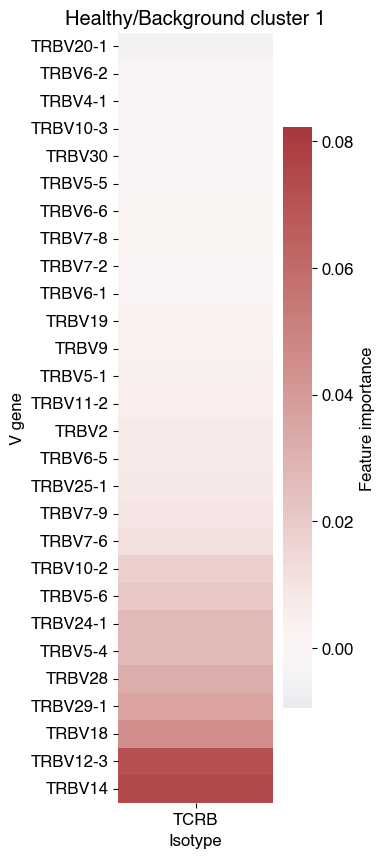

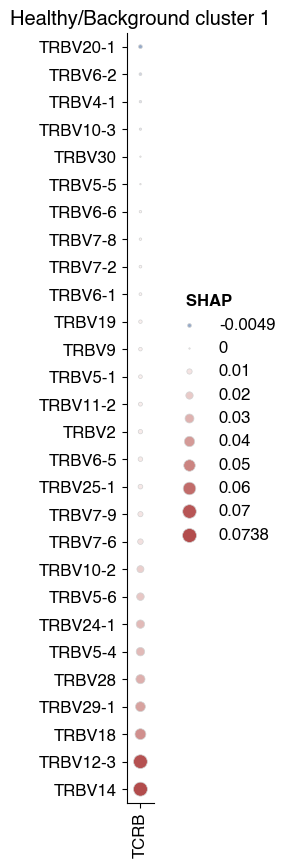

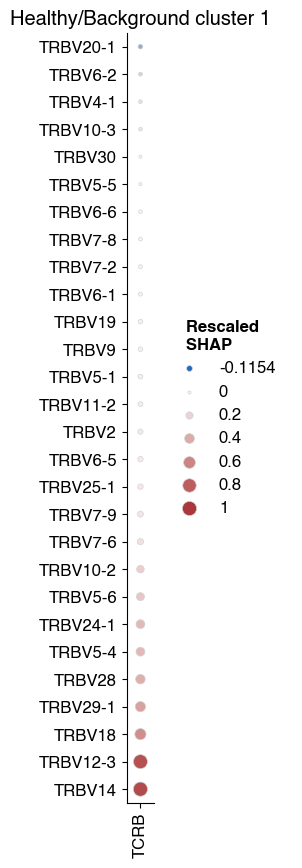

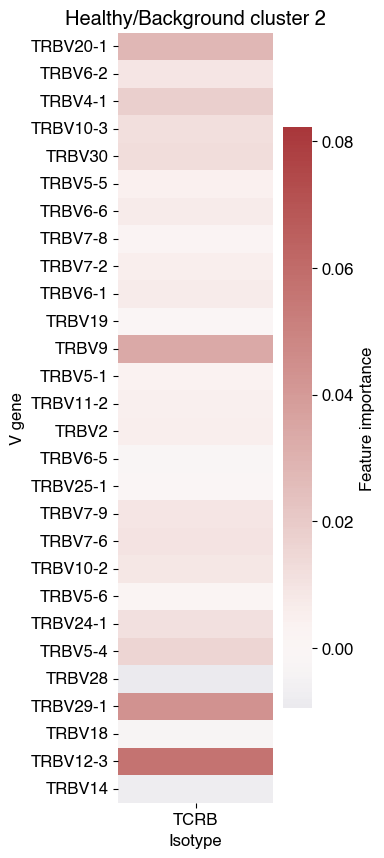

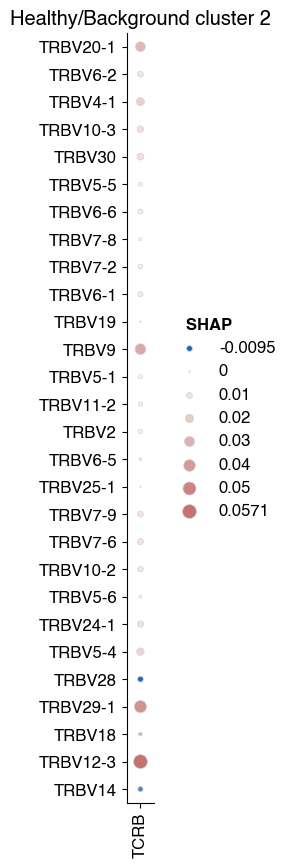

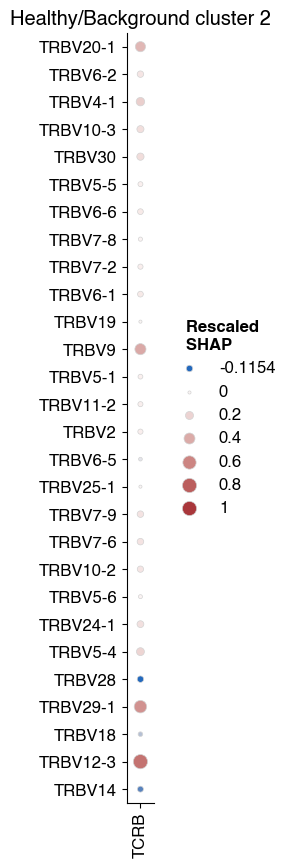

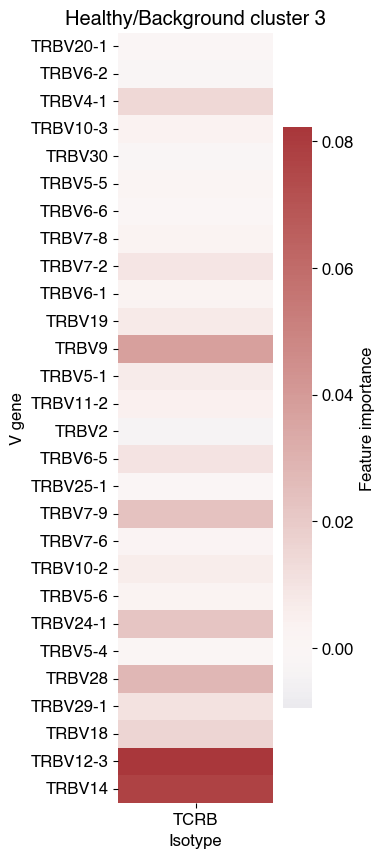

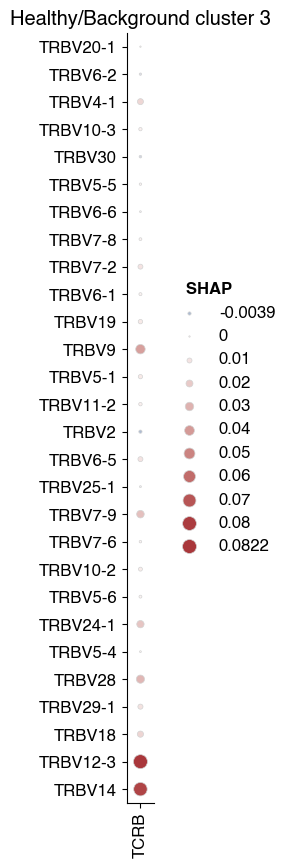

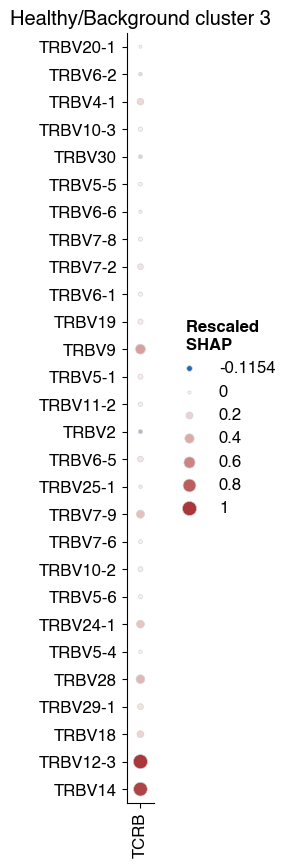

---

## Covid19, GeneLocus.TCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:14:25.957177"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:14:26.699954"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:14:26.701405"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:14:26.702691"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:14:26.703983"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:14:26.705059"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:14:26.706535"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:14:26.707647"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:26.708748"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:26.710052"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:26.722027"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:26.740442"}


4


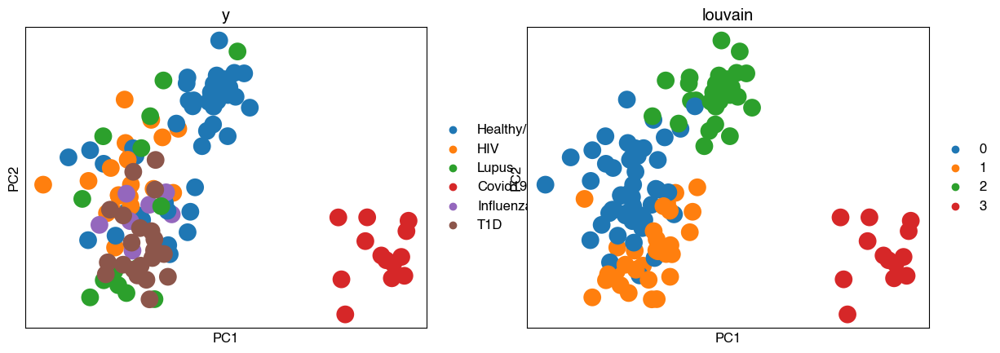

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:26.888211"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:26.908243"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:26.925819"}


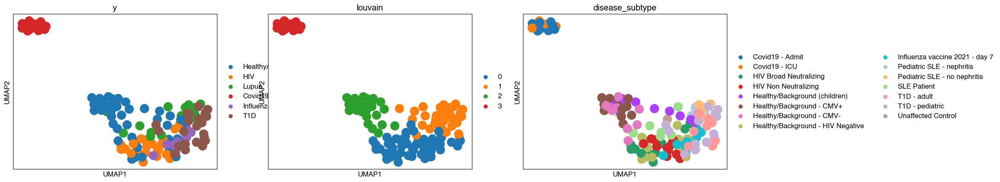

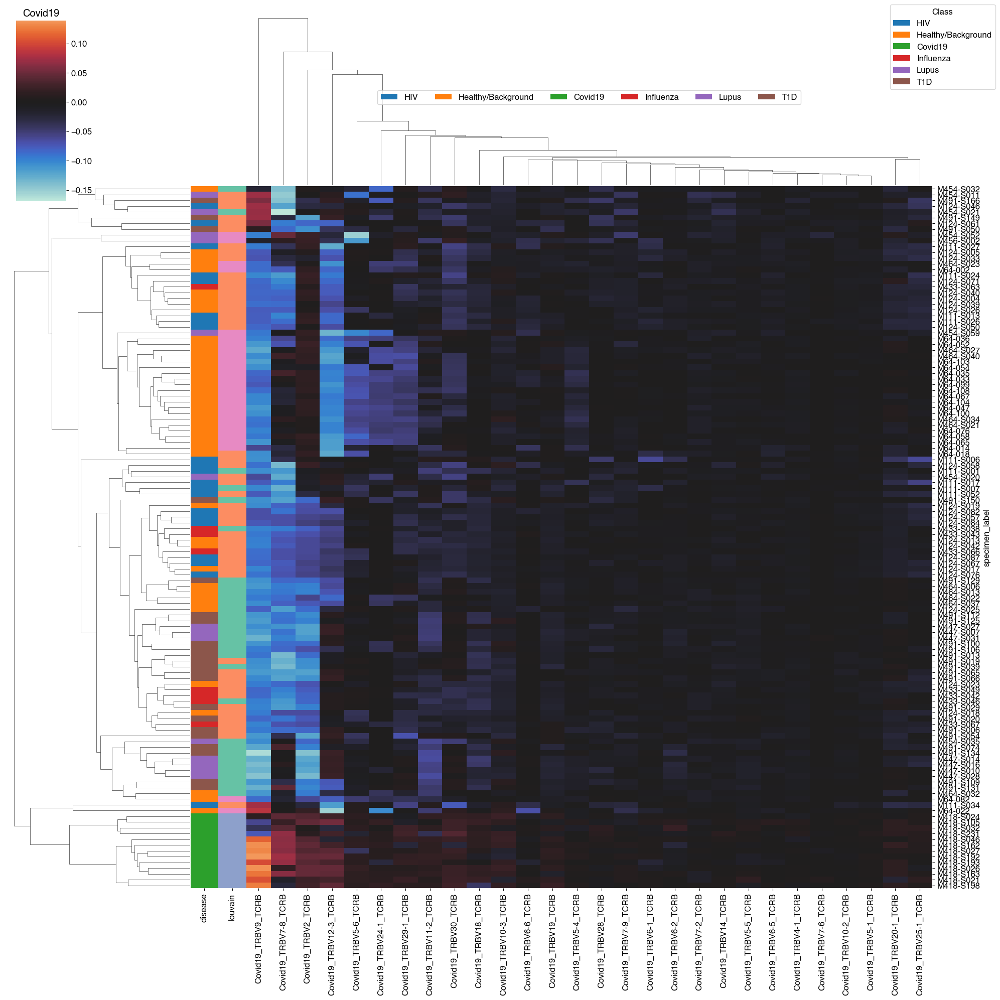

{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:30.315765"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:30.318136"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:30.330545"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:30.347959"}


13 2
0    7
1    6
Name: louvain, dtype: int64


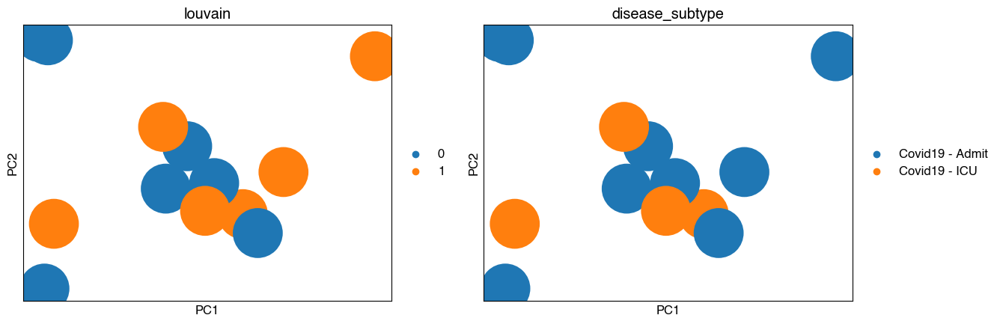

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:30.444654"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:30.460171"}


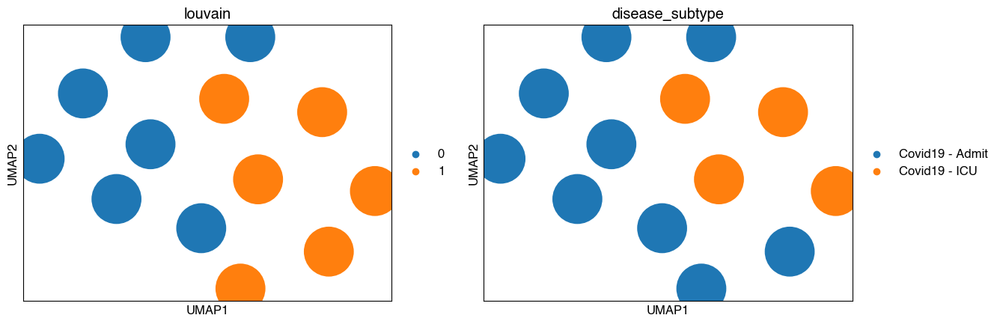

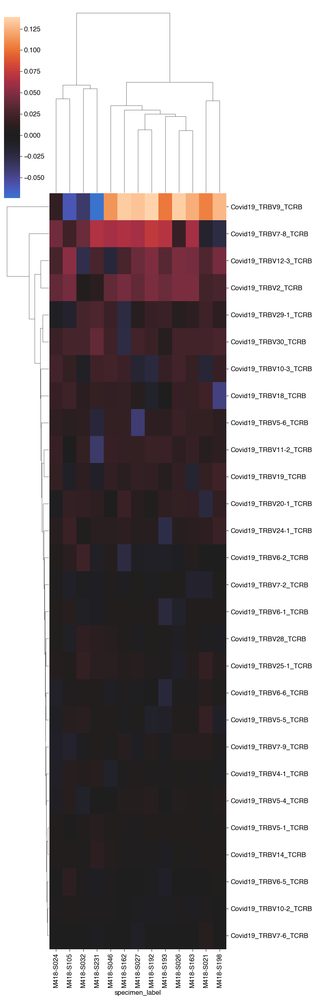

disease_subtype  louvain
Covid19 - Admit  0          0.777778
                 1          0.222222
Covid19 - ICU    1          1.000000
                 0          0.000000
Name: louvain, dtype: float64

louvain  disease_subtype
0        Covid19 - Admit    1.000000
         Covid19 - ICU      0.000000
1        Covid19 - ICU      0.666667
         Covid19 - Admit    0.333333
Name: disease_subtype, dtype: float64

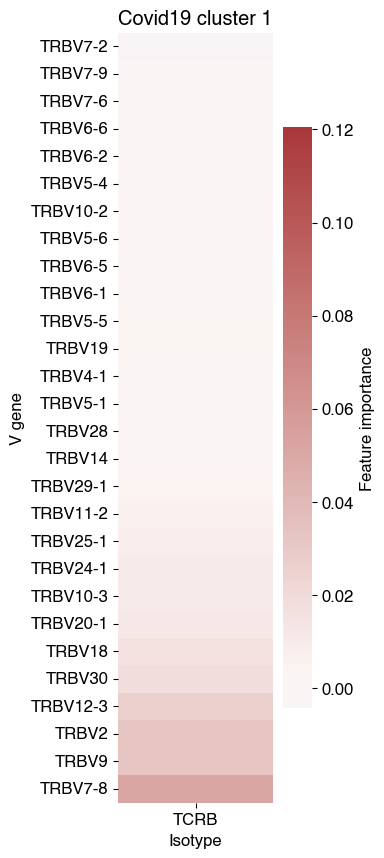

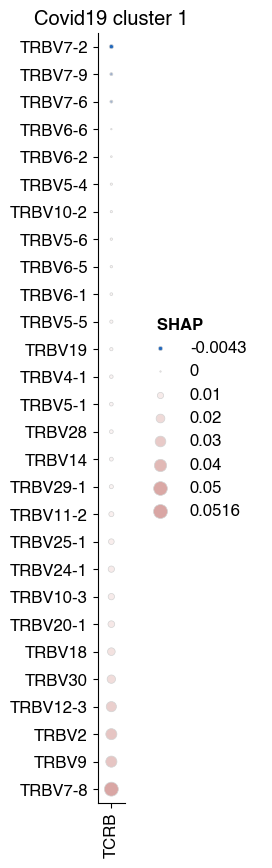

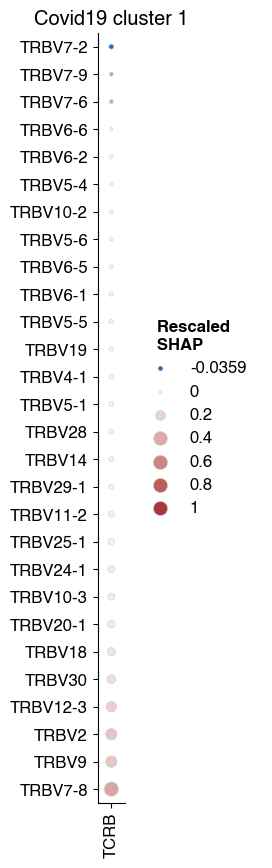

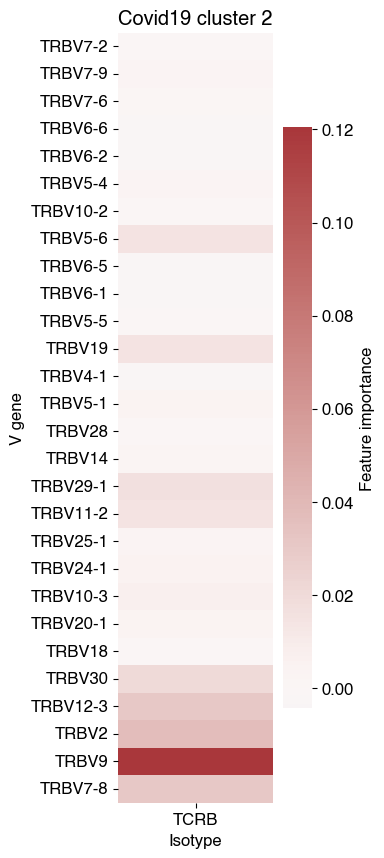

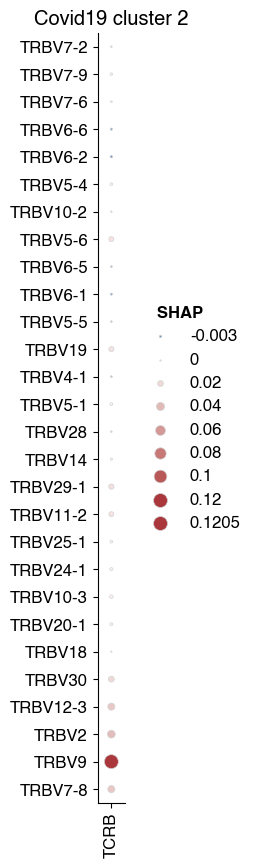

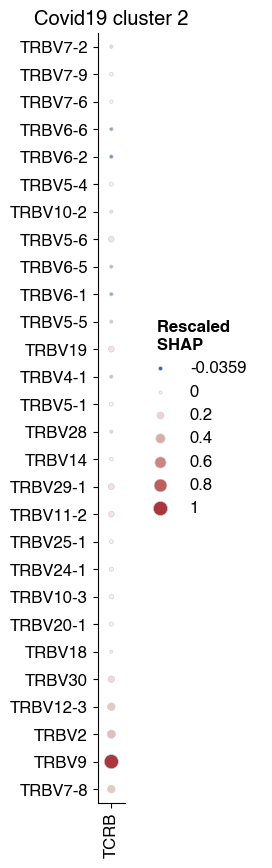

---

## Influenza, GeneLocus.TCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:14:34.927820"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:14:35.648485"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:14:35.651470"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:14:35.652999"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:14:35.654945"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:14:35.656393"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:14:35.659038"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:14:35.660655"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:35.662683"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:35.665323"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:35.684581"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:35.718353"}


5


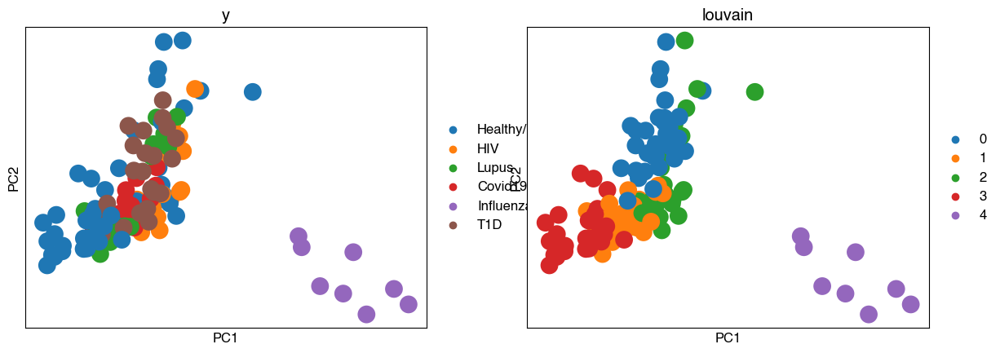

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:35.928929"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:35.953080"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:35.978224"}


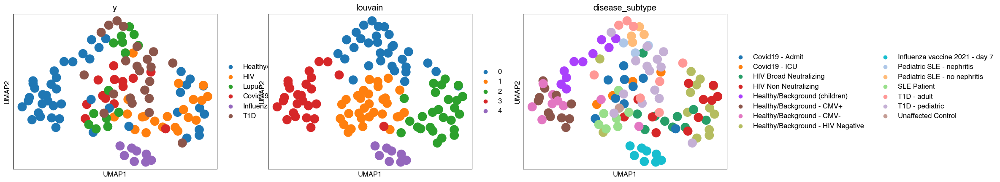

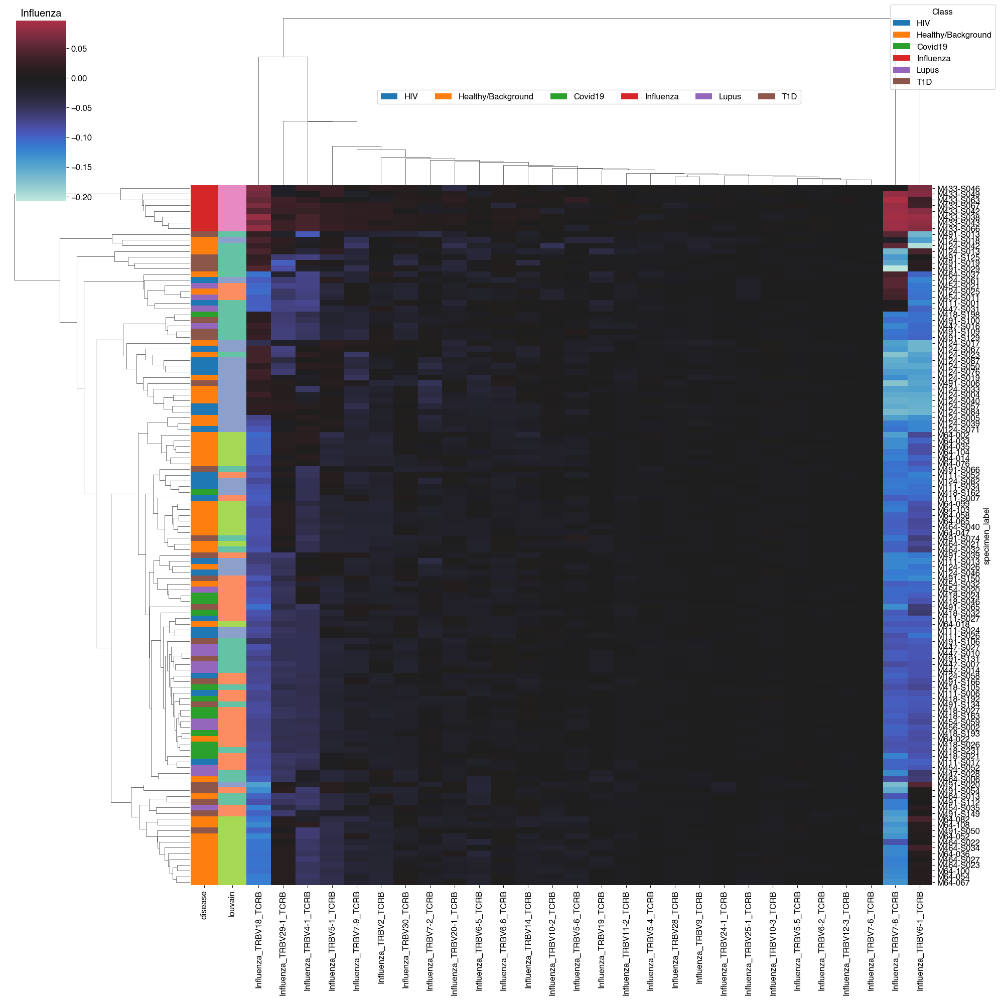

{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:39.599033"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:39.601240"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:39.613864"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:39.631500"}


8 2
0    5
1    3
Name: louvain, dtype: int64


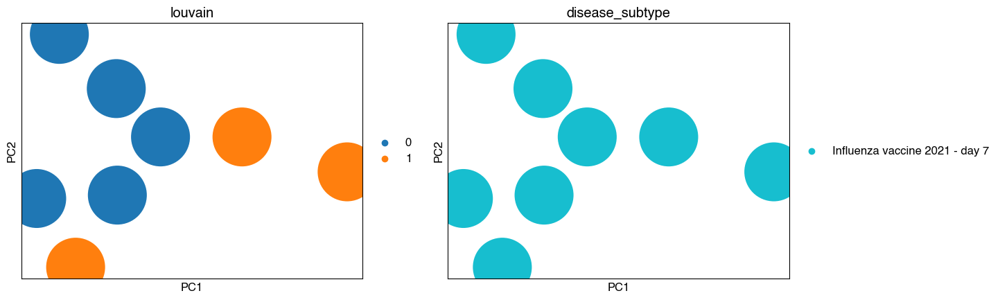

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:39.722145"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:39.736199"}


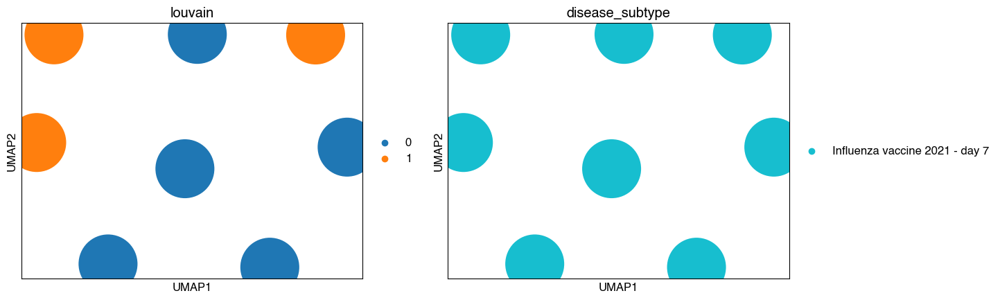

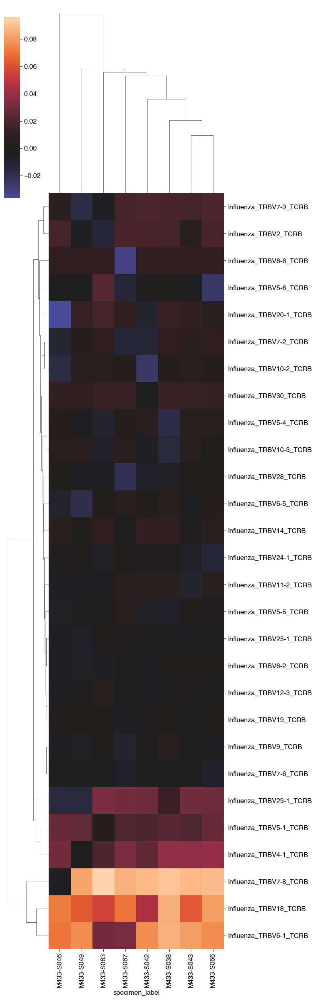

disease_subtype                 louvain
Influenza vaccine 2021 - day 7  0          0.625
                                1          0.375
Name: louvain, dtype: float64

louvain  disease_subtype               
0        Influenza vaccine 2021 - day 7    1.0
1        Influenza vaccine 2021 - day 7    1.0
Name: disease_subtype, dtype: float64

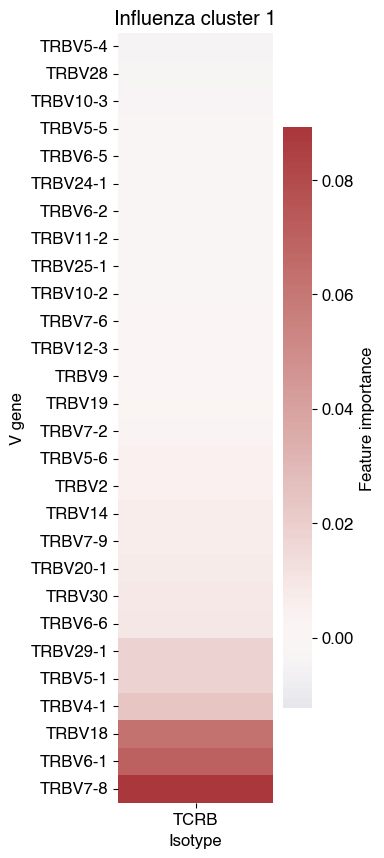

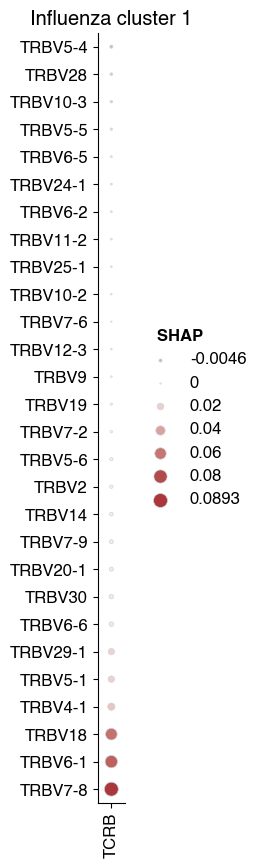

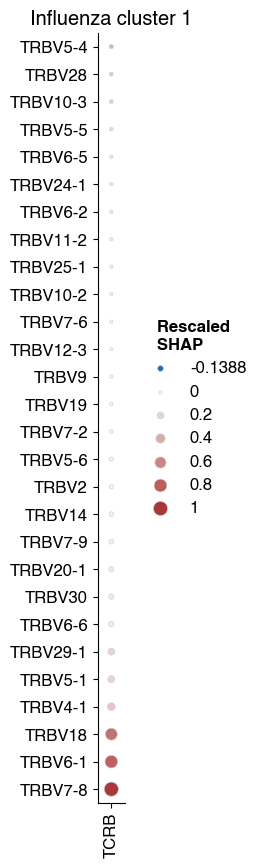

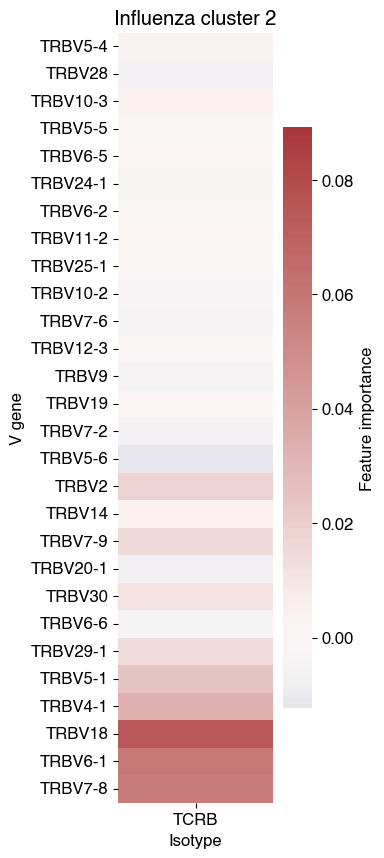

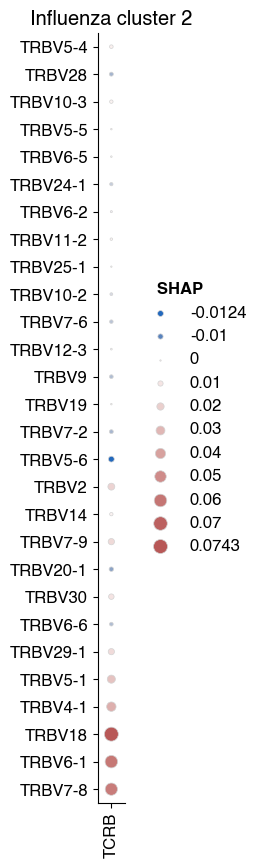

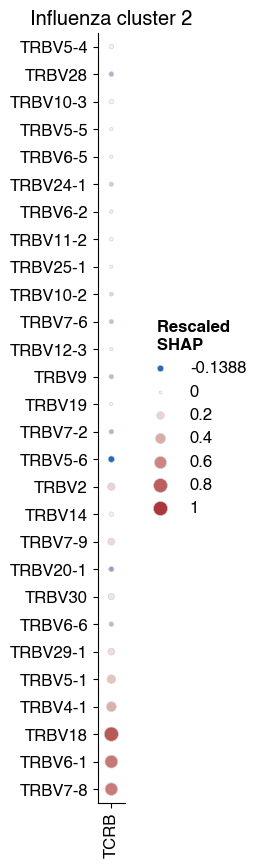

---

## Lupus, GeneLocus.TCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:14:43.606613"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:14:44.991083"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:14:44.993488"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:14:44.995195"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:14:44.996528"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:14:44.997640"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:14:44.999208"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:14:45.000312"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:45.001431"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:45.002579"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:45.016698"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:45.040308"}


5


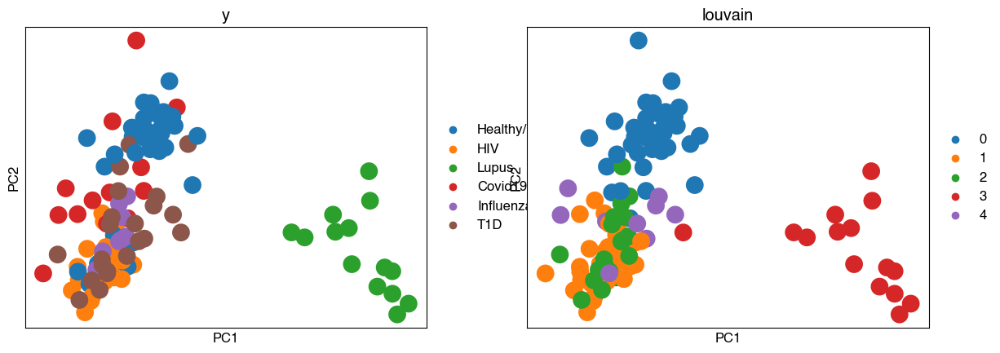

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:45.199022"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:45.220374"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:45.237728"}


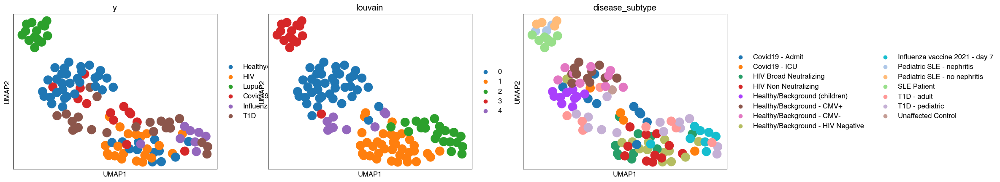

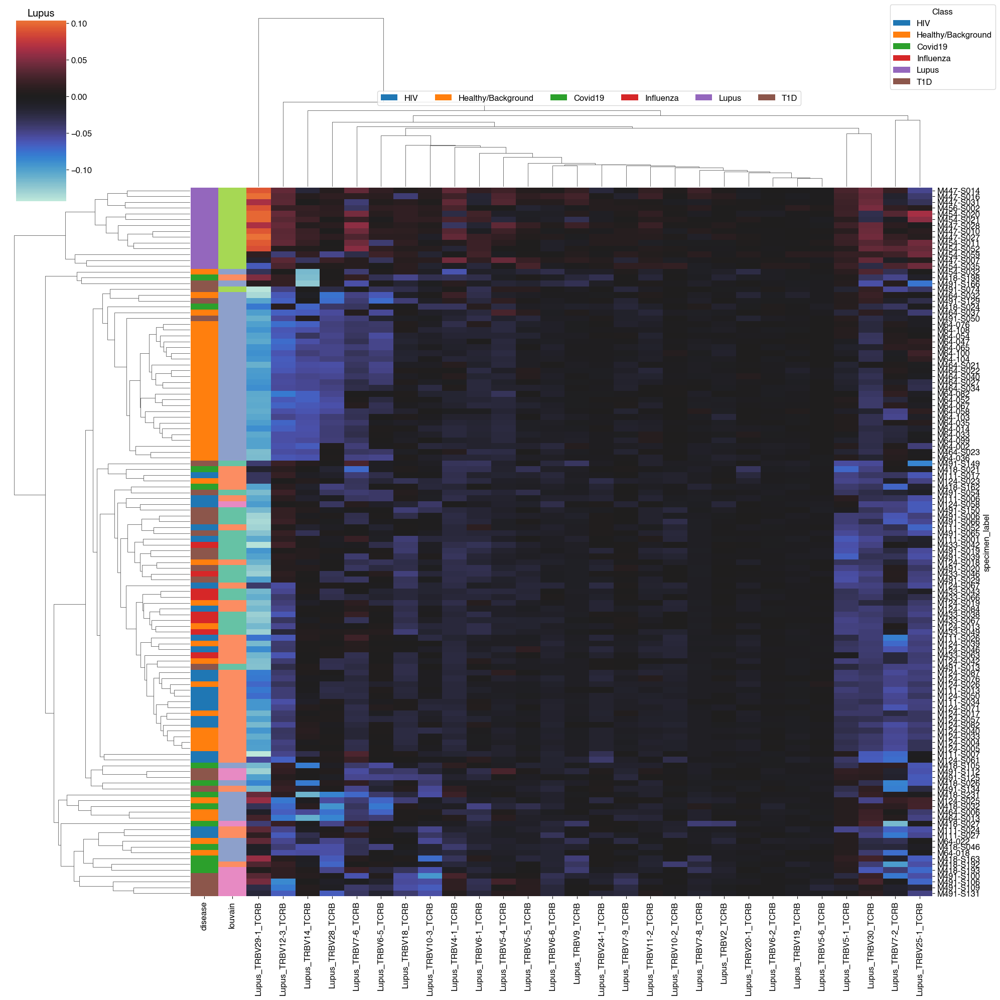

{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:48.967877"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:48.970982"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:48.986250"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:49.003311"}


14 2
0    8
1    6
Name: louvain, dtype: int64


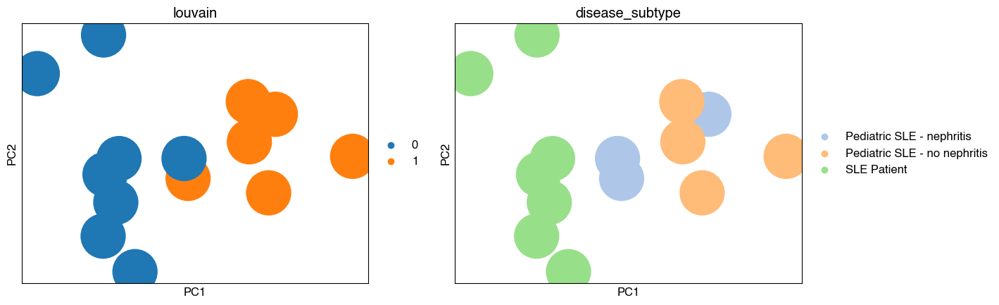

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:49.123699"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:49.142535"}


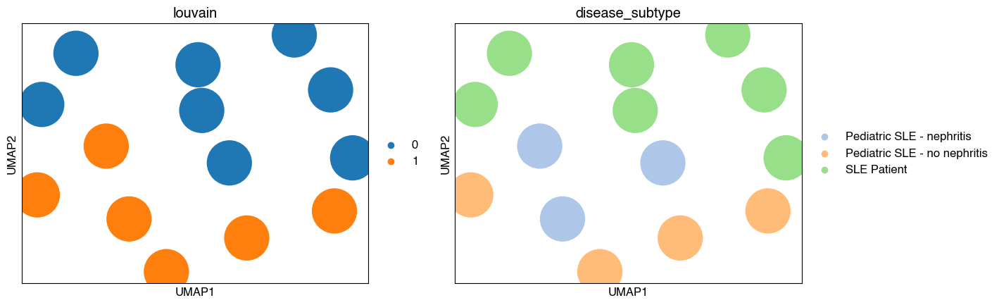

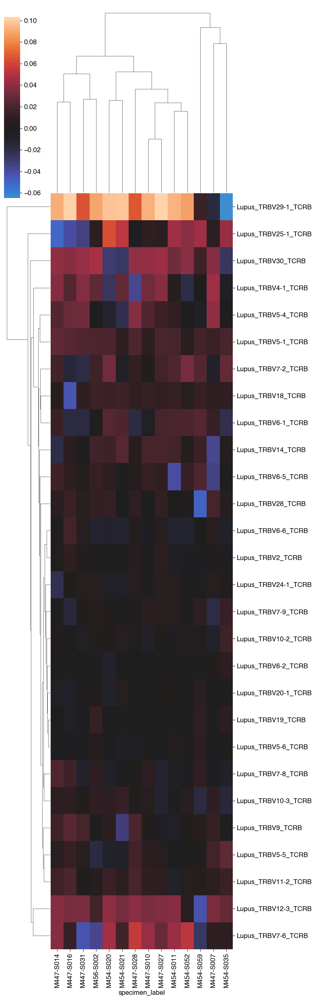

disease_subtype               louvain
Pediatric SLE - nephritis     1          0.666667
                              0          0.333333
Pediatric SLE - no nephritis  1          1.000000
                              0          0.000000
SLE Patient                   0          1.000000
                              1          0.000000
Name: louvain, dtype: float64

louvain  disease_subtype             
0        SLE Patient                     0.875000
         Pediatric SLE - nephritis       0.125000
         Pediatric SLE - no nephritis    0.000000
1        Pediatric SLE - no nephritis    0.666667
         Pediatric SLE - nephritis       0.333333
         SLE Patient                     0.000000
Name: disease_subtype, dtype: float64

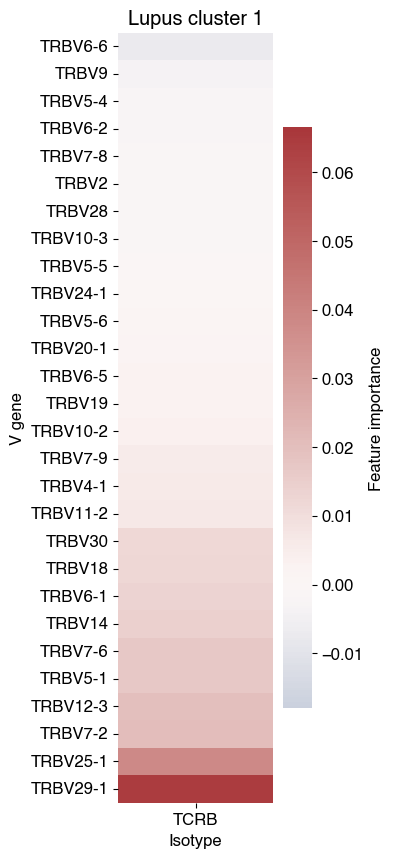

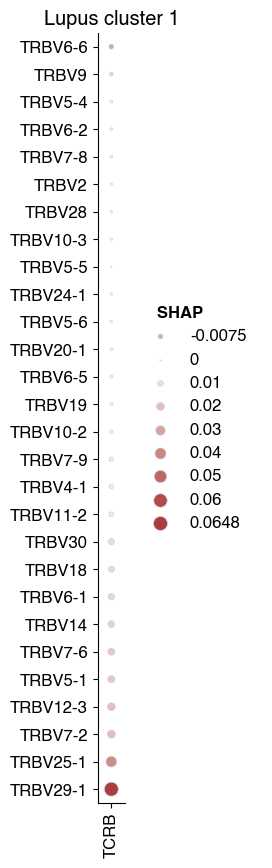

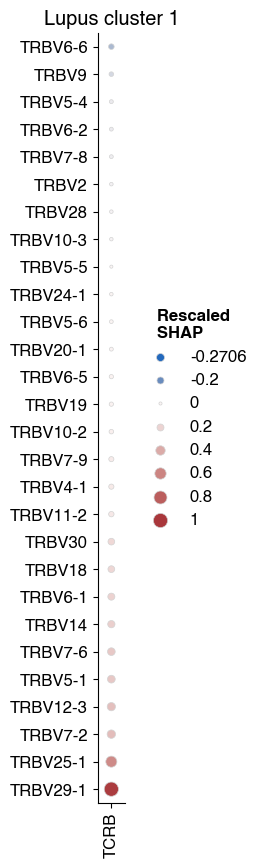

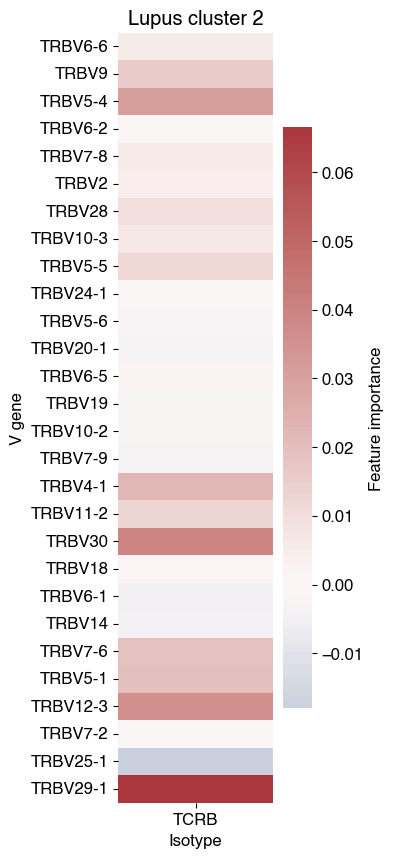

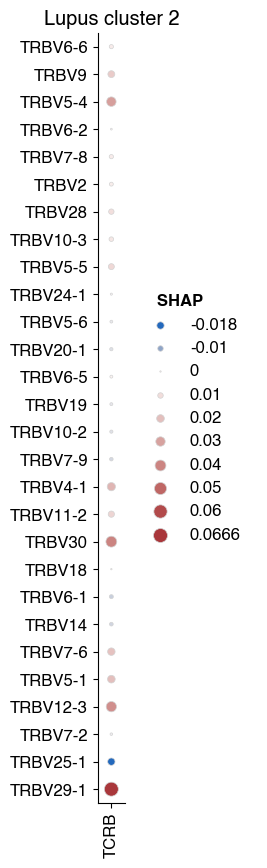

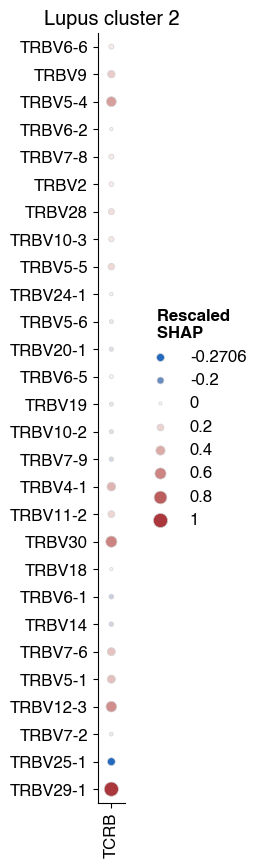

---

## T1D, GeneLocus.TCR

{"message": "X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.\n", "time": "2024-08-10T03:14:53.081511"}


{"message": "... storing 'disease.rollup' as categorical", "time": "2024-08-10T03:14:54.342619"}


{"message": "... storing 'disease.separate_past_exposures' as categorical", "time": "2024-08-10T03:14:54.344759"}


{"message": "... storing 'disease_severity' as categorical", "time": "2024-08-10T03:14:54.346135"}


{"message": "... storing 'disease_subtype' as categorical", "time": "2024-08-10T03:14:54.347358"}


{"message": "... storing 'ethnicity_condensed' as categorical", "time": "2024-08-10T03:14:54.348223"}


{"message": "... storing 'participant_label' as categorical", "time": "2024-08-10T03:14:54.349685"}


{"message": "... storing 'study_name' as categorical", "time": "2024-08-10T03:14:54.350693"}


{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:54.351700"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:54.352944"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:54.365068"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:54.383452"}


4


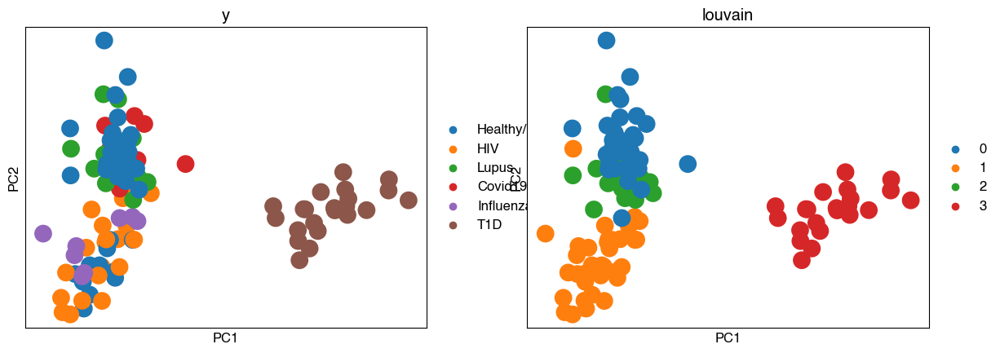

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:54.533745"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:54.556064"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:54.576416"}


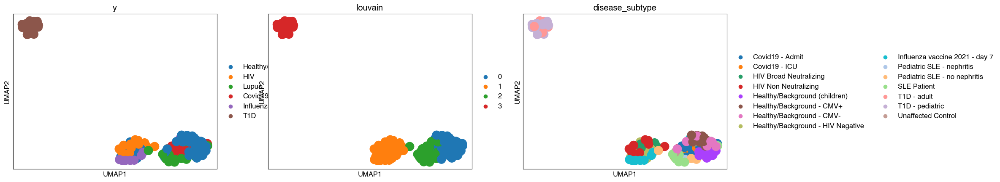

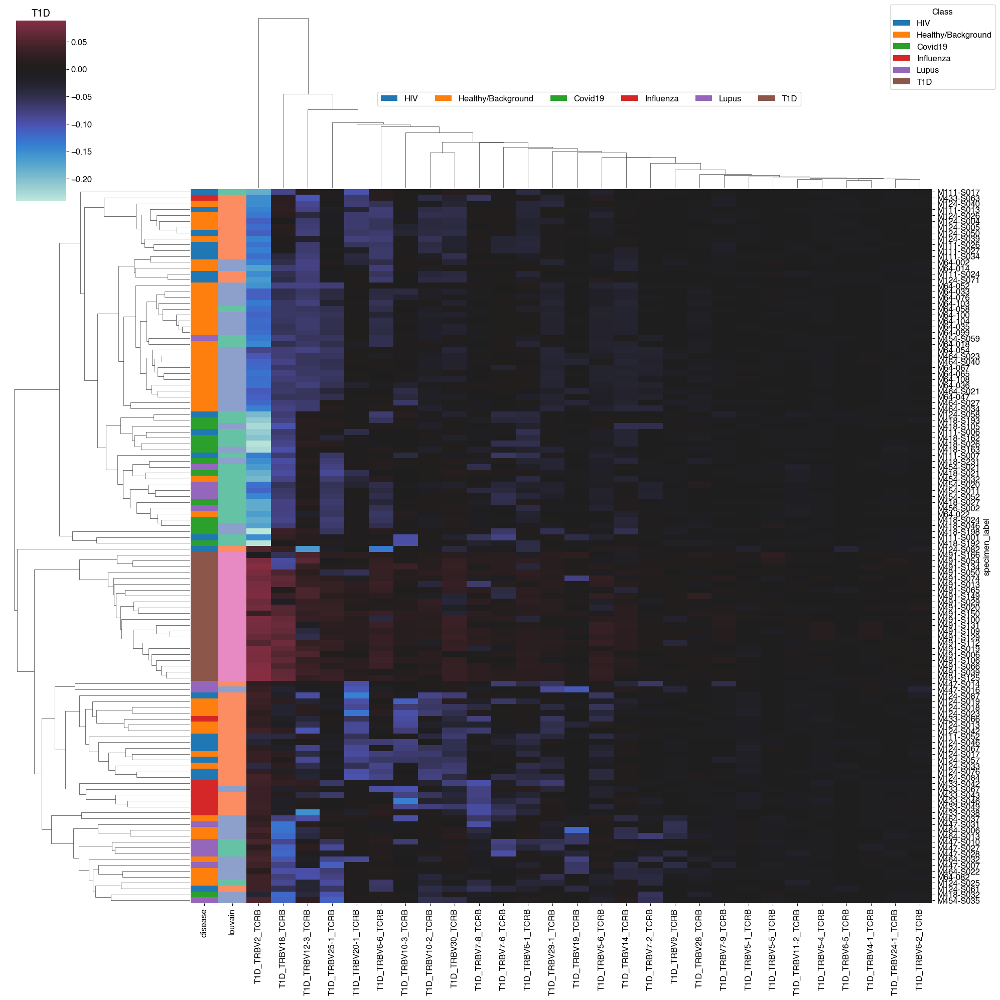

{"message": "... storing 'class_name' as categorical", "time": "2024-08-10T03:14:58.098861"}


{"message": "... storing 'isotype_supergroup' as categorical", "time": "2024-08-10T03:14:58.101514"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:58.118204"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:58.139763"}


22 2
0    14
1     8
Name: louvain, dtype: int64


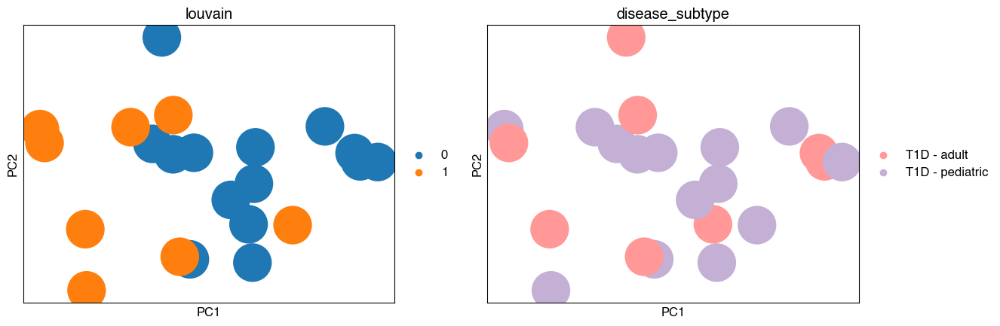

{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:58.262635"}


{"message": "No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored\n", "time": "2024-08-10T03:14:58.279013"}


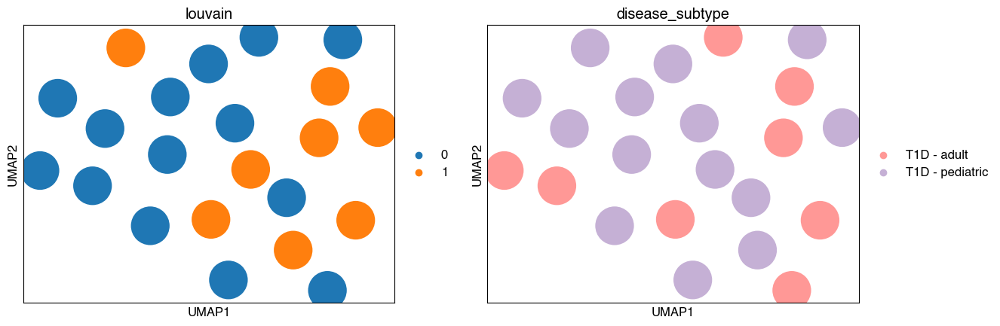

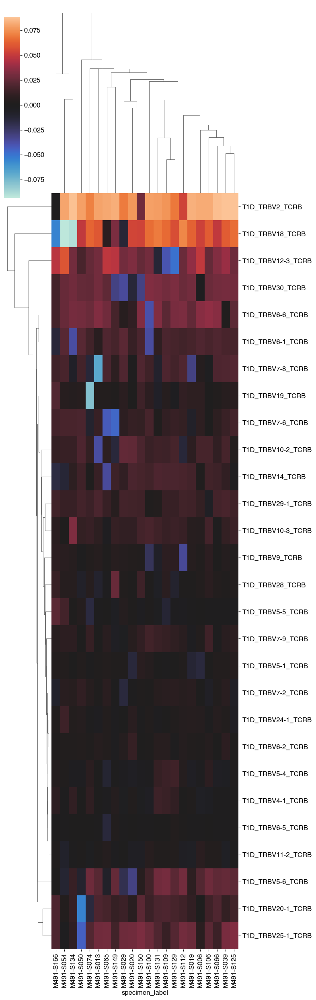

disease_subtype  louvain
T1D - adult      0          0.500000
                 1          0.500000
T1D - pediatric  0          0.714286
                 1          0.285714
Name: louvain, dtype: float64

louvain  disease_subtype
0        T1D - pediatric    0.714286
         T1D - adult        0.285714
1        T1D - adult        0.500000
         T1D - pediatric    0.500000
Name: disease_subtype, dtype: float64

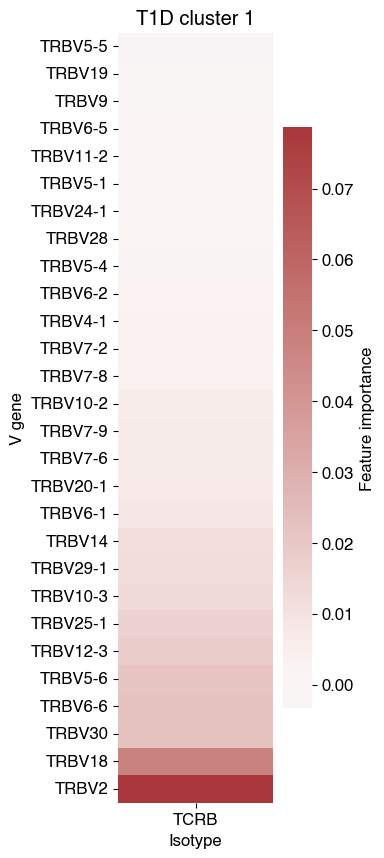

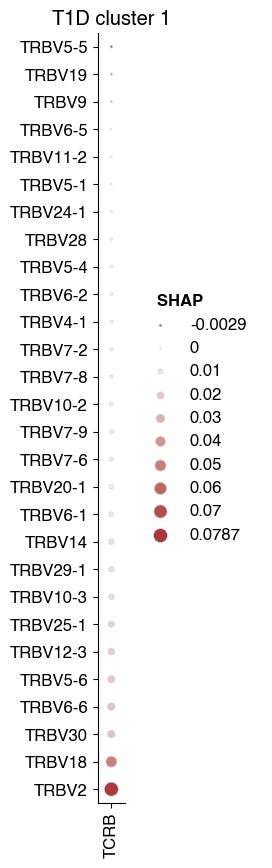

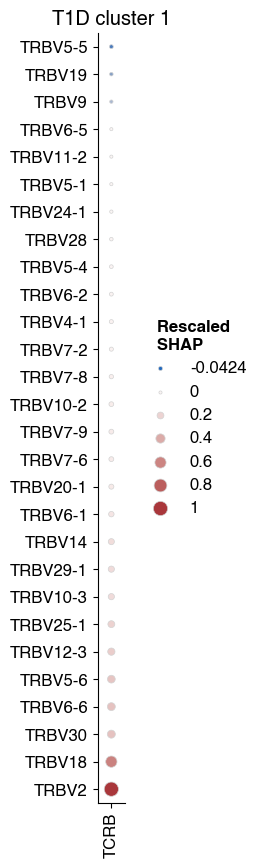

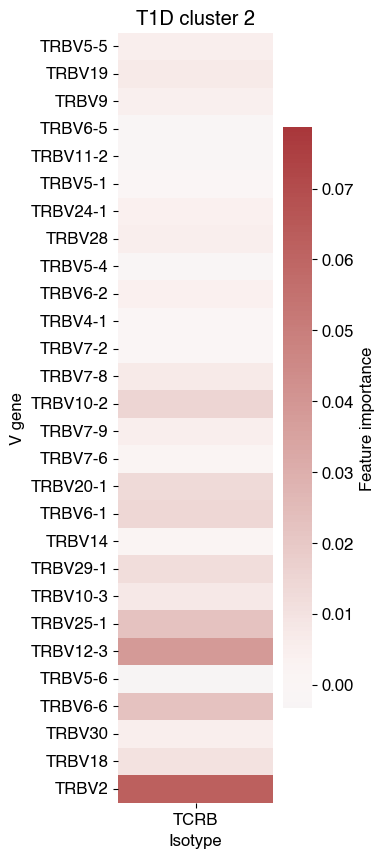

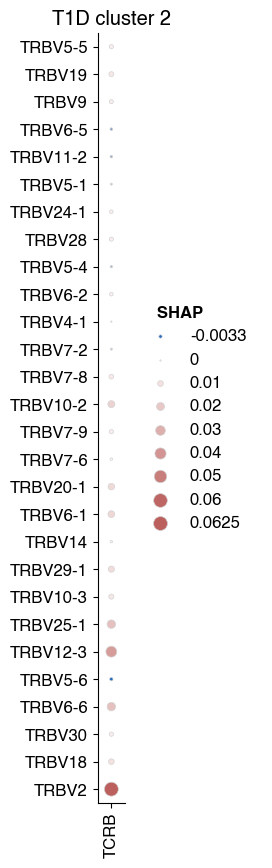

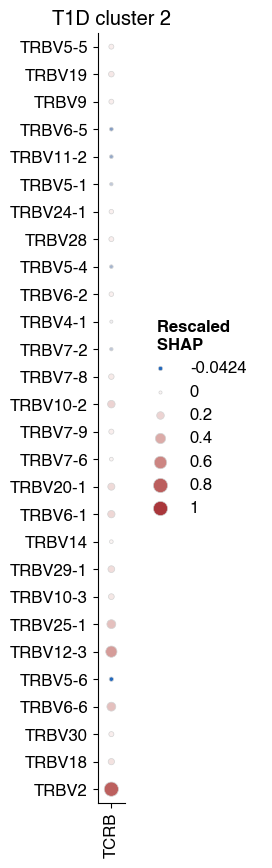

In [9]:
for gene_locus in config.gene_loci_used:
    display(Markdown(f"# {gene_locus}"))

    raw_feature_importances_per_example_by_class = (
        raw_feature_importances_per_example_by_class_per_locus[gene_locus]
    )
    (
        clf_pipeline_output_base_dir,
        highres_output_base_dir,
        output_filename_prefix,
    ) = fname_parts_per_locus[gene_locus]

    def _mkfname(positive_class: str, suffix: str) -> Path:
        return Path(
            f"{output_filename_prefix}.average_over_positives.{slugify(positive_class)}{suffix}"
        )

    # Example count per class
    print(
        raw_feature_importances_per_example_by_class[
            next(iter(raw_feature_importances_per_example_by_class))
        ][1].value_counts()
    )

    positive_classes = raw_feature_importances_per_example_by_class[
        next(iter(raw_feature_importances_per_example_by_class))
    ][1].unique()

    for positive_class in positive_classes:
        display(Markdown("---"))
        display(Markdown(f"## {positive_class}, {gene_locus}"))

        # Don't subset to positive examples only. The negatives/positives should naturally separate in the clustering.
        adata_shap = anndata.AnnData(
            # Raw SHAP values
            X=raw_feature_importances_per_example_by_class[positive_class][0],
            # Metadata
            obs=raw_feature_importances_per_example_by_class[positive_class][2].assign(
                # Ground truth labels
                y=raw_feature_importances_per_example_by_class[positive_class][1]
            ),
        )
        # Merge in column map
        adata_shap.var = raw_feature_importances_per_example_by_class[positive_class][
            3
        ].loc[adata_shap.var_names]

        # Rename v_gene
        adata_shap.var["v_gene"] = adata_shap.var["v_gene"].replace(
            helpers.v_gene_friendly_names
        )

        adata_shap.raw = adata_shap
        sc.pp.scale(adata_shap)
        # Drop any columns that are NaN after scaling:
        # If a column has the same value in all rows before scaling, it will have NaN standard deviation, and NaN value post-scaling
        adata_shap = adata_shap[:, adata_shap.var["std"].notna()]
        sc.pp.pca(adata_shap)
        sc.pp.neighbors(adata_shap)
        sc.tl.umap(adata_shap)
        sc.tl.louvain(adata_shap, resolution=1)
        print(adata_shap.obs["louvain"].nunique())
        sc.pl.pca(adata_shap, color=["y", "louvain"])
        sc.pl.umap(adata_shap, color=["y", "louvain", "disease_subtype"])

        ###

        row_colors_palette = dict(
            zip(
                raw_feature_importances_per_example_by_class[positive_class][
                    1
                ].unique(),
                sns.color_palette(),
            )
        )

        clusters_palette = dict(
            zip(adata_shap.obs["louvain"].unique(), sns.color_palette("Set2"))
        )
        row_colors = (
            raw_feature_importances_per_example_by_class[positive_class][1]
            .astype(str)  # convert from category
            .map(row_colors_palette)
        )
        cluster_colors = adata_shap.obs["louvain"].astype(str).map(clusters_palette)

        g = sns.clustermap(
            raw_feature_importances_per_example_by_class[positive_class][0],
            center=0,
            # row_colors=row_colors,
            # Add additional row colors entry based on cluster, to see if clustering will separate positive classes
            # https://stackoverflow.com/a/58520672/130164
            row_colors=pd.concat([row_colors, cluster_colors], axis=1),
            yticklabels=True,
            xticklabels=True,
            figsize=(20, 20),
            linewidths=0,
        )

        # https://stackoverflow.com/a/27992943/130164
        for label in row_colors_palette:
            g.ax_col_dendrogram.bar(
                0, 0, color=row_colors_palette[label], label=label, linewidth=0
            )
        g.ax_col_dendrogram.legend(loc="center", ncol=6)

        # Alternative:
        # https://stackoverflow.com/a/62475411/130164
        from matplotlib.patches import Patch

        handles = [
            Patch(facecolor=row_colors_palette[name]) for name in row_colors_palette
        ]
        plt.legend(
            handles,
            row_colors_palette,
            title="Class",
            bbox_to_anchor=(1, 1),
            bbox_transform=plt.gcf().transFigure,
            loc="upper right",
        )

        plt.title(positive_class)
        display(g.fig)
        fig_fname = _mkfname(positive_class, f".raw_shap_clustermap.all.png")
        genetools.plots.savefig(g.fig, highres_output_base_dir / fig_fname, dpi=300)
        plt.close(g.fig)

        ###

        # Subset to positive examples
        adata_shap_subset = adata_shap[adata_shap.obs["y"] == positive_class]
        adata_shap_subset = adata_shap_subset.raw.to_adata()
        adata_shap_subset.raw = adata_shap_subset
        sc.pp.scale(adata_shap_subset)
        # Drop any columns that are NaN after scaling:
        # If a column has the same value in all rows before scaling, it will have NaN standard deviation, and NaN value post-scaling
        adata_shap_subset = adata_shap_subset[:, adata_shap_subset.var["std"].notna()]
        sc.pp.pca(adata_shap_subset)
        sc.pp.neighbors(adata_shap_subset)
        sc.tl.umap(adata_shap_subset)
        sc.tl.louvain(adata_shap_subset, resolution=1)
        print(adata_shap_subset.shape[0], adata_shap_subset.obs["louvain"].nunique())
        print(adata_shap_subset.obs["louvain"].value_counts())
        sc.pl.pca(adata_shap_subset, color=["louvain", "disease_subtype"])
        sc.pl.umap(adata_shap_subset, color=["louvain", "disease_subtype"])

        ###

        vals_filtered = raw_feature_importances_per_example_by_class[positive_class][0]
        vals_filtered = vals_filtered[
            raw_feature_importances_per_example_by_class[positive_class][1]
            == positive_class
        ]
        g = sns.clustermap(
            vals_filtered.T,
            center=0,
            yticklabels=True,
            xticklabels=True,
            figsize=(8, 25),
        )
        display(g.fig)
        fig_fname = _mkfname(
            positive_class, f".raw_shap_clustermap.filtered_to_positives.png"
        )
        genetools.plots.savefig(g.fig, highres_output_base_dir / fig_fname, dpi=300)
        plt.close(g.fig)

        ###

        display(
            adata_shap_subset.obs.groupby("disease_subtype")["louvain"].value_counts(
                normalize=True
            )
        )

        ###

        display(
            adata_shap_subset.obs.groupby("louvain")["disease_subtype"].value_counts(
                normalize=True
            )
        )

        ###

        # Within each cluster, take average of SHAP values, and plot heatmaps with aligned V gene orders:

        # We'll set consistent row and color order.
        row_order = None
        # vmin, vmax=adata_shap_subset.raw.X.min(), adata_shap_subset.raw.X.max()
        # Actually we should compute our vmin, vmax off of plot_df because we do averaging.

        plot_dfs = {
            # Cast string cluster_id to int
            int(cluster_id): (
                pd.merge(
                    # Take average per feature
                    mat.to_df().mean(axis=0).rename("Average SHAP"),
                    # Get feature name expansions
                    mat.var,
                    left_index=True,
                    right_index=True,
                    how="inner",
                    validate="1:1",
                )
                .pivot(
                    index="v_gene", columns="isotype_supergroup", values="Average SHAP"
                )
                .rename_axis(
                    index={"v_gene": "V gene"},
                    columns={"isotype_supergroup": "Isotype"},
                )
            )
            for cluster_id, mat in helpers.anndata_groupby_obs(
                adata_shap_subset.raw.to_adata(), "louvain"
            )
        }
        all_values = pd.concat(list(plot_dfs.values()), axis=0).to_numpy().ravel()
        vmin, vmax = all_values.min(), all_values.max()

        # Optionally: Normalize by dividing by global vmax. Keeps negatives.
        plot_dfs_rescaled = {k: v / vmax for k, v in plot_dfs.items()}
        all_values_rescaled = (
            pd.concat(list(plot_dfs_rescaled.values()), axis=0).to_numpy().ravel()
        )
        vmin_rescaled, vmax_rescaled = (
            all_values_rescaled.min(),
            all_values_rescaled.max(),
        )

        for cluster_id, plot_df in plot_dfs.items():
            if row_order is None:
                # If we haven't set row order yet, set it from the first cluster of examples
                if plot_df.shape[1] > 1:
                    # If BCR, clustermap the SHAP values
                    g = sns.clustermap(
                        plot_df,
                        yticklabels=True,  # Make all V gene labels visible
                        col_cluster=False,  # Reorder rows only
                        figsize=(2.5 * plot_df.shape[1], 10),
                        cbar_kws={"label": "Feature importance"},
                    )
                    # Extract row order:
                    row_order = g.dendrogram_row.data.index[
                        g.dendrogram_row.reordered_ind
                    ]
                    plt.close(g.fig)
                else:
                    # For TCR data, don’t use hierarchical clustering to order the SHAP values, since there’s only one column.
                    # Just order the rows from least to greatest value.
                    row_order = plot_df.sort_values(by=plot_df.columns[0]).index

            # Apply row order
            plot_df_ordered = plot_df.loc[row_order]

            # Choose whether we are using a sequential or diverging color palette
            center = 0 if vmin < 0 else None
            if center is not None:
                # Mimics logic in https://github.com/mwaskom/seaborn/blob/b95d6d1ce9dfed6970015d8bdad9068b5749868a/seaborn/matrix.py#L192
                # but with our personal choice of color palettes so that 0 value is light not dark
                cmap = sns.color_palette("vlag", as_cmap=True)
            else:
                cmap = sns.cm.rocket_r

            # Make heatmap
            fig = plt.figure(figsize=(2.5 * plot_df.shape[1], 10))
            sns.heatmap(
                plot_df_ordered,
                yticklabels=True,  # Make all V gene labels visible
                cbar_kws={"label": "Feature importance"},
                vmin=vmin,
                vmax=vmax,
                center=center,
                cmap=cmap,
            )
            # Change zero-indexed cluster IDs to one-indexed in title:
            plt.title(f"{positive_class} cluster {cluster_id+1}")
            display(fig)
            fig_fname = _mkfname(positive_class, f".cluster.{cluster_id+1}.heatmap.png")
            genetools.plots.savefig(fig, highres_output_base_dir / fig_fname, dpi=300)
            plt.close(fig)

            # Make dotplot instead
            # Melt. Goes from V genes x Isotypes matrix, to one row for each (V gene, Isotype, SHAP) entry
            data_melt = plot_df_ordered.melt(
                ignore_index=False,
                var_name="Isotype",
                value_name="Feature Impact (SHAP)",
            ).reset_index()

            # Rescale the SHAP values: convert global vmax to 1
            # (This will still keep negatives)
            data_melt["SHAP rescaled"] = data_melt["Feature Impact (SHAP)"] / vmax

            # Make dotplot with SHAP value encoded as both color and size
            # Two variants:
            # 1) Raw SHAP value
            fig, ax = genetools.plots.plot_color_and_size_dotplot(
                data=data_melt,
                x_axis_key="Isotype",
                y_axis_key="V gene",
                value_key="Feature Impact (SHAP)",
                color_cmap=cmap,
                color_and_size_vmin=vmin,
                color_and_size_vmax=vmax,
                color_and_size_vcenter=center,
                figsize=(5 * plot_df.shape[1], 10),
                legend_text="SHAP",
                grid=False,
            )
            sns.despine(ax=ax)
            # Change zero-indexed cluster IDs to one-indexed in title:
            ax.set_title(f"{positive_class} cluster {cluster_id+1}")
            display(fig)
            fig_fname = _mkfname(positive_class, f".cluster.{cluster_id+1}.dotplot.png")
            genetools.plots.savefig(fig, highres_output_base_dir / fig_fname, dpi=300)
            plt.close(fig)

            # 2) Scaled SHAP value, with consistent color map across all the plots
            fig, ax = genetools.plots.plot_color_and_size_dotplot(
                data=data_melt,
                x_axis_key="Isotype",
                y_axis_key="V gene",
                value_key="SHAP rescaled",
                color_cmap=cmap,
                color_and_size_vmin=vmin_rescaled,
                color_and_size_vmax=vmax_rescaled,
                color_and_size_vcenter=center,
                figsize=(5 * plot_df.shape[1], 10),
                legend_text="Rescaled\nSHAP",
                grid=False,
                # representative_values_for_legend=np.linspace(vmin_rescaled, vmax_rescaled, 5),
                extend_legend_to_vmin_vmax=True,  # consistent legend items across plots
                min_marker_size=5,  # TODO: Do we need this
            )
            sns.despine(ax=ax)
            # Change zero-indexed cluster IDs to one-indexed in title:
            ax.set_title(f"{positive_class} cluster {cluster_id+1}")
            display(fig)
            fig_fname = _mkfname(
                positive_class, f".cluster.{cluster_id+1}.dotplot.scaled.png"
            )
            genetools.plots.savefig(fig, highres_output_base_dir / fig_fname, dpi=300)
            plt.close(fig)

# Graveyard

Old random forest feature importance approach:

In [10]:
# def extract_per_class(
#     feature_importances_series: pd.Series, positive_class: str
# ) -> pd.DataFrame:
#     """
#     Returns dataframe where rows are V genes, columns are (disease, isotype) pairs, values are normalized feature importances.
#     This is done for one disease (one positive class) only. We're including it in the column names for plotting clarity.

#     We abandoned this because random forest feature importances don't reveal which features are positively associated with the positive class;
#     important features according to built-in random forest metrics can be negatively associated.
#     """
#     feature_importances_df = feature_importances_series.to_frame(name="value")

#     # normalize
#     feature_importances_df["value"] /= feature_importances_df["value"].max()

#     # extract V gene and isotype information
#     feature_importances_df = pd.concat(
#         [
#             feature_importances_df,
#             feature_importances_df.index.to_series()
#             .str.split("_", expand=True)
#             .rename(columns={0: "disease", 1: "V gene", 2: "Isotype"}),
#         ],
#         axis=1,
#     )
#     assert (feature_importances_df["disease"] == positive_class).all()

#     # pivot
#     feature_importances_df = (
#         feature_importances_df.pivot(index="V gene", columns="Isotype", values="value")
#         .sort_values("IGHG")
#         .rename(columns=lambda isotype: (positive_class, isotype))
#     )
#     return feature_importances_df


# average_feature_importances_by_class = {
#     inner_estimator.positive_class: extract_per_class(
#         pd.Series(
#             inner_estimator.clf.feature_importances_,
#             inner_estimator.clf.feature_names_in_,
#         ).sort_values(),
#         inner_estimator.positive_class,
#     )
#     for inner_estimator in clf.steps[-1][1].estimators_
# }
# average_feature_importances_by_class.keys()
# average_feature_importances_by_class[positive_class]